# Import

In [1]:
import pandas as pd
import numpy as np
import scipy
from scipy import stats
import pylab 
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.graphics import utils
sns.set()
%matplotlib inline

In [2]:
train = pd.read_csv('../data/train.csv')
weather = pd.read_csv('../data/weather.csv')
key = pd.read_csv('../data/key.csv')
test = pd.read_csv('../data/test.csv')

# 함수

In [3]:
def TM_transform(series, T_replace, M_replace):  # Temporary solution
    """
    데이터내의 T, M을 원하는 값으로 바꿔주는 함수
    TM_transform(series, T_replace)
    """
    series = series.astype(str).map(lambda s: s.strip())
    series[series == 'T'] = T_replace
    series[series == 'M'] = M_replace
    return series.astype('float')

In [4]:
def get_item_nbr(df) : # 모든 units이 0이 아닌 item_nbr을 구하는 함수, list형태로 return
    tmp = df.pivot_table(values = 'log_units', index = ['date'], columns = ['item_nbr'])
    tmp = tmp.loc[:, (tmp != 0).any(axis = 0)]
    tmp.loc['2012-12-25'] = 0 # 2012-12-25가 빠져있음 train data에서.. 그래서 log_units = 0으로 넣어줌.
    
    tmp.reset_index(inplace = True)
    tmp.sort_values(by = 'date', inplace = True)
    tmp.drop(['date'], axis = 1, inplace = True)
    
    result = list(tmp.columns)
    
    return result

In [5]:
def match_dateformat(df, year):
    """
    영문 월을 숫자 월로 바꾸어주고 나중에 사용하기 쉽도록 datetime.date 형태로 바꾸어주는 함수
    """
    months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
    for i in range(len(df)):
        dates = df.loc[i][0]
        dates = dates.split(" ")
        for j in range(len(months)):
            if dates[0] == months[j]:
                dates[0] = str(j + 1)
                dates_df = ["{} {} {}".format(year, dates[0], dates[1])]
                dates_df = pd.to_datetime(dates_df)
                df.loc[i][0] = dates_df.date[0]
    return df

In [6]:
def merge_holiday(holiday_df1, holiday_df2, holiday_df3):
    """
    각 연도별 공휴일 리스트 합치기
    """
    frame = [holiday_df1, holiday_df2, holiday_df3]
    holiday = pd.concat(frame).reset_index(drop=True)
    return holiday

def find_holiday(file, year):
    """
    수요에 영향을 미치는 주요 공휴일을 찾아내는 함수
    """
    holidays = ["New Year's Day", "Martin Luther King Jr. Day", "Valentine's Day",  "President's Day", "Easter Sunday", 
                      "Mother's Day", "Memorial Day", "Father's Day", "Independence Day", "Labor Day", "Columbus Day",
                      "Halloween", "Veterans Day", "Thanksgiving Day", "Black Friday", "Christmas Eve", "Christmas Day", "New Year's Eve"]
    
    holi = pd.read_excel(file, year, header=None)
    holi = match_dateformat(holi, year)
    holiday = pd.DataFrame(columns=[0,1,2,3,4])
    for _ in holidays:
        for i in range(len(holi[2])):
            if _ == holi[2][i]:
                holiday = holiday.append(holi.loc[i])
    return holiday

def cs_preprocessing(codesum):
    codesum_temp = []
    for _ in codesum:
        _ = _.replace('+', '')
        _ = _.replace('-', '')
        if len(_) > 2:
            _1 = _[:2]
            codesum_temp.append(_1)
            _2 = _[2:]
            codesum_temp.append(_2)
        else:
            codesum_temp.append(_)
    codesum = codesum_temp
    return codesum

def weather_flagger(weather):
    codesum_ls = ['FC', 'TS', 'GR', 'RA', 'DZ', 'SN', 'SG', 'GS', 'PL', 'IC', 'FG', 'BR', 'UP', 'HZ', 'FU', 'VA', 'DU', 'DS', 'PO', 'SA', 'SS', 'PY', 'SQ', 'DR', 'SH', 'FZ', 'MI', 'PR', 'BC', 'BL', 'VC']
    weather['date'] = pd.to_datetime(weather['date']) #weather는 글로벌변수
    for i in range(len(weather['codesum'])):
        codesum = weather['codesum'][i].split(" ")
        codesum = cs_preprocessing(codesum)
        for _ in codesum:
            flag = any(code in _ for code in codesum_ls)
            if flag == True:
                weather.set_value(i, '{}_flag'.format(_), 1)
            else:
                weather.set_value(i, 'normal_flag', 1)
    weather['snowfall'] = TM_transform(weather['snowfall'], 0.02, 0.0)
    weather['preciptotal'] = TM_transform(weather['preciptotal'], 0.02, 0.0)
    weather['snow_event'] = np.where(np.where(weather['SN_flag'] == 1, 1, 0) + np.where(weather['snowfall'] > 2, 1, 0) == 2, 1, 0)
    weather['rain_event'] = np.where(np.where(weather['RA_flag'] == 1, 1, 0) + np.where(weather['preciptotal'] > 1, 1, 0) == 2, 1, 0)
    weather['event'] = weather['snow_event'] + weather['rain_event']
    weather['event'] = np.where(weather['event'] >= 1, 1, 0)
    return weather

def preprocessing(df, holiday, weather):
    """
    train데이터를 가공하는 함수
    """
    df['log_units'] = np.log(df['units'] + 1) # logged units
    df['date'] = pd.to_datetime(df['date'])
    df['weekday'] = df.date.dt.weekday  # 월요일이 0 일요일이 6
    df['weekend'] = df.date.dt.weekday.isin([5, 6])  # 5: 토요일, 6: 일요일

    df['holiday'] = df.date.isin(holiday[0])
    df['weekday_holiday'] = df.holiday & (df.weekend == False)
    df['weekend_holiday'] = df.holiday & df.weekend
    
    df = pd.merge(df, key, on='store_nbr') #key는 글로벌 변수
    df = pd.merge(df, weather[['date', 'station_nbr', 'tmax', 'tmin', 'tavg', 'depart', 'dewpoint', 'wetbulb', 'heat', 'cool',
                               'sunrise', 'sunset', 'codesum', 'snowfall', 'preciptotal', 'stnpressure', 'sealevel', 'resultspeed',
                               'resultspeed', 'resultdir', 'avgspeed' ,'event']], on=['date', 'station_nbr'])
    return df

def test_preprocessing(df, holiday, weather):
    weather = weather_flagger(weather)
    df['date'] = pd.to_datetime(df['date'])
    df['weekday'] = df.date.dt.weekday  # 월요일이 0 일요일이 6
    df['weekend'] = df.date.dt.weekday.isin([5, 6])  # 5: 토요일, 6: 일요일

    df['holiday'] = df.date.isin(holiday[0])
    df['weekday_holiday'] = df.holiday & (df.weekend == False)
    df['weekend_holiday'] = df.holiday & df.weekend
    
    df = pd.merge(df, key, on='store_nbr') #key는 글로벌 변수
    df = pd.merge(df, weather[['date', 'station_nbr', 'tmax', 'tmin', 'tavg', 'depart', 'dewpoint', 'wetbulb', 'heat', 'cool',
                               'sunrise', 'sunset', 'codesum', 'snowfall', 'preciptotal', 'stnpressure', 'sealevel', 'resultspeed',
                               'resultspeed', 'resultdir', 'avgspeed' ,'event']], on=['date', 'station_nbr'])
    return df

In [7]:
def by_store(df, nbr) :
    df_new = df[df['store_nbr'] == nbr]
    df_new.reset_index(drop = True, inplace = True)
    
    return df_new

In [8]:
def get_temp_s_i(df, store_nbr, item_nbr) :
    _df = df[df['store_nbr'] == store_nbr]
    _df.reset_index(drop = True, inplace = True)
    
    new_df = _df[_df['item_nbr'] == item_nbr]
    new_df.reset_index(drop = True, inplace = True)
    
    return new_df

## 데이터 전처리

In [9]:
train_df = train[train['date'] <= '2013-03-31'].reset_index(drop=True)

In [10]:
weather_df = weather[weather['date'] <= '2013-03-31'].reset_index(drop = True)

In [11]:
holiday12 = find_holiday('../data/holiday.xlsx', '2012')
holiday13 = find_holiday('../data/holiday.xlsx', '2013')
holiday14 = find_holiday('../data/holiday.xlsx', '2014')
holiday = merge_holiday(holiday12, holiday13, holiday14)
weather_df = weather_flagger(weather_df)
processed_train = preprocessing(train, holiday, weather_df)
processed_test = test_preprocessing(test, holiday, weather)

In [12]:
del holiday12, holiday13, holiday14, holiday, weather_df

## Modeling

In [13]:
contrast_weekday = np.eye(7)
result_test = [] #outlier 제거 전
result_test2 = [] #outlier 제거 후

In [14]:
processed_train.drop(['weekend', 'weekday_holiday', 'weekend_holiday',
       'station_nbr', 'tmax', 'tmin', 'tavg', 'depart', 'dewpoint', 'wetbulb',
       'heat', 'cool', 'sunrise', 'sunset', 'codesum', 'snowfall',
       'preciptotal', 'stnpressure', 'sealevel', 'resultspeed', 'resultspeed',
       'resultdir', 'avgspeed'], axis = 1, inplace = True)

In [15]:
processed_test.drop(['weekend', 'weekday_holiday', 'weekend_holiday', 'station_nbr', 'tmax', 'tmin',
       'tavg', 'depart', 'dewpoint', 'wetbulb', 'heat', 'cool', 'sunrise',
       'sunset', 'codesum', 'snowfall', 'preciptotal', 'stnpressure',
       'sealevel', 'resultspeed', 'resultspeed', 'resultdir', 'avgspeed'], axis = 1, inplace = True)

In [16]:
df_1 = processed_train[processed_train['store_nbr'] == 1].reset_index(drop = True)

model1 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_1)
result_model1 = model1.fit()
print(result_model1.summary())

test_1 = processed_test[processed_test['store_nbr'] == 1]

test_1['log_units'] = result_model1.predict(test_1)
test_1['units'] = np.exp(test_1['log_units']) - 1
result_test.append(test_1)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.842
Model:                            OLS   Adj. R-squared:                  0.839
Method:                 Least Squares   F-statistic:                     340.5
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:37:53   Log-Likelihood:                 23410.
No. Observations:               50505   AIC:                        -4.527e+04
Df Residuals:                   49728   BIC:                        -3.840e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [17]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv1_1 = df_1[:10101]
cv1_2 = df_1[10101:20202]
cv1_3 = df_1[20202:30414]
cv1_4 = df_1[30414:40515]
cv1_5 = df_1[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv1_train = pd.concat([cv1_1, cv1_2, cv1_3, cv1_4], ignore_index = True)
cv1_test = cv1_5

model_cv1 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv1_train)
result_model_cv1 = model_cv1.fit()
print(result_model_cv1.summary())

cv1_test['log_units_cv'] = result_model_cv1.predict(cv1_test)
cv1_test['units_cv'] = np.exp(cv1_test['log_units_cv']) - 1

cv1_test['RMSLE'] = np.log((cv1_test['units_cv'] + 1) / (cv1_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv1_test['RMSLE']) / len(cv1_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.848
Model:                            OLS   Adj. R-squared:                  0.845
Method:                 Least Squares   F-statistic:                     285.4
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:38:05   Log-Likelihood:                 19689.
No. Observations:               40515   AIC:                        -3.782e+04
Df Residuals:                   39738   BIC:                        -3.114e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.170261988203


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1506


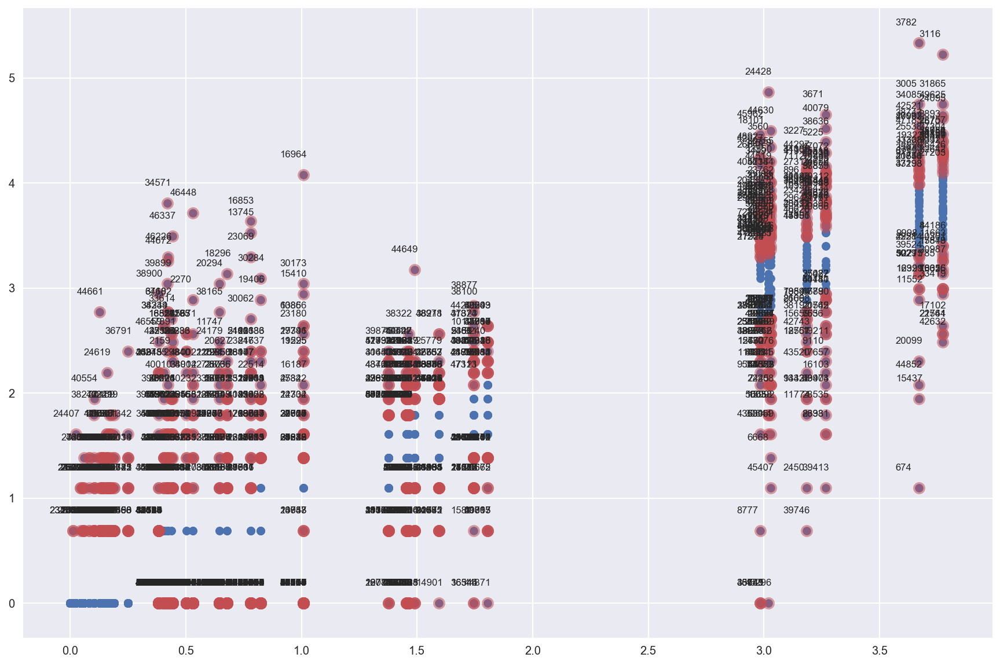

In [18]:
item_nbr_list_1 = get_item_nbr(df_1) #1번 store에서 팔린 item_nbr만 list로 저장

influence1 = result_model1.get_influence()

cooks_d2_1, pvals1 = influence1.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr1 = 4 / (len(df_1) - 778)
idx1 = np.where(cooks_d2_1 > fox_cr1)[0]

print(len(idx1)) #outlier 갯수

X1 = result_model1.predict(df_1)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X1, df_1['log_units'])
plt.scatter(X1[idx1], df_1.loc[idx1]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx1)), idx1, list(zip(X1[idx1], df_1.loc[idx1]['log_units'])),
                    [(-20, 15)] * len(idx1), size = "small", ax = ax)

plt.show()

In [19]:
for num in idx1 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_1 :
        if item_nbr == df_1.loc[num].item_nbr :
            mean = df_1[df_1['item_nbr'] == item_nbr]['log_units'].mean()
            df_1.set_value(num, 'log_units', mean)
            df_1.set_value(num, 'units', np.exp(mean) - 1)

model1_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_1)
result_model1_new = model1_new.fit()
print(result_model1_new.summary())

test_1_new = processed_test[processed_test['store_nbr'] == 1]

test_1_new['log_units'] = result_model1_new.predict(test_1_new)
test_1_new['units'] = np.exp(test_1_new['log_units']) - 1
result_test2.append(test_1_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.995
Model:                            OLS   Adj. R-squared:                  0.995
Method:                 Least Squares   F-statistic:                 1.219e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:38:27   Log-Likelihood:             1.1342e+05
No. Observations:               50505   AIC:                        -2.253e+05
Df Residuals:                   49728   BIC:                        -2.184e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [20]:
del X1, cooks_d2_1, cv1_1, cv1_2, cv1_3, cv1_4, cv1_5, cv1_test, cv1_train, df_1, fox_cr1, idx1, influence1, item_nbr_list_1, model1
del model1_new, model_cv1, pvals1, result_model1, result_model1_new, result_model_cv1, test_1, test_1_new 

In [21]:
df_2 = processed_train[processed_train['store_nbr'] == 2].reset_index(drop = True)

model2 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_2)
result_model2 = model2.fit()
print(result_model2.summary())

test_2 = processed_test[processed_test['store_nbr'] == 2]

test_2['log_units'] = result_model2.predict(test_2)
test_2['units'] = np.exp(test_2['log_units']) - 1
result_test.append(test_2)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.968
Model:                            OLS   Adj. R-squared:                  0.968
Method:                 Least Squares   F-statistic:                     1947.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:38:42   Log-Likelihood:                 40354.
No. Observations:               50505   AIC:                        -7.915e+04
Df Residuals:                   49728   BIC:                        -7.229e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [22]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv2_1 = df_2[:10101]
cv2_2 = df_2[10101:20202]
cv2_3 = df_2[20202:30414]
cv2_4 = df_2[30414:40515]
cv2_5 = df_2[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv2_train = pd.concat([cv2_1, cv2_2, cv2_3, cv2_4], ignore_index = True)
cv2_test = cv2_5

model_cv2 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv2_train)
result_model_cv2 = model_cv2.fit()
print(result_model_cv2.summary())

cv2_test['log_units_cv'] = result_model_cv2.predict(cv2_test)
cv2_test['units_cv'] = np.exp(cv2_test['log_units_cv']) - 1

cv2_test['RMSLE'] = np.log((cv2_test['units_cv'] + 1) / (cv2_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv2_test['RMSLE']) / len(cv2_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.968
Model:                            OLS   Adj. R-squared:                  0.967
Method:                 Least Squares   F-statistic:                     1534.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:38:53   Log-Likelihood:                 31884.
No. Observations:               40515   AIC:                        -6.221e+04
Df Residuals:                   39738   BIC:                        -5.552e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.105727411947


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1378


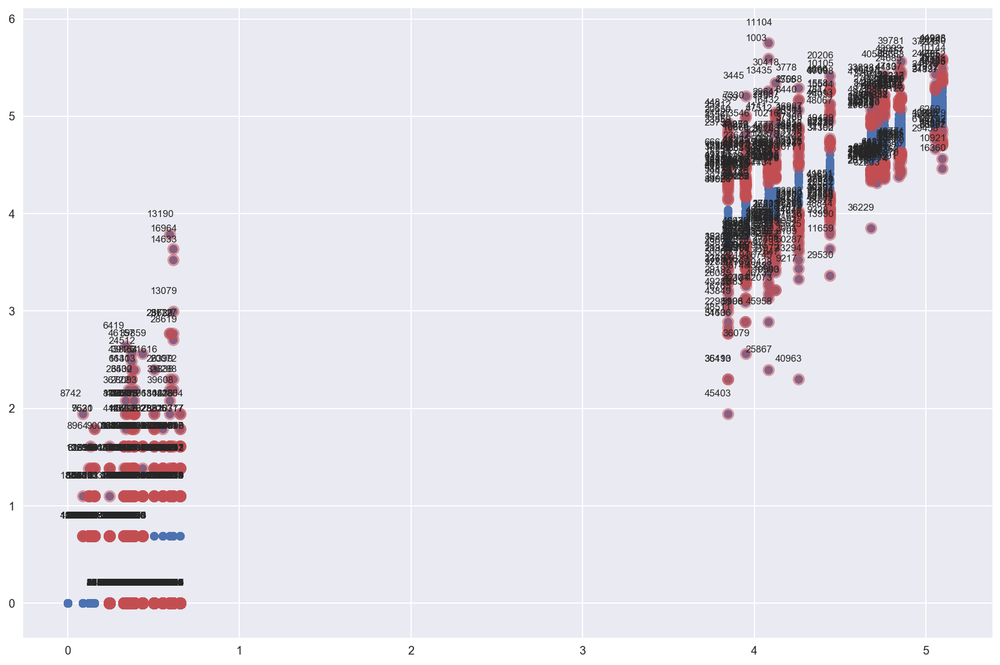

In [23]:
item_nbr_list_2 = get_item_nbr(df_2) #2번 store에서 팔린 item_nbr만 list로 저장

influence2 = result_model2.get_influence()

cooks_d2_2, pvals2 = influence2.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr2 = 4 / (len(df_2) - 778)
idx2 = np.where(cooks_d2_2 > fox_cr2)[0]

print(len(idx2)) #outlier 갯수

X2 = result_model2.predict(df_2)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X2, df_2['log_units'])
plt.scatter(X2[idx2], df_2.loc[idx2]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx2)), idx2, list(zip(X2[idx2], df_2.loc[idx2]['log_units'])),
                    [(-20, 15)] * len(idx2), size = "small", ax = ax)

plt.show()

In [24]:
for num in idx2 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_2 :
        if item_nbr == df_2.loc[num].item_nbr :
            mean = df_2[df_2['item_nbr'] == item_nbr]['log_units'].mean()
            df_2.set_value(num, 'log_units', mean)
            df_2.set_value(num, 'units', np.exp(mean) - 1)

model2_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_2)
result_model2_new = model2_new.fit()
print(result_model2_new.summary())

test_2_new = processed_test[processed_test['store_nbr'] == 2]

test_2_new['log_units'] = result_model2_new.predict(test_2_new)
test_2_new['units'] = np.exp(test_2_new['log_units']) - 1
result_test2.append(test_2_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 7.944e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:39:14   Log-Likelihood:             1.3421e+05
No. Observations:               50505   AIC:                        -2.669e+05
Df Residuals:                   49728   BIC:                        -2.600e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [25]:
del X2, cooks_d2_2, cv2_1, cv2_2, cv2_3, cv2_4, cv2_5, cv2_test, cv2_train, df_2, fox_cr2, idx2, influence2, item_nbr_list_2, model2
del model2_new, model_cv2, pvals2, result_model2, result_model2_new, result_model_cv2, test_2, test_2_new

In [26]:
df_3 = processed_train[processed_train['store_nbr'] == 3].reset_index(drop = True)

model3 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_3)
result_model3 = model3.fit()
print(result_model3.summary())

test_3 = processed_test[processed_test['store_nbr'] == 3]

test_3['log_units'] = result_model3.predict(test_3)
test_3['units'] = np.exp(test_3['log_units']) - 1
result_test.append(test_3)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.953
Model:                            OLS   Adj. R-squared:                  0.953
Method:                 Least Squares   F-statistic:                     1310.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:39:29   Log-Likelihood:                 33270.
No. Observations:               50505   AIC:                        -6.499e+04
Df Residuals:                   49728   BIC:                        -5.813e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [27]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv3_1 = df_3[:10101]
cv3_2 = df_3[10101:20202]
cv3_3 = df_3[20202:30414]
cv3_4 = df_3[30414:40515]
cv3_5 = df_3[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv3_train = pd.concat([cv3_1, cv3_2, cv3_3, cv3_4], ignore_index = True)
cv3_test = cv3_5

model_cv3 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv3_train)
result_model_cv3 = model_cv3.fit()
print(result_model_cv3.summary())

cv3_test['log_units_cv'] = result_model_cv3.predict(cv3_test)
cv3_test['units_cv'] = np.exp(cv3_test['log_units_cv']) - 1

cv3_test['RMSLE'] = np.log((cv3_test['units_cv'] + 1) / (cv3_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv3_test['RMSLE']) / len(cv3_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.957
Model:                            OLS   Adj. R-squared:                  0.956
Method:                 Least Squares   F-statistic:                     1145.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:39:40   Log-Likelihood:                 28150.
No. Observations:               40515   AIC:                        -5.475e+04
Df Residuals:                   39738   BIC:                        -4.806e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.144603030423


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1254


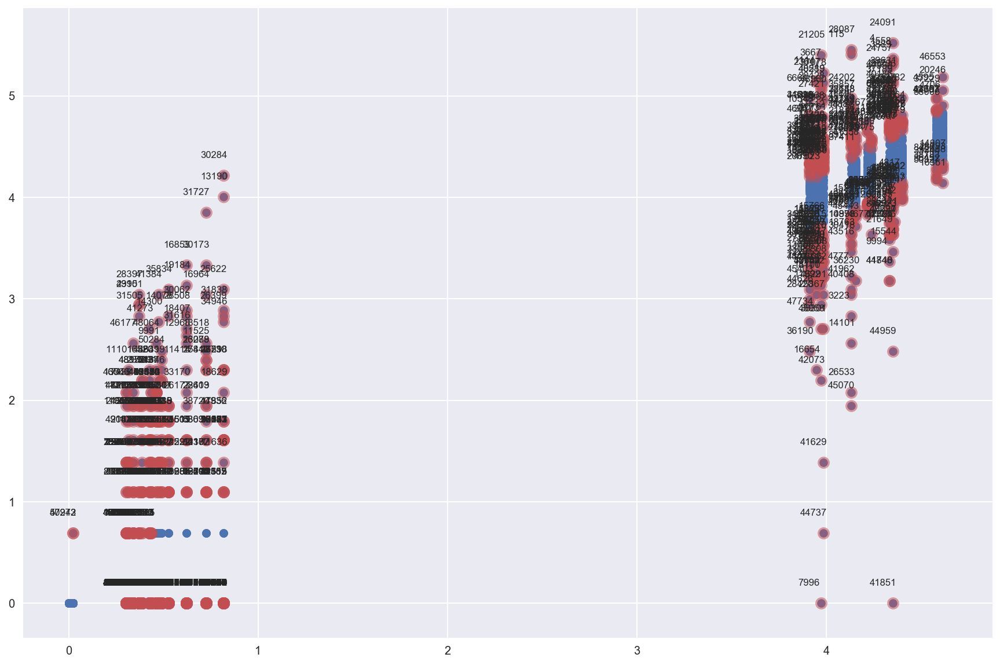

In [28]:
item_nbr_list_3 = get_item_nbr(df_3) #3번 store에서 팔린 item_nbr만 list로 저장

influence3 = result_model3.get_influence()

cooks_d2_3, pvals3 = influence3.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr3 = 4 / (len(df_3) - 778)
idx3 = np.where(cooks_d2_3 > fox_cr3)[0]

print(len(idx3)) #outlier 갯수

X3 = result_model3.predict(df_3)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X3, df_3['log_units'])
plt.scatter(X3[idx3], df_3.loc[idx3]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx3)), idx3, list(zip(X3[idx3], df_3.loc[idx3]['log_units'])),
                    [(-20, 15)] * len(idx3), size = "small", ax = ax)

plt.show()

In [29]:
for num in idx3 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_3 :
        if item_nbr == df_3.loc[num].item_nbr :
            mean = df_3[df_3['item_nbr'] == item_nbr]['log_units'].mean()
            df_3.set_value(num, 'log_units', mean)
            df_3.set_value(num, 'units', np.exp(mean) - 1)

model3_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_3)
result_model3_new = model3_new.fit()
print(result_model3_new.summary())

test_3_new = processed_test[processed_test['store_nbr'] == 3]

test_3_new['log_units'] = result_model3_new.predict(test_3_new)
test_3_new['units'] = np.exp(test_3_new['log_units']) - 1
result_test2.append(test_3_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 6.360e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:40:01   Log-Likelihood:             1.3137e+05
No. Observations:               50505   AIC:                        -2.612e+05
Df Residuals:                   49728   BIC:                        -2.543e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [30]:
del X3, cooks_d2_3, cv3_1, cv3_2, cv3_3, cv3_4, cv3_5, cv3_test, cv3_train, df_3, fox_cr3, idx3, influence3, item_nbr_list_3, model3
del model3_new, model_cv3, pvals3, result_model3, result_model3_new, result_model_cv3, test_3, test_3_new

In [31]:
df_4 = processed_train[processed_train['store_nbr'] == 4].reset_index(drop = True)

model4 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_4)
result_model4 = model4.fit()
print(result_model4.summary())

test_4 = processed_test[processed_test['store_nbr'] == 4]

test_4['log_units'] = result_model4.predict(test_4)
test_4['units'] = np.exp(test_4['log_units']) - 1
result_test.append(test_4)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.932
Model:                            OLS   Adj. R-squared:                  0.931
Method:                 Least Squares   F-statistic:                     873.5
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:40:17   Log-Likelihood:                 30956.
No. Observations:               50505   AIC:                        -6.036e+04
Df Residuals:                   49728   BIC:                        -5.350e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [32]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv4_1 = df_4[:10101]
cv4_2 = df_4[10101:20202]
cv4_3 = df_4[20202:30414]
cv4_4 = df_4[30414:40515]
cv4_5 = df_4[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv4_train = pd.concat([cv4_1, cv4_2, cv4_3, cv4_4], ignore_index = True)
cv4_test = cv4_5

model_cv4 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv4_train)
result_model_cv4 = model_cv4.fit()
print(result_model_cv4.summary())

cv4_test['log_units_cv'] = result_model_cv4.predict(cv4_test)
cv4_test['units_cv'] = np.exp(cv4_test['log_units_cv']) - 1

cv4_test['RMSLE'] = np.log((cv4_test['units_cv'] + 1) / (cv4_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv4_test['RMSLE']) / len(cv4_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.939
Model:                            OLS   Adj. R-squared:                  0.938
Method:                 Least Squares   F-statistic:                     791.8
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:40:29   Log-Likelihood:                 27789.
No. Observations:               40515   AIC:                        -5.402e+04
Df Residuals:                   39738   BIC:                        -4.733e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.168099164156


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1425


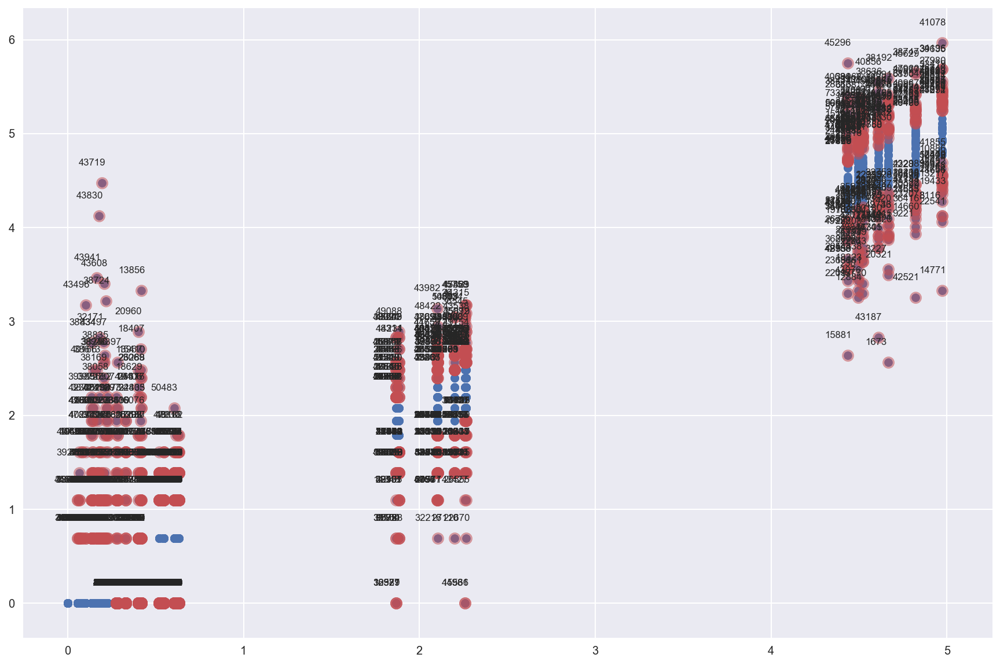

In [33]:
item_nbr_list_4 = get_item_nbr(df_4) #4번 store에서 팔린 item_nbr만 list로 저장

influence4 = result_model4.get_influence()

cooks_d2_4, pvals4 = influence4.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr4 = 4 / (len(df_4) - 778)
idx4 = np.where(cooks_d2_4 > fox_cr4)[0]

print(len(idx4)) #outlier 갯수

X4 = result_model4.predict(df_4)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X4, df_4['log_units'])
plt.scatter(X4[idx4], df_4.loc[idx4]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx4)), idx4, list(zip(X4[idx4], df_4.loc[idx4]['log_units'])),
                    [(-20, 15)] * len(idx4), size = "small", ax = ax)

plt.show()

In [34]:
for num in idx4 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_4 :
        if item_nbr == df_4.loc[num].item_nbr :
            mean = df_4[df_4['item_nbr'] == item_nbr]['log_units'].mean()
            df_4.set_value(num, 'log_units', mean)
            df_4.set_value(num, 'units', np.exp(mean) - 1)

model4_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_4)
result_model4_new = model4_new.fit()
print(result_model4_new.summary())

test_4_new = processed_test[processed_test['store_nbr'] == 4]

test_4_new['log_units'] = result_model4_new.predict(test_4_new)
test_4_new['units'] = np.exp(test_4_new['log_units']) - 1
result_test2.append(test_4_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 3.880e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:40:51   Log-Likelihood:             1.2641e+05
No. Observations:               50505   AIC:                        -2.513e+05
Df Residuals:                   49728   BIC:                        -2.444e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [35]:
del X4, cooks_d2_4, cv4_1, cv4_2, cv4_3, cv4_4, cv4_5, cv4_test, cv4_train, df_4, fox_cr4, idx4, influence4, item_nbr_list_4, model4
del model4_new, model_cv4, pvals4, result_model4, result_model4_new, result_model_cv4, test_4, test_4_new

In [36]:
df_5 = processed_train[processed_train['store_nbr'] == 5].reset_index(drop = True)

model5 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_5)
result_model5 = model5.fit()
print(result_model5.summary())

test_5 = processed_test[processed_test['store_nbr'] == 5]

test_5['log_units'] = result_model5.predict(test_5)
test_5['units'] = np.exp(test_5['log_units']) - 1
result_test.append(test_5)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.907
Model:                            OLS   Adj. R-squared:                  0.906
Method:                 Least Squares   F-statistic:                     624.8
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:41:06   Log-Likelihood:                 33353.
No. Observations:               50505   AIC:                        -6.515e+04
Df Residuals:                   49728   BIC:                        -5.829e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [37]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv5_1 = df_5[:10101]
cv5_2 = df_5[10101:20202]
cv5_3 = df_5[20202:30414]
cv5_4 = df_5[30414:40515]
cv5_5 = df_5[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv5_train = pd.concat([cv5_1, cv5_2, cv5_3, cv5_4], ignore_index = True)
cv5_test = cv5_5

model_cv5 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv5_train)
result_model_cv5 = model_cv5.fit()
print(result_model_cv5.summary())

cv5_test['log_units_cv'] = result_model_cv5.predict(cv5_test)
cv5_test['units_cv'] = np.exp(cv5_test['log_units_cv']) - 1

cv5_test['RMSLE'] = np.log((cv5_test['units_cv'] + 1) / (cv5_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv5_test['RMSLE']) / len(cv5_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.904
Model:                            OLS   Adj. R-squared:                  0.902
Method:                 Least Squares   F-statistic:                     481.1
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:41:18   Log-Likelihood:                 25897.
No. Observations:               40515   AIC:                        -5.024e+04
Df Residuals:                   39738   BIC:                        -4.355e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.11725514548


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1566


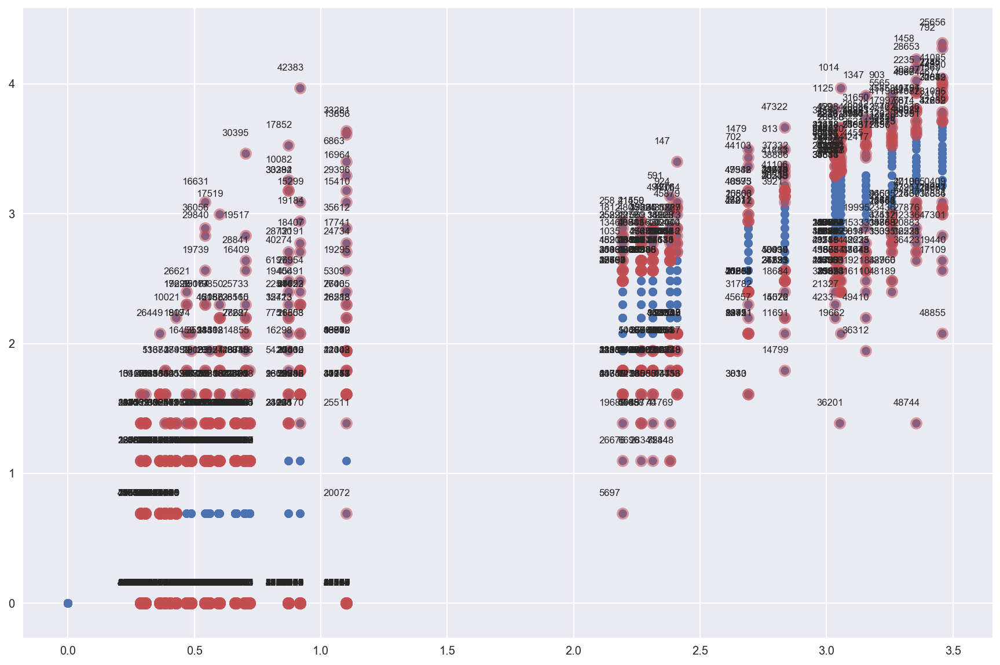

In [38]:
item_nbr_list_5 = get_item_nbr(df_5) #5번 store에서 팔린 item_nbr만 list로 저장

influence5 = result_model5.get_influence()

cooks_d2_5, pvals5 = influence5.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr5 = 4 / (len(df_5) - 778)
idx5 = np.where(cooks_d2_5 > fox_cr5)[0]

print(len(idx5)) #outlier 갯수

X5 = result_model5.predict(df_5)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X5, df_5['log_units'])
plt.scatter(X5[idx5], df_5.loc[idx5]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx5)), idx5, list(zip(X5[idx5], df_5.loc[idx5]['log_units'])),
                    [(-20, 15)] * len(idx5), size = "small", ax = ax)

plt.show()

In [39]:
for num in idx5 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_5 :
        if item_nbr == df_5.loc[num].item_nbr :
            mean = df_5[df_5['item_nbr'] == item_nbr]['log_units'].mean()
            df_5.set_value(num, 'log_units', mean)
            df_5.set_value(num, 'units', np.exp(mean) - 1)

model5_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_5)
result_model5_new = model5_new.fit()
print(result_model5_new.summary())

test_5_new = processed_test[processed_test['store_nbr'] == 5]

test_5_new['log_units'] = result_model5_new.predict(test_5_new)
test_5_new['units'] = np.exp(test_5_new['log_units']) - 1
result_test2.append(test_5_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                 2.343e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:41:41   Log-Likelihood:             1.2471e+05
No. Observations:               50505   AIC:                        -2.479e+05
Df Residuals:                   49728   BIC:                        -2.410e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [40]:
del X5, cooks_d2_5, cv5_1, cv5_2, cv5_3, cv5_4, cv5_5, cv5_test, cv5_train, df_5, fox_cr5, idx5, influence5, item_nbr_list_5, model5
del model5_new, model_cv5, pvals5, result_model5, result_model5_new, result_model_cv5, test_5, test_5_new

In [41]:
df_6 = processed_train[processed_train['store_nbr'] == 6].reset_index(drop = True)

model6 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_6)
result_model6 = model6.fit()
print(result_model6.summary())

test_6 = processed_test[processed_test['store_nbr'] == 6]

test_6['log_units'] = result_model6.predict(test_6)
test_6['units'] = np.exp(test_6['log_units']) - 1
result_test.append(test_6)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.982
Model:                            OLS   Adj. R-squared:                  0.982
Method:                 Least Squares   F-statistic:                     3561.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:41:56   Log-Likelihood:                 61644.
No. Observations:               50505   AIC:                        -1.217e+05
Df Residuals:                   49728   BIC:                        -1.149e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [42]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv6_1 = df_6[:10101]
cv6_2 = df_6[10101:20202]
cv6_3 = df_6[20202:30414]
cv6_4 = df_6[30414:40515]
cv6_5 = df_6[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv6_train = pd.concat([cv6_1, cv6_2, cv6_3, cv6_4], ignore_index = True)
cv6_test = cv6_5

model_cv6 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv6_train)
result_model_cv6 = model_cv6.fit()
print(result_model_cv6.summary())

cv6_test['log_units_cv'] = result_model_cv6.predict(cv6_test)
cv6_test['units_cv'] = np.exp(cv6_test['log_units_cv']) - 1

cv6_test['RMSLE'] = np.log((cv6_test['units_cv'] + 1) / (cv6_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv6_test['RMSLE']) / len(cv6_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.982
Model:                            OLS   Adj. R-squared:                  0.982
Method:                 Least Squares   F-statistic:                     2773.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:42:08   Log-Likelihood:                 49183.
No. Observations:               40515   AIC:                        -9.681e+04
Df Residuals:                   39738   BIC:                        -9.012e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.0704247924526


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1031


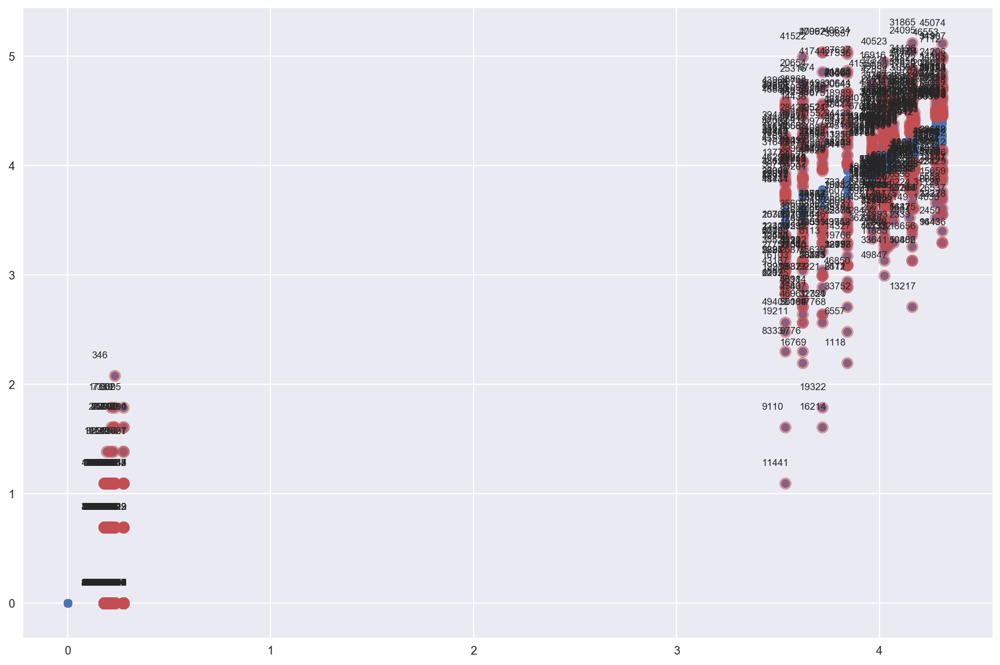

In [43]:
item_nbr_list_6 = get_item_nbr(df_6) #6번 store에서 팔린 item_nbr만 list로 저장

influence6 = result_model6.get_influence()

cooks_d2_6, pvals6 = influence6.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr6 = 4 / (len(df_6) - 778)
idx6 = np.where(cooks_d2_6 > fox_cr6)[0]

print(len(idx6)) #outlier 갯수

X6 = result_model6.predict(df_6)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X6, df_6['log_units'])
plt.scatter(X6[idx6], df_6.loc[idx6]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx6)), idx6, list(zip(X6[idx6], df_6.loc[idx6]['log_units'])),
                    [(-20, 15)] * len(idx6), size = "small", ax = ax)

plt.show()

In [44]:
for num in idx6 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_6 :
        if item_nbr == df_6.loc[num].item_nbr :
            mean = df_6[df_6['item_nbr'] == item_nbr]['log_units'].mean()
            df_6.set_value(num, 'log_units', mean)
            df_6.set_value(num, 'units', np.exp(mean) - 1)

model6_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_6)
result_model6_new = model6_new.fit()
print(result_model6_new.summary())

test_6_new = processed_test[processed_test['store_nbr'] == 6]

test_6_new['log_units'] = result_model6_new.predict(test_6_new)
test_6_new['units'] = np.exp(test_6_new['log_units']) - 1
result_test2.append(test_6_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 1.027e+05
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:42:29   Log-Likelihood:             1.4613e+05
No. Observations:               50505   AIC:                        -2.907e+05
Df Residuals:                   49728   BIC:                        -2.838e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [45]:
del X6, cooks_d2_6, cv6_1, cv6_2, cv6_3, cv6_4, cv6_5, cv6_test, cv6_train, df_6, fox_cr6, idx6, influence6, item_nbr_list_6, model6
del model6_new, model_cv6, pvals6, result_model6, result_model6_new, result_model_cv6, test_6, test_6_new

In [46]:
df_7 = processed_train[processed_train['store_nbr'] == 7].reset_index(drop = True)

model7 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_7)
result_model7 = model7.fit()
print(result_model7.summary())

test_7 = processed_test[processed_test['store_nbr'] == 7]

test_7['log_units'] = result_model7.predict(test_7)
test_7['units'] = np.exp(test_7['log_units']) - 1
result_test.append(test_7)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.955
Model:                            OLS   Adj. R-squared:                  0.954
Method:                 Least Squares   F-statistic:                     1360.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:42:44   Log-Likelihood:                 40068.
No. Observations:               50505   AIC:                        -7.858e+04
Df Residuals:                   49728   BIC:                        -7.172e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [47]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv7_1 = df_7[:10101]
cv7_2 = df_7[10101:20202]
cv7_3 = df_7[20202:30414]
cv7_4 = df_7[30414:40515]
cv7_5 = df_7[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv7_train = pd.concat([cv7_1, cv7_2, cv7_3, cv7_4], ignore_index = True)
cv7_test = cv7_5

model_cv7 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv7_train)
result_model_cv7 = model_cv7.fit()
print(result_model_cv7.summary())

cv7_test['log_units_cv'] = result_model_cv7.predict(cv7_test)
cv7_test['units_cv'] = np.exp(cv7_test['log_units_cv']) - 1

cv7_test['RMSLE'] = np.log((cv7_test['units_cv'] + 1) / (cv7_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv7_test['RMSLE']) / len(cv7_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.954
Model:                            OLS   Adj. R-squared:                  0.953
Method:                 Least Squares   F-statistic:                     1063.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:42:55   Log-Likelihood:                 31386.
No. Observations:               40515   AIC:                        -6.122e+04
Df Residuals:                   39738   BIC:                        -5.453e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.102871209797


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1339


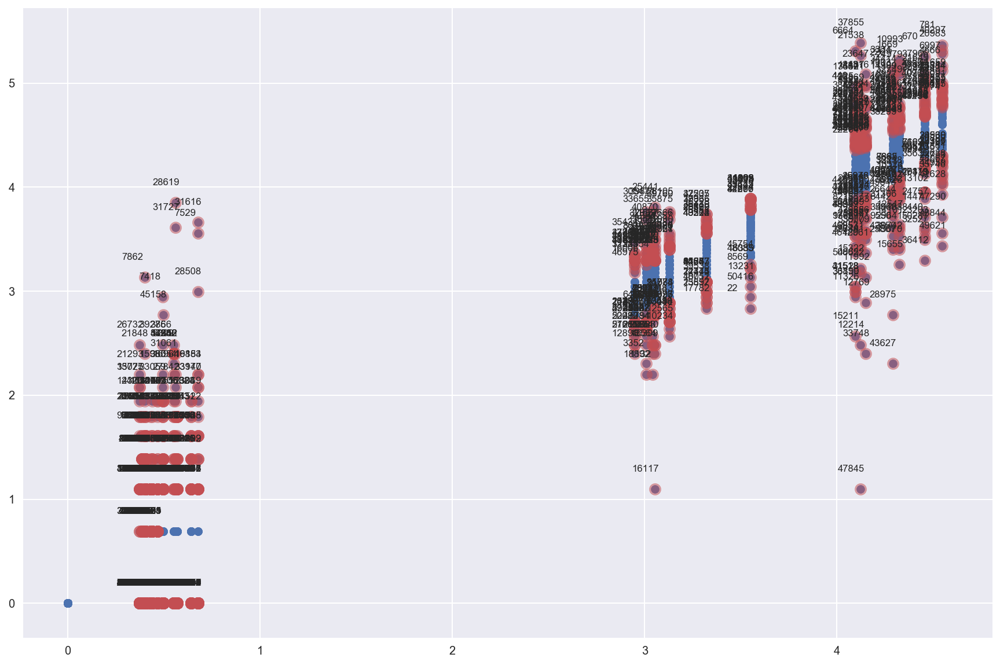

In [48]:
item_nbr_list_7 = get_item_nbr(df_7) #7번 store에서 팔린 item_nbr만 list로 저장

influence7 = result_model7.get_influence()

cooks_d2_7, pvals7 = influence7.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr7 = 4 / (len(df_7) - 778)
idx7 = np.where(cooks_d2_7 > fox_cr7)[0]

print(len(idx7)) #outlier 갯수

X7 = result_model7.predict(df_7)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X7, df_7['log_units'])
plt.scatter(X7[idx7], df_7.loc[idx7]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx7)), idx7, list(zip(X7[idx7], df_7.loc[idx7]['log_units'])),
                    [(-20, 15)] * len(idx7), size = "small", ax = ax)

plt.show()

In [49]:
for num in idx7 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_7 :
        if item_nbr == df_7.loc[num].item_nbr :
            mean = df_7[df_7['item_nbr'] == item_nbr]['log_units'].mean()
            df_7.set_value(num, 'log_units', mean)
            df_7.set_value(num, 'units', np.exp(mean) - 1)

model7_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_7)
result_model7_new = model7_new.fit()
print(result_model7_new.summary())

test_7_new = processed_test[processed_test['store_nbr'] == 7]

test_7_new['log_units'] = result_model7_new.predict(test_7_new)
test_7_new['units'] = np.exp(test_7_new['log_units']) - 1
result_test2.append(test_7_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 4.755e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:43:17   Log-Likelihood:             1.3005e+05
No. Observations:               50505   AIC:                        -2.585e+05
Df Residuals:                   49728   BIC:                        -2.517e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [50]:
del X7, cooks_d2_7, cv7_1, cv7_2, cv7_3, cv7_4, cv7_5, cv7_test, cv7_train, df_7, fox_cr7, idx7, influence7, item_nbr_list_7, model7
del model7_new, model_cv7, pvals7, result_model7, result_model7_new, result_model_cv7, test_7, test_7_new

In [51]:
df_8 = processed_train[processed_train['store_nbr'] == 8].reset_index(drop = True)

model8 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_8)
result_model8 = model8.fit()
print(result_model8.summary())

test_8 = processed_test[processed_test['store_nbr'] == 8]

test_8['log_units'] = result_model8.predict(test_8)
test_8['units'] = np.exp(test_8['log_units']) - 1
result_test.append(test_8)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.905
Model:                            OLS   Adj. R-squared:                  0.903
Method:                 Least Squares   F-statistic:                     609.1
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:43:33   Log-Likelihood:                 31321.
No. Observations:               50505   AIC:                        -6.109e+04
Df Residuals:                   49728   BIC:                        -5.423e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [52]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv8_1 = df_8[:10101]
cv8_2 = df_8[10101:20202]
cv8_3 = df_8[20202:30414]
cv8_4 = df_8[30414:40515]
cv8_5 = df_8[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv8_train = pd.concat([cv8_1, cv8_2, cv8_3, cv8_4], ignore_index = True)
cv8_test = cv8_5

model_cv8 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv8_train)
result_model_cv8 = model_cv8.fit()
print(result_model_cv8.summary())

cv8_test['log_units_cv'] = result_model_cv8.predict(cv8_test)
cv8_test['units_cv'] = np.exp(cv8_test['log_units_cv']) - 1

cv8_test['RMSLE'] = np.log((cv8_test['units_cv'] + 1) / (cv8_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv8_test['RMSLE']) / len(cv8_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.907
Model:                            OLS   Adj. R-squared:                  0.906
Method:                 Least Squares   F-statistic:                     502.0
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:43:44   Log-Likelihood:                 25433.
No. Observations:               40515   AIC:                        -4.931e+04
Df Residuals:                   39738   BIC:                        -4.262e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.137405082746


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1400


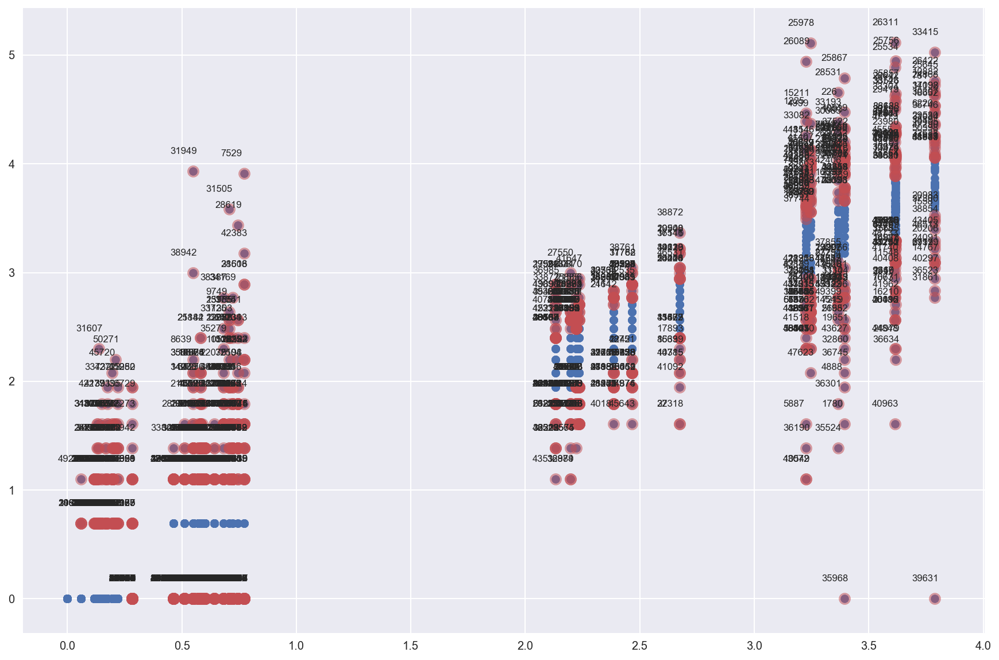

In [53]:
item_nbr_list_8 = get_item_nbr(df_8) #8번 store에서 팔린 item_nbr만 list로 저장

influence8 = result_model8.get_influence()

cooks_d2_8, pvals8 = influence8.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr8 = 4 / (len(df_8) - 778)
idx8 = np.where(cooks_d2_8 > fox_cr8)[0]

print(len(idx8)) #outlier 갯수

X8 = result_model8.predict(df_8)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X8, df_8['log_units'])
plt.scatter(X8[idx8], df_8.loc[idx8]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx8)), idx8, list(zip(X8[idx8], df_8.loc[idx8]['log_units'])),
                    [(-20, 15)] * len(idx8), size = "small", ax = ax)

plt.show()

In [54]:
for num in idx8 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_8 :
        if item_nbr == df_8.loc[num].item_nbr :
            mean = df_8[df_8['item_nbr'] == item_nbr]['log_units'].mean()
            df_8.set_value(num, 'log_units', mean)
            df_8.set_value(num, 'units', np.exp(mean) - 1)

model8_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_8)
result_model8_new = model8_new.fit()
print(result_model8_new.summary())

test_8_new = processed_test[processed_test['store_nbr'] == 8]

test_8_new['log_units'] = result_model8_new.predict(test_8_new)
test_8_new['units'] = np.exp(test_8_new['log_units']) - 1
result_test2.append(test_8_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 2.758e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:44:07   Log-Likelihood:             1.2734e+05
No. Observations:               50505   AIC:                        -2.531e+05
Df Residuals:                   49728   BIC:                        -2.463e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [55]:
del X8, cooks_d2_8, cv8_1, cv8_2, cv8_3, cv8_4, cv8_5, cv8_test, cv8_train, df_8, fox_cr8, idx8, influence8, item_nbr_list_8, model8
del model8_new, model_cv8, pvals8, result_model8, result_model8_new, result_model_cv8, test_8, test_8_new

In [56]:
df_9 = processed_train[processed_train['store_nbr'] == 9].reset_index(drop = True)

model9 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_9)
result_model9 = model9.fit()
print(result_model9.summary())

test_9 = processed_test[processed_test['store_nbr'] == 9]

test_9['log_units'] = result_model9.predict(test_9)
test_9['units'] = np.exp(test_9['log_units']) - 1
result_test.append(test_9)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.948
Model:                            OLS   Adj. R-squared:                  0.947
Method:                 Least Squares   F-statistic:                     1173.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:44:22   Log-Likelihood:                 29413.
No. Observations:               50505   AIC:                        -5.727e+04
Df Residuals:                   49728   BIC:                        -5.041e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [57]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv9_1 = df_9[:10101]
cv9_2 = df_9[10101:20202]
cv9_3 = df_9[20202:30414]
cv9_4 = df_9[30414:40515]
cv9_5 = df_9[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv9_train = pd.concat([cv9_1, cv9_2, cv9_3, cv9_4], ignore_index = True)
cv9_test = cv9_5

model_cv9 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv9_train)
result_model_cv9 = model_cv9.fit()
print(result_model_cv9.summary())

cv9_test['log_units_cv'] = result_model_cv9.predict(cv9_test)
cv9_test['units_cv'] = np.exp(cv9_test['log_units_cv']) - 1

cv9_test['RMSLE'] = np.log((cv9_test['units_cv'] + 1) / (cv9_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv9_test['RMSLE']) / len(cv9_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.945
Model:                            OLS   Adj. R-squared:                  0.944
Method:                 Least Squares   F-statistic:                     881.8
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:44:34   Log-Likelihood:                 22107.
No. Observations:               40515   AIC:                        -4.266e+04
Df Residuals:                   39738   BIC:                        -3.597e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.115634173051


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1455


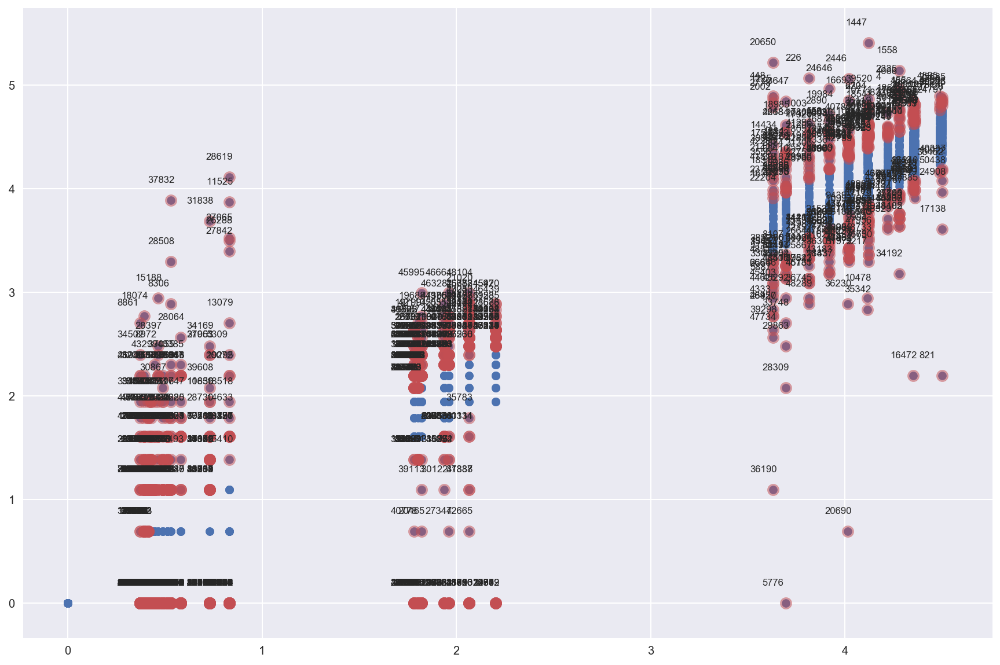

In [58]:
item_nbr_list_9 = get_item_nbr(df_9) #9번 store에서 팔린 item_nbr만 list로 저장

influence9 = result_model9.get_influence()

cooks_d2_9, pvals9 = influence9.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr9 = 4 / (len(df_9) - 778)
idx9 = np.where(cooks_d2_9 > fox_cr9)[0]

print(len(idx9)) #outlier 갯수

X9 = result_model9.predict(df_9)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X9, df_9['log_units'])
plt.scatter(X9[idx9], df_9.loc[idx9]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx9)), idx9, list(zip(X9[idx9], df_9.loc[idx9]['log_units'])),
                    [(-20, 15)] * len(idx9), size = "small", ax = ax)

plt.show()

In [59]:
for num in idx9 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_9 :
        if item_nbr == df_9.loc[num].item_nbr :
            mean = df_9[df_9['item_nbr'] == item_nbr]['log_units'].mean()
            df_9.set_value(num, 'log_units', mean)
            df_9.set_value(num, 'units', np.exp(mean) - 1)

model9_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_9)
result_model9_new = model9_new.fit()
print(result_model9_new.summary())

test_9_new = processed_test[processed_test['store_nbr'] == 9]

test_9_new['log_units'] = result_model9_new.predict(test_9_new)
test_9_new['units'] = np.exp(test_9_new['log_units']) - 1
result_test2.append(test_9_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 3.422e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:44:55   Log-Likelihood:             1.1446e+05
No. Observations:               50505   AIC:                        -2.274e+05
Df Residuals:                   49728   BIC:                        -2.205e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [60]:
del X9, cooks_d2_9, cv9_1, cv9_2, cv9_3, cv9_4, cv9_5, cv9_test, cv9_train, df_9, fox_cr9, idx9, influence9, item_nbr_list_9, model9
del model9_new, model_cv9, pvals9, result_model9, result_model9_new, result_model_cv9, test_9, test_9_new

In [61]:
df_10 = processed_train[processed_train['store_nbr'] == 10].reset_index(drop = True)

model10 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_10)
result_model10 = model10.fit()
print(result_model10.summary())

test_10 = processed_test[processed_test['store_nbr'] == 10]

test_10['log_units'] = result_model10.predict(test_10)
test_10['units'] = np.exp(test_10['log_units']) - 1
result_test.append(test_10)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.933
Model:                            OLS   Adj. R-squared:                  0.932
Method:                 Least Squares   F-statistic:                     897.0
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:45:11   Log-Likelihood:                 32651.
No. Observations:               50505   AIC:                        -6.375e+04
Df Residuals:                   49728   BIC:                        -5.689e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [62]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv10_1 = df_10[:10101]
cv10_2 = df_10[10101:20202]
cv10_3 = df_10[20202:30414]
cv10_4 = df_10[30414:40515]
cv10_5 = df_10[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv10_train = pd.concat([cv10_1, cv10_2, cv10_3, cv10_4], ignore_index = True)
cv10_test = cv10_5

model_cv10 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv10_train)
result_model_cv10 = model_cv10.fit()
print(result_model_cv10.summary())

cv10_test['log_units_cv'] = result_model_cv10.predict(cv10_test)
cv10_test['units_cv'] = np.exp(cv10_test['log_units_cv']) - 1

cv10_test['RMSLE'] = np.log((cv10_test['units_cv'] + 1) / (cv10_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv10_test['RMSLE']) / len(cv10_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.931
Model:                            OLS   Adj. R-squared:                  0.930
Method:                 Least Squares   F-statistic:                     695.3
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:45:24   Log-Likelihood:                 25880.
No. Observations:               40515   AIC:                        -5.021e+04
Df Residuals:                   39738   BIC:                        -4.352e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.127515582533


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1330


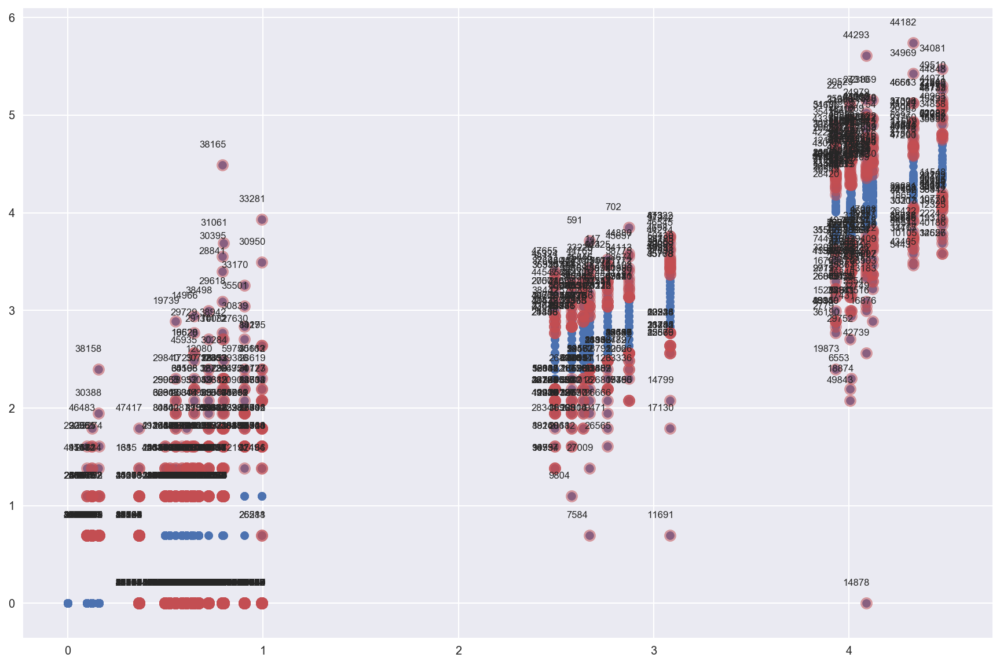

In [63]:
item_nbr_list_10 = get_item_nbr(df_10) #10번 store에서 팔린 item_nbr만 list로 저장

influence10 = result_model10.get_influence()

cooks_d2_10, pvals10 = influence10.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr10 = 4 / (len(df_10) - 778)
idx10 = np.where(cooks_d2_10 > fox_cr10)[0]

print(len(idx10)) #outlier 갯수

X10 = result_model10.predict(df_10)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X10, df_10['log_units'])
plt.scatter(X10[idx10], df_10.loc[idx10]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx10)), idx10, list(zip(X10[idx10], df_10.loc[idx10]['log_units'])),
                    [(-20, 15)] * len(idx10), size = "small", ax = ax)

plt.show()

In [64]:
for num in idx10 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_10 :
        if item_nbr == df_10.loc[num].item_nbr :
            mean = df_10[df_10['item_nbr'] == item_nbr]['log_units'].mean()
            df_10.set_value(num, 'log_units', mean)
            df_10.set_value(num, 'units', np.exp(mean) - 1)

model10_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_10)
result_model10_new = model10_new.fit()
print(result_model10_new.summary())

test_10_new = processed_test[processed_test['store_nbr'] == 10]

test_10_new['log_units'] = result_model10_new.predict(test_10_new)
test_10_new['units'] = np.exp(test_10_new['log_units']) - 1
result_test2.append(test_10_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 4.167e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:45:45   Log-Likelihood:             1.2920e+05
No. Observations:               50505   AIC:                        -2.568e+05
Df Residuals:                   49728   BIC:                        -2.500e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [65]:
del X10, cooks_d2_10, cv10_1, cv10_2, cv10_3, cv10_4, cv10_5, cv10_test, cv10_train, df_10, fox_cr10, idx10, influence10, item_nbr_list_10, model10
del model10_new, model_cv10, pvals10, result_model10, result_model10_new, result_model_cv10, test_10, test_10_new

In [66]:
df_11 = processed_train[processed_train['store_nbr'] == 11].reset_index(drop = True)

model11 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_11)
result_model11 = model11.fit()
print(result_model11.summary())

test_11 = processed_test[processed_test['store_nbr'] == 11]

test_11['log_units'] = result_model11.predict(test_11)
test_11['units'] = np.exp(test_11['log_units']) - 1
result_test.append(test_11)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.959
Model:                            OLS   Adj. R-squared:                  0.958
Method:                 Least Squares   F-statistic:                     1503.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:46:01   Log-Likelihood:                 43381.
No. Observations:               50505   AIC:                        -8.521e+04
Df Residuals:                   49728   BIC:                        -7.835e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [67]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv11_1 = df_11[:10101]
cv11_2 = df_11[10101:20202]
cv11_3 = df_11[20202:30414]
cv11_4 = df_11[30414:40515]
cv11_5 = df_11[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv11_train = pd.concat([cv11_1, cv11_2, cv11_3, cv11_4], ignore_index = True)
cv11_test = cv11_5

model_cv11 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv11_train)
result_model_cv11 = model_cv11.fit()
print(result_model_cv11.summary())

cv11_test['log_units_cv'] = result_model_cv11.predict(cv11_test)
cv11_test['units_cv'] = np.exp(cv11_test['log_units_cv']) - 1

cv11_test['RMSLE'] = np.log((cv11_test['units_cv'] + 1) / (cv11_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv11_test['RMSLE']) / len(cv11_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.961
Model:                            OLS   Adj. R-squared:                  0.961
Method:                 Least Squares   F-statistic:                     1277.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:46:13   Log-Likelihood:                 35996.
No. Observations:               40515   AIC:                        -7.044e+04
Df Residuals:                   39738   BIC:                        -6.375e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.117801913022


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1502


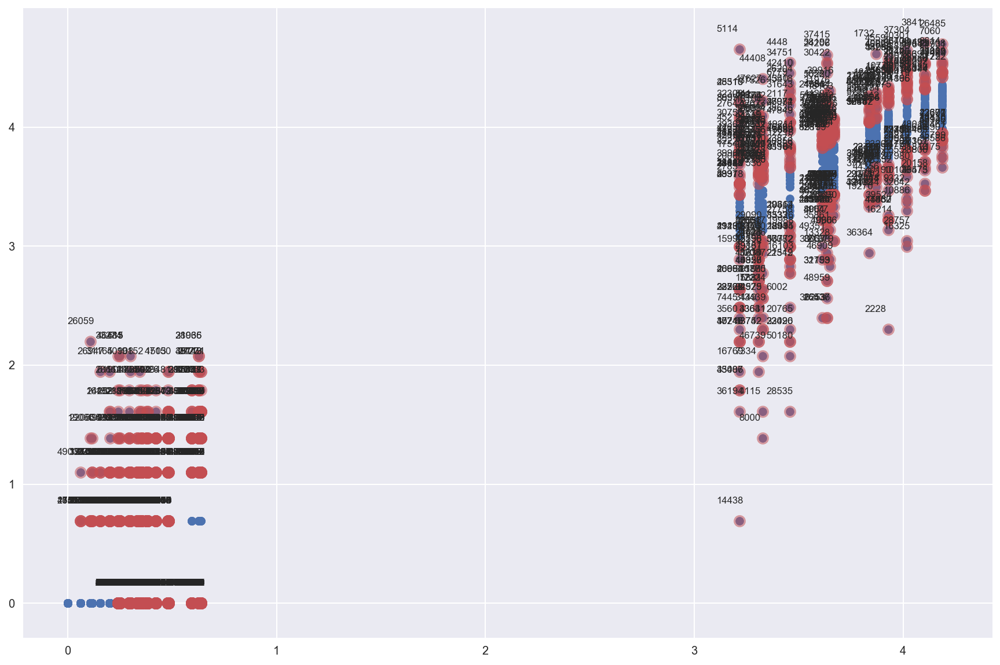

In [68]:
item_nbr_list_11 = get_item_nbr(df_11) #11번 store에서 팔린 item_nbr만 list로 저장

influence11 = result_model11.get_influence()

cooks_d2_11, pvals11 = influence11.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr11 = 4 / (len(df_11) - 778)
idx11 = np.where(cooks_d2_11 > fox_cr11)[0]

print(len(idx11)) #outlier 갯수

X11 = result_model11.predict(df_11)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X11, df_11['log_units'])
plt.scatter(X11[idx11], df_11.loc[idx11]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx11)), idx11, list(zip(X11[idx11], df_11.loc[idx11]['log_units'])),
                    [(-20, 15)] * len(idx11), size = "small", ax = ax)

plt.show()

In [69]:
for num in idx11 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_11 :
        if item_nbr == df_11.loc[num].item_nbr :
            mean = df_11[df_11['item_nbr'] == item_nbr]['log_units'].mean()
            df_11.set_value(num, 'log_units', mean)
            df_11.set_value(num, 'units', np.exp(mean) - 1)

model11_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_11)
result_model11_new = model11_new.fit()
print(result_model11_new.summary())

test_11_new = processed_test[processed_test['store_nbr'] == 11]

test_11_new['log_units'] = result_model11_new.predict(test_11_new)
test_11_new['units'] = np.exp(test_11_new['log_units']) - 1
result_test2.append(test_11_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 3.491e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:46:35   Log-Likelihood:             1.2244e+05
No. Observations:               50505   AIC:                        -2.433e+05
Df Residuals:                   49728   BIC:                        -2.365e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [70]:
del X11, cooks_d2_11, cv11_1, cv11_2, cv11_3, cv11_4, cv11_5, cv11_test, cv11_train, df_11, fox_cr11, idx11, influence11, item_nbr_list_11, model11
del model11_new, model_cv11, pvals11, result_model11, result_model11_new, result_model_cv11, test_11, test_11_new

In [71]:
df_12 = processed_train[processed_train['store_nbr'] == 12].reset_index(drop = True)

model12 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_12)
result_model12 = model12.fit()
print(result_model12.summary())

test_12 = processed_test[processed_test['store_nbr'] == 12]

test_12['log_units'] = result_model12.predict(test_12)
test_12['units'] = np.exp(test_12['log_units']) - 1
result_test.append(test_12)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.921
Model:                            OLS   Adj. R-squared:                  0.920
Method:                 Least Squares   F-statistic:                     747.8
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:46:51   Log-Likelihood:                 31991.
No. Observations:               50505   AIC:                        -6.243e+04
Df Residuals:                   49728   BIC:                        -5.557e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [72]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv12_1 = df_12[:10101]
cv12_2 = df_12[10101:20202]
cv12_3 = df_12[20202:30414]
cv12_4 = df_12[30414:40515]
cv12_5 = df_12[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv12_train = pd.concat([cv12_1, cv12_2, cv12_3, cv12_4], ignore_index = True)
cv12_test = cv12_5

model_cv12 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv12_train)
result_model_cv12 = model_cv12.fit()
print(result_model_cv12.summary())

cv12_test['log_units_cv'] = result_model_cv12.predict(cv12_test)
cv12_test['units_cv'] = np.exp(cv12_test['log_units_cv']) - 1

cv12_test['RMSLE'] = np.log((cv12_test['units_cv'] + 1) / (cv12_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv12_test['RMSLE']) / len(cv12_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.920
Model:                            OLS   Adj. R-squared:                  0.918
Method:                 Least Squares   F-statistic:                     586.5
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:47:02   Log-Likelihood:                 24995.
No. Observations:               40515   AIC:                        -4.844e+04
Df Residuals:                   39738   BIC:                        -4.175e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.122702691915


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1312


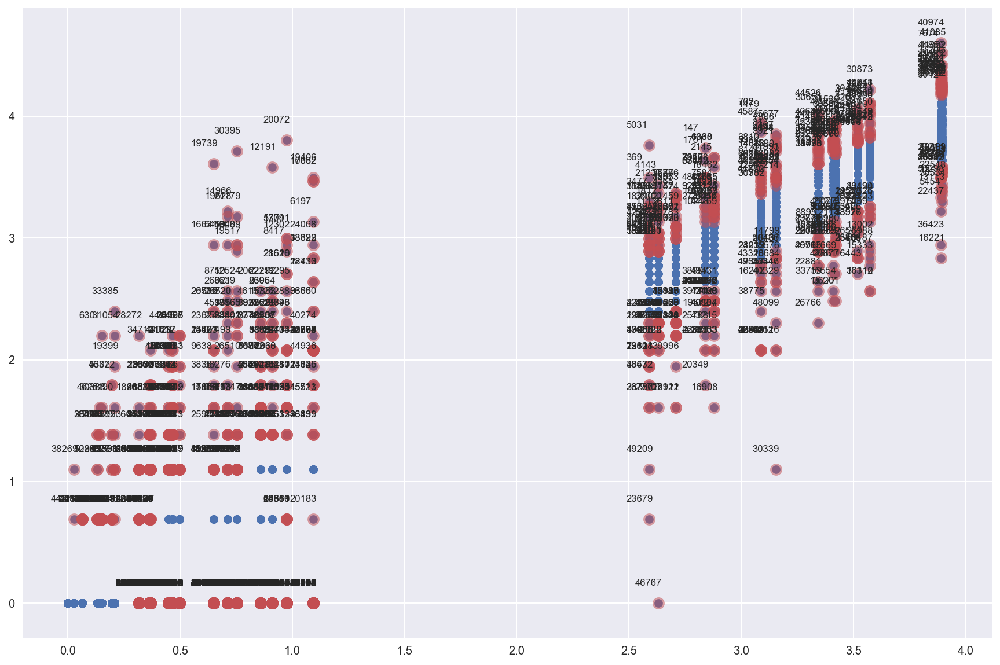

In [73]:
item_nbr_list_12 = get_item_nbr(df_12) #12번 store에서 팔린 item_nbr만 list로 저장

influence12 = result_model12.get_influence()

cooks_d2_12, pvals12 = influence12.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr12 = 4 / (len(df_12) - 778)
idx12 = np.where(cooks_d2_12 > fox_cr12)[0]

print(len(idx12)) #outlier 갯수

X12 = result_model12.predict(df_12)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X12, df_12['log_units'])
plt.scatter(X12[idx12], df_12.loc[idx12]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx12)), idx12, list(zip(X12[idx12], df_12.loc[idx12]['log_units'])),
                    [(-20, 15)] * len(idx12), size = "small", ax = ax)

plt.show()

In [74]:
for num in idx12 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_12 :
        if item_nbr == df_12.loc[num].item_nbr :
            mean = df_12[df_12['item_nbr'] == item_nbr]['log_units'].mean()
            df_12.set_value(num, 'log_units', mean)
            df_12.set_value(num, 'units', np.exp(mean) - 1)

model12_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_12)
result_model12_new = model12_new.fit()
print(result_model12_new.summary())

test_12_new = processed_test[processed_test['store_nbr'] == 12]

test_12_new['log_units'] = result_model12_new.predict(test_12_new)
test_12_new['units'] = np.exp(test_12_new['log_units']) - 1
result_test2.append(test_12_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                 2.475e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:47:24   Log-Likelihood:             1.2053e+05
No. Observations:               50505   AIC:                        -2.395e+05
Df Residuals:                   49728   BIC:                        -2.326e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [75]:
del X12, cooks_d2_12, cv12_1, cv12_2, cv12_3, cv12_4, cv12_5, cv12_test, cv12_train, df_12, fox_cr12, idx12, influence12, item_nbr_list_12, model12
del model12_new, model_cv12, pvals12, result_model12, result_model12_new, result_model_cv12, test_12, test_12_new

In [76]:
df_13 = processed_train[processed_train['store_nbr'] == 13].reset_index(drop = True)

model13 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_13)
result_model13 = model13.fit()
print(result_model13.summary())

test_13 = processed_test[processed_test['store_nbr'] == 13]

test_13['log_units'] = result_model13.predict(test_13)
test_13['units'] = np.exp(test_13['log_units']) - 1
result_test.append(test_13)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.963
Model:                            OLS   Adj. R-squared:                  0.963
Method:                 Least Squares   F-statistic:                     1691.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:47:40   Log-Likelihood:                 37130.
No. Observations:               50505   AIC:                        -7.271e+04
Df Residuals:                   49728   BIC:                        -6.584e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [77]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv13_1 = df_13[:10101]
cv13_2 = df_13[10101:20202]
cv13_3 = df_13[20202:30414]
cv13_4 = df_13[30414:40515]
cv13_5 = df_13[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv13_train = pd.concat([cv13_1, cv13_2, cv13_3, cv13_4], ignore_index = True)
cv13_test = cv13_5

model_cv13 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv13_train)
result_model_cv13 = model_cv13.fit()
print(result_model_cv13.summary())

cv13_test['log_units_cv'] = result_model_cv13.predict(cv13_test)
cv13_test['units_cv'] = np.exp(cv13_test['log_units_cv']) - 1

cv13_test['RMSLE'] = np.log((cv13_test['units_cv'] + 1) / (cv13_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv13_test['RMSLE']) / len(cv13_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.965
Model:                            OLS   Adj. R-squared:                  0.964
Method:                 Least Squares   F-statistic:                     1409.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:47:51   Log-Likelihood:                 30044.
No. Observations:               40515   AIC:                        -5.853e+04
Df Residuals:                   39738   BIC:                        -5.184e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.126748610764


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1169


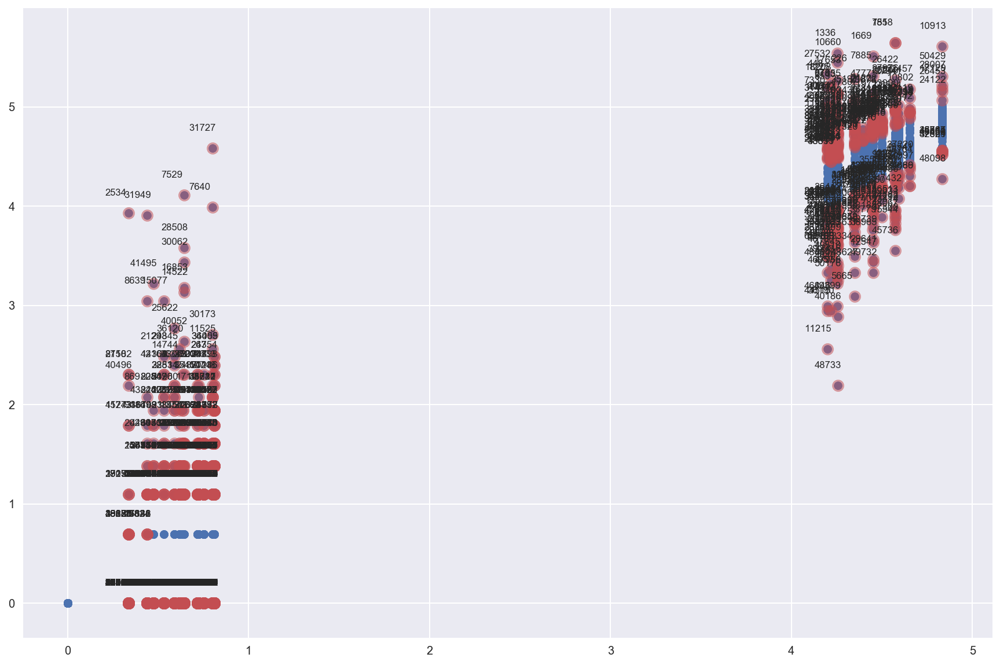

In [78]:
item_nbr_list_13 = get_item_nbr(df_13) #13번 store에서 팔린 item_nbr만 list로 저장

influence13 = result_model13.get_influence()

cooks_d2_13, pvals13 = influence13.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr13 = 4 / (len(df_13) - 778)
idx13 = np.where(cooks_d2_13 > fox_cr13)[0]

print(len(idx13)) #outlier 갯수

X13 = result_model13.predict(df_13)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X13, df_13['log_units'])
plt.scatter(X13[idx13], df_13.loc[idx13]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx13)), idx13, list(zip(X13[idx13], df_13.loc[idx13]['log_units'])),
                    [(-20, 15)] * len(idx13), size = "small", ax = ax)

plt.show()

In [79]:
for num in idx13 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_13 :
        if item_nbr == df_13.loc[num].item_nbr :
            mean = df_13[df_13['item_nbr'] == item_nbr]['log_units'].mean()
            df_13.set_value(num, 'log_units', mean)
            df_13.set_value(num, 'units', np.exp(mean) - 1)

model13_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_13)
result_model13_new = model13_new.fit()
print(result_model13_new.summary())

test_13_new = processed_test[processed_test['store_nbr'] == 13]

test_13_new['log_units'] = result_model13_new.predict(test_13_new)
test_13_new['units'] = np.exp(test_13_new['log_units']) - 1
result_test2.append(test_13_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 7.955e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:48:12   Log-Likelihood:             1.3469e+05
No. Observations:               50505   AIC:                        -2.678e+05
Df Residuals:                   49728   BIC:                        -2.610e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [80]:
del X13, cooks_d2_13, cv13_1, cv13_2, cv13_3, cv13_4, cv13_5, cv13_test, cv13_train, df_13, fox_cr13, idx13, influence13, item_nbr_list_13, model13
del model13_new, model_cv13, pvals13, result_model13, result_model13_new, result_model_cv13, test_13, test_13_new

In [81]:
df_14 = processed_train[processed_train['store_nbr'] == 14].reset_index(drop = True)

model14 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_14)
result_model14 = model14.fit()
print(result_model14.summary())

test_14 = processed_test[processed_test['store_nbr'] == 14]

test_14['log_units'] = result_model14.predict(test_14)
test_14['units'] = np.exp(test_14['log_units']) - 1
result_test.append(test_14)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.803
Model:                            OLS   Adj. R-squared:                  0.800
Method:                 Least Squares   F-statistic:                     260.7
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:48:28   Log-Likelihood:                 16729.
No. Observations:               50505   AIC:                        -3.190e+04
Df Residuals:                   49728   BIC:                        -2.504e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [82]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv14_1 = df_14[:10101]
cv14_2 = df_14[10101:20202]
cv14_3 = df_14[20202:30414]
cv14_4 = df_14[30414:40515]
cv14_5 = df_14[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv14_train = pd.concat([cv14_1, cv14_2, cv14_3, cv14_4], ignore_index = True)
cv14_test = cv14_5

model_cv14 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv14_train)
result_model_cv14 = model_cv14.fit()
print(result_model_cv14.summary())

cv14_test['log_units_cv'] = result_model_cv14.predict(cv14_test)
cv14_test['units_cv'] = np.exp(cv14_test['log_units_cv']) - 1

cv14_test['RMSLE'] = np.log((cv14_test['units_cv'] + 1) / (cv14_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv14_test['RMSLE']) / len(cv14_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.826
Model:                            OLS   Adj. R-squared:                  0.823
Method:                 Least Squares   F-statistic:                     243.6
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:48:39   Log-Likelihood:                 17820.
No. Observations:               40515   AIC:                        -3.409e+04
Df Residuals:                   39738   BIC:                        -2.740e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.242873790592


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1528


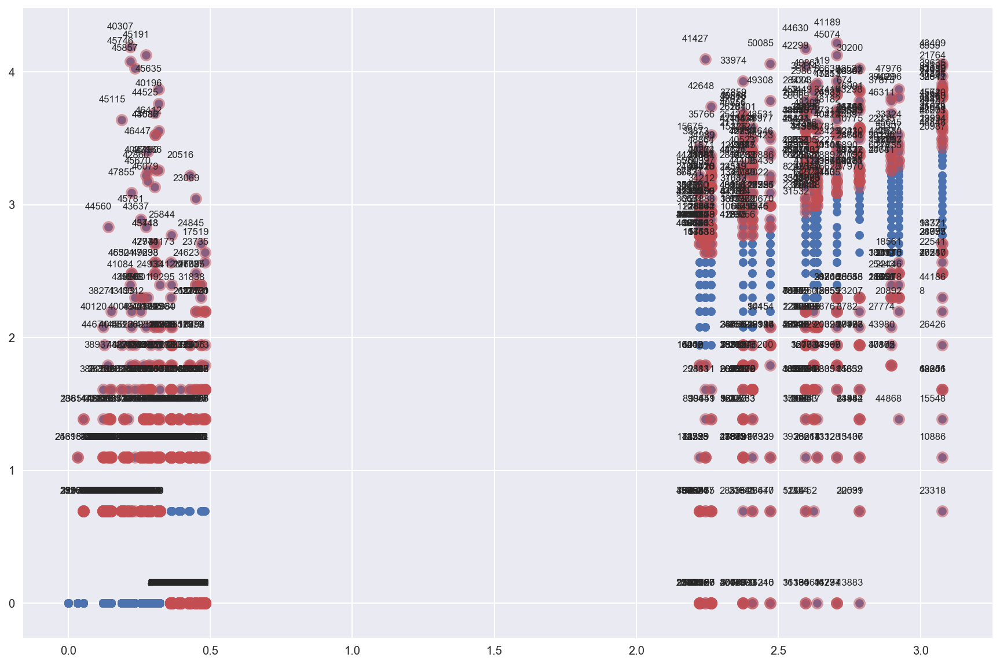

In [83]:
item_nbr_list_14 = get_item_nbr(df_14) #14번 store에서 팔린 item_nbr만 list로 저장

influence14 = result_model14.get_influence()

cooks_d2_14, pvals14 = influence14.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr14 = 4 / (len(df_14) - 778)
idx14 = np.where(cooks_d2_14 > fox_cr14)[0]

print(len(idx14)) #outlier 갯수

X14 = result_model14.predict(df_14)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X14, df_14['log_units'])
plt.scatter(X14[idx14], df_14.loc[idx14]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx14)), idx14, list(zip(X14[idx14], df_14.loc[idx14]['log_units'])),
                    [(-20, 15)] * len(idx14), size = "small", ax = ax)

plt.show()

In [84]:
for num in idx14 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_14 :
        if item_nbr == df_14.loc[num].item_nbr :
            mean = df_14[df_14['item_nbr'] == item_nbr]['log_units'].mean()
            df_14.set_value(num, 'log_units', mean)
            df_14.set_value(num, 'units', np.exp(mean) - 1)

model14_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_14)
result_model14_new = model14_new.fit()
print(result_model14_new.summary())

test_14_new = processed_test[processed_test['store_nbr'] == 14]

test_14_new['log_units'] = result_model14_new.predict(test_14_new)
test_14_new['units'] = np.exp(test_14_new['log_units']) - 1
result_test2.append(test_14_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.992
Model:                            OLS   Adj. R-squared:                  0.992
Method:                 Least Squares   F-statistic:                     7814.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:49:07   Log-Likelihood:             1.0164e+05
No. Observations:               50505   AIC:                        -2.017e+05
Df Residuals:                   49728   BIC:                        -1.949e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [85]:
del X14, cooks_d2_14, cv14_1, cv14_2, cv14_3, cv14_4, cv14_5, cv14_test, cv14_train, df_14, fox_cr14, idx14, influence14, item_nbr_list_14, model14
del model14_new, model_cv14, pvals14, result_model14, result_model14_new, result_model_cv14, test_14, test_14_new

In [86]:
df_15 = processed_train[processed_train['store_nbr'] == 15].reset_index(drop = True)

model15 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_15)
result_model15 = model15.fit()
print(result_model15.summary())

test_15 = processed_test[processed_test['store_nbr'] == 15]

test_15['log_units'] = result_model15.predict(test_15)
test_15['units'] = np.exp(test_15['log_units']) - 1
result_test.append(test_15)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.943
Model:                            OLS   Adj. R-squared:                  0.942
Method:                 Least Squares   F-statistic:                     1053.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:49:26   Log-Likelihood:                 25137.
No. Observations:               50505   AIC:                        -4.872e+04
Df Residuals:                   49728   BIC:                        -4.186e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [87]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv15_1 = df_15[:10101]
cv15_2 = df_15[10101:20202]
cv15_3 = df_15[20202:30414]
cv15_4 = df_15[30414:40515]
cv15_5 = df_15[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv15_train = pd.concat([cv15_1, cv15_2, cv15_3, cv15_4], ignore_index = True)
cv15_test = cv15_5

model_cv15 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv15_train)
result_model_cv15 = model_cv15.fit()
print(result_model_cv15.summary())

cv15_test['log_units_cv'] = result_model_cv15.predict(cv15_test)
cv15_test['units_cv'] = np.exp(cv15_test['log_units_cv']) - 1

cv15_test['RMSLE'] = np.log((cv15_test['units_cv'] + 1) / (cv15_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv15_test['RMSLE']) / len(cv15_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.945
Model:                            OLS   Adj. R-squared:                  0.944
Method:                 Least Squares   F-statistic:                     885.1
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:49:40   Log-Likelihood:                 20841.
No. Observations:               40515   AIC:                        -4.013e+04
Df Residuals:                   39738   BIC:                        -3.344e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.161709600674


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1772


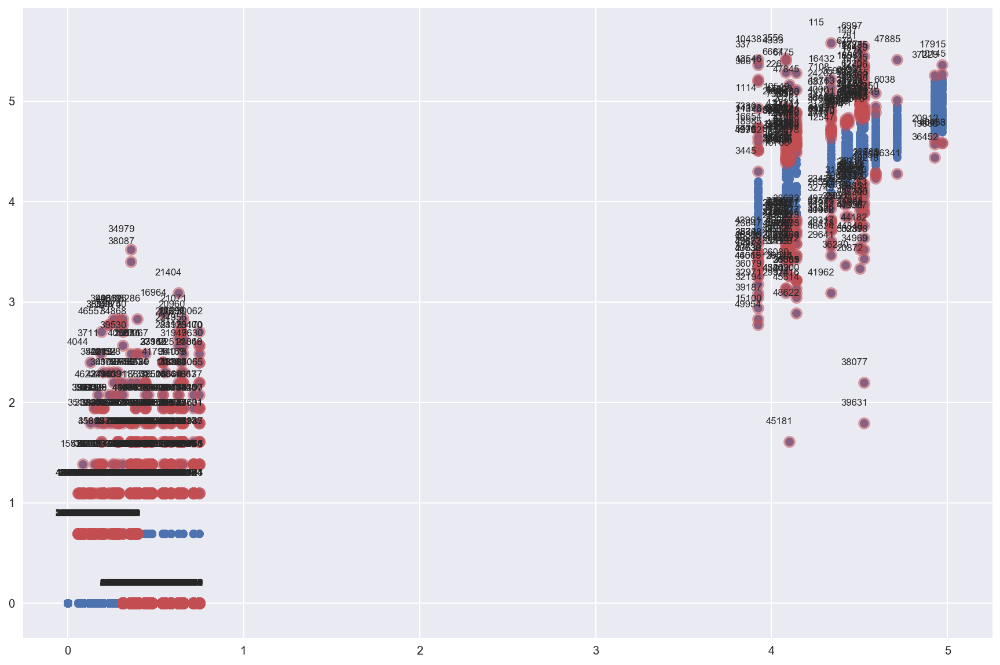

In [88]:
item_nbr_list_15 = get_item_nbr(df_15) #15번 store에서 팔린 item_nbr만 list로 저장

influence15 = result_model15.get_influence()

cooks_d2_15, pvals15 = influence15.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr15 = 4 / (len(df_15) - 778)
idx15 = np.where(cooks_d2_15 > fox_cr15)[0]

print(len(idx15)) #outlier 갯수

X15 = result_model15.predict(df_15)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X15, df_15['log_units'])
plt.scatter(X15[idx15], df_15.loc[idx15]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx15)), idx15, list(zip(X15[idx15], df_15.loc[idx15]['log_units'])),
                    [(-20, 15)] * len(idx15), size = "small", ax = ax)

plt.show()

In [89]:
for num in idx15 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_15 :
        if item_nbr == df_15.loc[num].item_nbr :
            mean = df_15[df_15['item_nbr'] == item_nbr]['log_units'].mean()
            df_15.set_value(num, 'log_units', mean)
            df_15.set_value(num, 'units', np.exp(mean) - 1)

model15_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_15)
result_model15_new = model15_new.fit()
print(result_model15_new.summary())

test_15_new = processed_test[processed_test['store_nbr'] == 15]

test_15_new['log_units'] = result_model15_new.predict(test_15_new)
test_15_new['units'] = np.exp(test_15_new['log_units']) - 1
result_test2.append(test_15_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 2.980e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:50:05   Log-Likelihood:             1.0992e+05
No. Observations:               50505   AIC:                        -2.183e+05
Df Residuals:                   49728   BIC:                        -2.114e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [90]:
del X15, cooks_d2_15, cv15_1, cv15_2, cv15_3, cv15_4, cv15_5, cv15_test, cv15_train, df_15, fox_cr15, idx15, influence15, item_nbr_list_15, model15
del model15_new, model_cv15, pvals15, result_model15, result_model15_new, result_model_cv15, test_15, test_15_new

In [91]:
df_16 = processed_train[processed_train['store_nbr'] == 16].reset_index(drop = True)

model16 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_16)
result_model16 = model16.fit()
print(result_model16.summary())

test_16 = processed_test[processed_test['store_nbr'] == 16]

test_16['log_units'] = result_model16.predict(test_16)
test_16['units'] = np.exp(test_16['log_units']) - 1
result_test.append(test_16)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.958
Model:                            OLS   Adj. R-squared:                  0.957
Method:                 Least Squares   F-statistic:                     1446.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:50:20   Log-Likelihood:                 33784.
No. Observations:               50505   AIC:                        -6.601e+04
Df Residuals:                   49728   BIC:                        -5.915e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [92]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv16_1 = df_16[:10101]
cv16_2 = df_16[10101:20202]
cv16_3 = df_16[20202:30414]
cv16_4 = df_16[30414:40515]
cv16_5 = df_16[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv16_train = pd.concat([cv16_1, cv16_2, cv16_3, cv16_4], ignore_index = True)
cv16_test = cv16_5

model_cv16 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv16_train)
result_model_cv16 = model_cv16.fit()
print(result_model_cv16.summary())

cv16_test['log_units_cv'] = result_model_cv16.predict(cv16_test)
cv16_test['units_cv'] = np.exp(cv16_test['log_units_cv']) - 1

cv16_test['RMSLE'] = np.log((cv16_test['units_cv'] + 1) / (cv16_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv16_test['RMSLE']) / len(cv16_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.960
Model:                            OLS   Adj. R-squared:                  0.959
Method:                 Least Squares   F-statistic:                     1232.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:50:32   Log-Likelihood:                 28321.
No. Observations:               40515   AIC:                        -5.509e+04
Df Residuals:                   39738   BIC:                        -4.840e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.140672476914


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1431


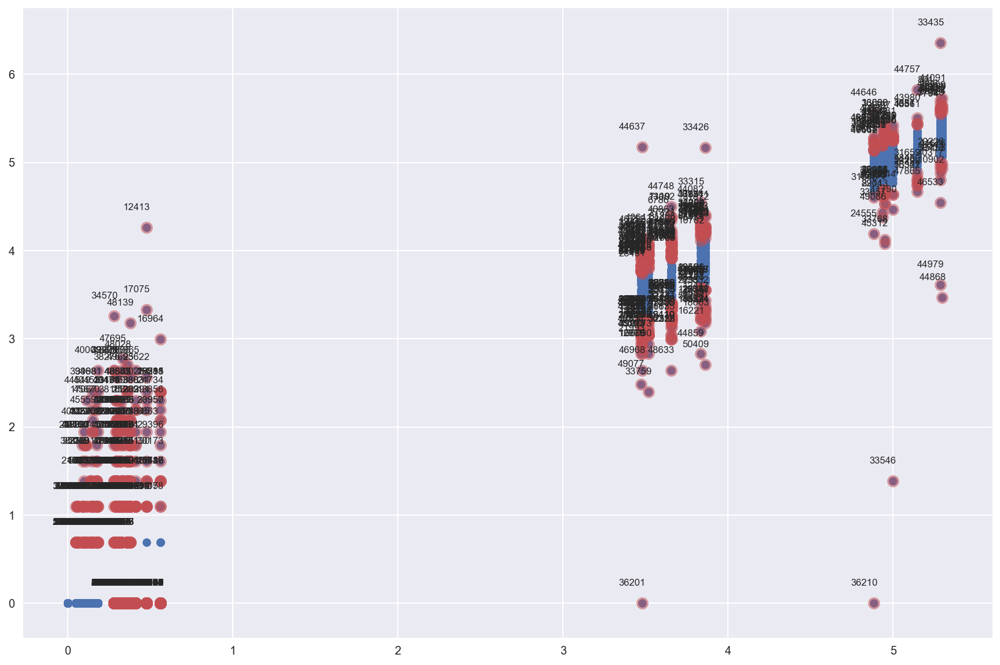

In [93]:
item_nbr_list_16 = get_item_nbr(df_16) #16번 store에서 팔린 item_nbr만 list로 저장

influence16 = result_model16.get_influence()

cooks_d2_16, pvals16 = influence16.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr16 = 4 / (len(df_16) - 778)
idx16 = np.where(cooks_d2_16 > fox_cr16)[0]

print(len(idx16)) #outlier 갯수

X16 = result_model16.predict(df_16)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X16, df_16['log_units'])
plt.scatter(X16[idx16], df_16.loc[idx16]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx16)), idx16, list(zip(X16[idx16], df_16.loc[idx16]['log_units'])),
                    [(-20, 15)] * len(idx16), size = "small", ax = ax)

plt.show()

In [94]:
for num in idx16 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_16 :
        if item_nbr == df_16.loc[num].item_nbr :
            mean = df_16[df_16['item_nbr'] == item_nbr]['log_units'].mean()
            df_16.set_value(num, 'log_units', mean)
            df_16.set_value(num, 'units', np.exp(mean) - 1)

model16_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_16)
result_model16_new = model16_new.fit()
print(result_model16_new.summary())

test_16_new = processed_test[processed_test['store_nbr'] == 16]

test_16_new['log_units'] = result_model16_new.predict(test_16_new)
test_16_new['units'] = np.exp(test_16_new['log_units']) - 1
result_test2.append(test_16_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 6.395e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:50:56   Log-Likelihood:             1.2933e+05
No. Observations:               50505   AIC:                        -2.571e+05
Df Residuals:                   49728   BIC:                        -2.502e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [95]:
del X16, cooks_d2_16, cv16_1, cv16_2, cv16_3, cv16_4, cv16_5, cv16_test, cv16_train, df_16, fox_cr16, idx16, influence16, item_nbr_list_16, model16
del model16_new, model_cv16, pvals16, result_model16, result_model16_new, result_model_cv16, test_16, test_16_new

In [96]:
df_17 = processed_train[processed_train['store_nbr'] == 17].reset_index(drop = True)

model17 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_17)
result_model17 = model17.fit()
print(result_model17.summary())

test_17 = processed_test[processed_test['store_nbr'] == 17]

test_17['log_units'] = result_model17.predict(test_17)
test_17['units'] = np.exp(test_17['log_units']) - 1
result_test.append(test_17)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.989
Model:                            OLS   Adj. R-squared:                  0.988
Method:                 Least Squares   F-statistic:                     5578.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:51:11   Log-Likelihood:                 54806.
No. Observations:               50505   AIC:                        -1.081e+05
Df Residuals:                   49728   BIC:                        -1.012e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [97]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv17_1 = df_17[:10101]
cv17_2 = df_17[10101:20202]
cv17_3 = df_17[20202:30414]
cv17_4 = df_17[30414:40515]
cv17_5 = df_17[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv17_train = pd.concat([cv17_1, cv17_2, cv17_3, cv17_4], ignore_index = True)
cv17_test = cv17_5

model_cv17 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv17_train)
result_model_cv17 = model_cv17.fit()
print(result_model_cv17.summary())

cv17_test['log_units_cv'] = result_model_cv17.predict(cv17_test)
cv17_test['units_cv'] = np.exp(cv17_test['log_units_cv']) - 1

cv17_test['RMSLE'] = np.log((cv17_test['units_cv'] + 1) / (cv17_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv17_test['RMSLE']) / len(cv17_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.990
Model:                            OLS   Adj. R-squared:                  0.990
Method:                 Least Squares   F-statistic:                     5119.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:51:22   Log-Likelihood:                 46512.
No. Observations:               40515   AIC:                        -9.147e+04
Df Residuals:                   39738   BIC:                        -8.478e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.101908245369


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1291


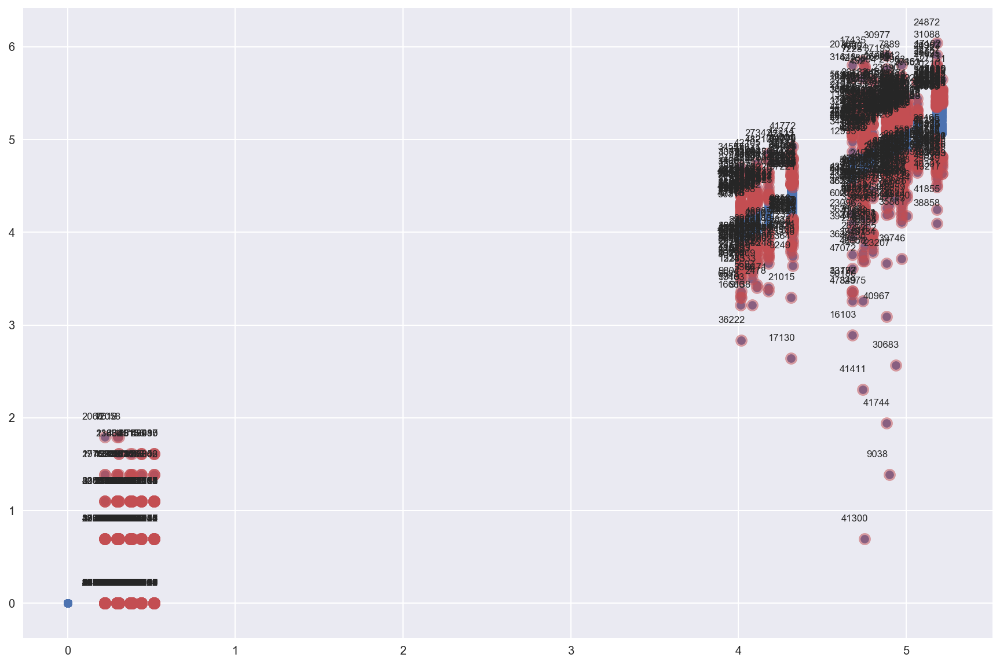

In [98]:
item_nbr_list_17 = get_item_nbr(df_17) #17번 store에서 팔린 item_nbr만 list로 저장

influence17 = result_model17.get_influence()

cooks_d2_17, pvals17 = influence17.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr17 = 4 / (len(df_17) - 778)
idx17 = np.where(cooks_d2_17 > fox_cr17)[0]

print(len(idx17)) #outlier 갯수

X17 = result_model17.predict(df_17)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X17, df_17['log_units'])
plt.scatter(X17[idx17], df_17.loc[idx17]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx17)), idx17, list(zip(X17[idx17], df_17.loc[idx17]['log_units'])),
                    [(-20, 15)] * len(idx17), size = "small", ax = ax)

plt.show()

In [99]:
for num in idx17 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_17 :
        if item_nbr == df_17.loc[num].item_nbr :
            mean = df_17[df_17['item_nbr'] == item_nbr]['log_units'].mean()
            df_17.set_value(num, 'log_units', mean)
            df_17.set_value(num, 'units', np.exp(mean) - 1)

model17_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_17)
result_model17_new = model17_new.fit()
print(result_model17_new.summary())

test_17_new = processed_test[processed_test['store_nbr'] == 17]

test_17_new['log_units'] = result_model17_new.predict(test_17_new)
test_17_new['units'] = np.exp(test_17_new['log_units']) - 1
result_test2.append(test_17_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.768e+05
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:51:43   Log-Likelihood:             1.4208e+05
No. Observations:               50505   AIC:                        -2.826e+05
Df Residuals:                   49728   BIC:                        -2.757e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [100]:
del X17, cooks_d2_17, cv17_1, cv17_2, cv17_3, cv17_4, cv17_5, cv17_test, cv17_train, df_17, fox_cr17, idx17, influence17, item_nbr_list_17, model17
del model17_new, model_cv17, pvals17, result_model17, result_model17_new, result_model_cv17, test_17, test_17_new

In [101]:
df_18 = processed_train[processed_train['store_nbr'] == 18].reset_index(drop = True)

model18 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_18)
result_model18 = model18.fit()
print(result_model18.summary())

test_18 = processed_test[processed_test['store_nbr'] == 18]

test_18['log_units'] = result_model18.predict(test_18)
test_18['units'] = np.exp(test_18['log_units']) - 1
result_test.append(test_18)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.939
Model:                            OLS   Adj. R-squared:                  0.938
Method:                 Least Squares   F-statistic:                     978.5
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:51:58   Log-Likelihood:                 50464.
No. Observations:               50505   AIC:                        -9.937e+04
Df Residuals:                   49728   BIC:                        -9.251e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [102]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv18_1 = df_18[:10101]
cv18_2 = df_18[10101:20202]
cv18_3 = df_18[20202:30414]
cv18_4 = df_18[30414:40515]
cv18_5 = df_18[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv18_train = pd.concat([cv18_1, cv18_2, cv18_3, cv18_4], ignore_index = True)
cv18_test = cv18_5

model_cv18 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv18_train)
result_model_cv18 = model_cv18.fit()
print(result_model_cv18.summary())

cv18_test['log_units_cv'] = result_model_cv18.predict(cv18_test)
cv18_test['units_cv'] = np.exp(cv18_test['log_units_cv']) - 1

cv18_test['RMSLE'] = np.log((cv18_test['units_cv'] + 1) / (cv18_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv18_test['RMSLE']) / len(cv18_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.939
Model:                            OLS   Adj. R-squared:                  0.938
Method:                 Least Squares   F-statistic:                     792.1
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:52:10   Log-Likelihood:                 41049.
No. Observations:               40515   AIC:                        -8.054e+04
Df Residuals:                   39738   BIC:                        -7.386e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.0951537363473


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1482


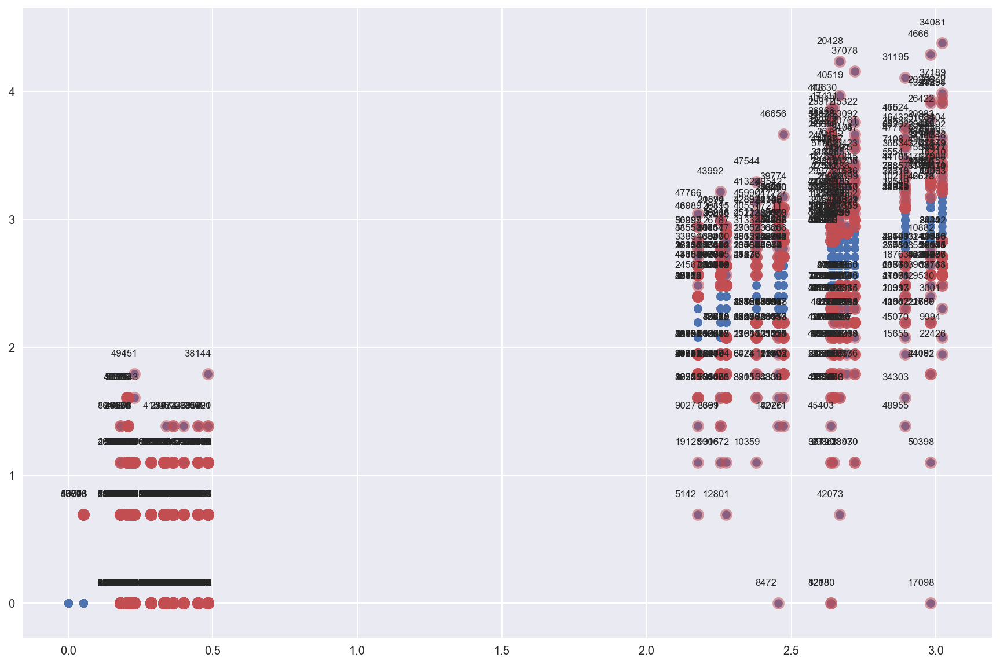

In [103]:
item_nbr_list_18 = get_item_nbr(df_18) #18번 store에서 팔린 item_nbr만 list로 저장

influence18 = result_model18.get_influence()

cooks_d2_18, pvals18 = influence18.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr18 = 4 / (len(df_18) - 778)
idx18 = np.where(cooks_d2_18 > fox_cr18)[0]

print(len(idx18)) #outlier 갯수

X18 = result_model18.predict(df_18)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X18, df_18['log_units'])
plt.scatter(X18[idx18], df_18.loc[idx18]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx18)), idx18, list(zip(X18[idx18], df_18.loc[idx18]['log_units'])),
                    [(-20, 15)] * len(idx18), size = "small", ax = ax)

plt.show()

In [104]:
for num in idx18 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_18 :
        if item_nbr == df_18.loc[num].item_nbr :
            mean = df_18[df_18['item_nbr'] == item_nbr]['log_units'].mean()
            df_18.set_value(num, 'log_units', mean)
            df_18.set_value(num, 'units', np.exp(mean) - 1)

model18_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_18)
result_model18_new = model18_new.fit()
print(result_model18_new.summary())

test_18_new = processed_test[processed_test['store_nbr'] == 18]

test_18_new['log_units'] = result_model18_new.predict(test_18_new)
test_18_new['units'] = np.exp(test_18_new['log_units']) - 1
result_test2.append(test_18_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 4.646e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:52:31   Log-Likelihood:             1.4740e+05
No. Observations:               50505   AIC:                        -2.932e+05
Df Residuals:                   49728   BIC:                        -2.864e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [105]:
del X18, cooks_d2_18, cv18_1, cv18_2, cv18_3, cv18_4, cv18_5, cv18_test, cv18_train, df_18, fox_cr18, idx18, influence18, item_nbr_list_18, model18
del model18_new, model_cv18, pvals18, result_model18, result_model18_new, result_model_cv18, test_18, test_18_new

In [106]:
df_19 = processed_train[processed_train['store_nbr'] == 19].reset_index(drop = True)

model19 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_19)
result_model19 = model19.fit()
print(result_model19.summary())

test_19 = processed_test[processed_test['store_nbr'] == 19]

test_19['log_units'] = result_model19.predict(test_19)
test_19['units'] = np.exp(test_19['log_units']) - 1
result_test.append(test_19)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.852
Model:                            OLS   Adj. R-squared:                  0.850
Method:                 Least Squares   F-statistic:                     369.5
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:52:46   Log-Likelihood:                 23876.
No. Observations:               50505   AIC:                        -4.620e+04
Df Residuals:                   49728   BIC:                        -3.934e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [107]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv19_1 = df_19[:10101]
cv19_2 = df_19[10101:20202]
cv19_3 = df_19[20202:30414]
cv19_4 = df_19[30414:40515]
cv19_5 = df_19[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv19_train = pd.concat([cv19_1, cv19_2, cv19_3, cv19_4], ignore_index = True)
cv19_test = cv19_5

model_cv19 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv19_train)
result_model_cv19 = model_cv19.fit()
print(result_model_cv19.summary())

cv19_test['log_units_cv'] = result_model_cv19.predict(cv19_test)
cv19_test['units_cv'] = np.exp(cv19_test['log_units_cv']) - 1

cv19_test['RMSLE'] = np.log((cv19_test['units_cv'] + 1) / (cv19_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv19_test['RMSLE']) / len(cv19_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.880
Model:                            OLS   Adj. R-squared:                  0.878
Method:                 Least Squares   F-statistic:                     375.1
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:52:58   Log-Likelihood:                 24196.
No. Observations:               40515   AIC:                        -4.684e+04
Df Residuals:                   39738   BIC:                        -4.015e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.217158063579


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1506


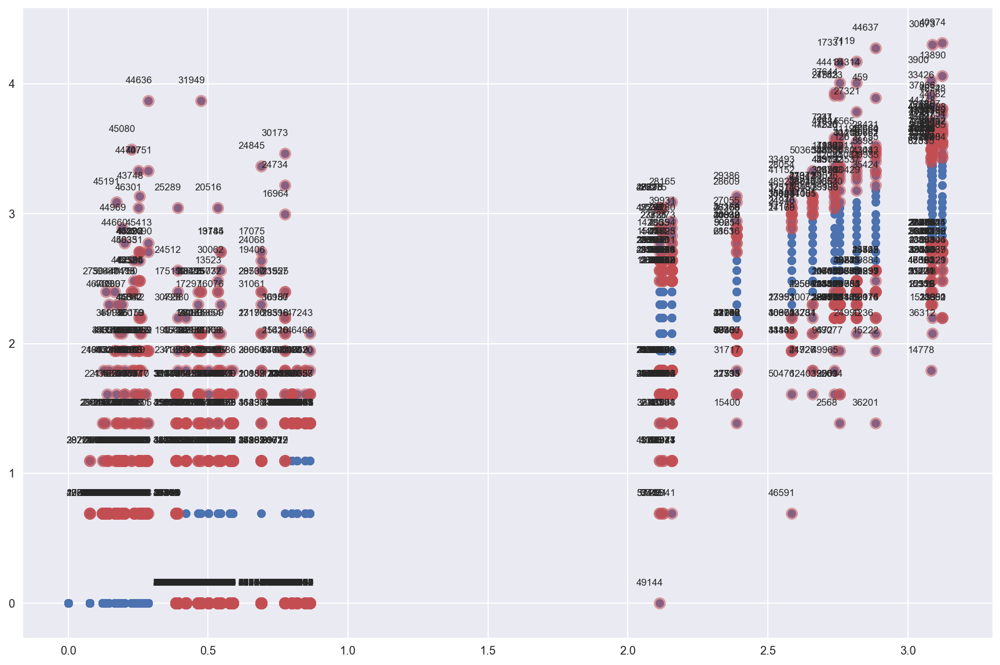

In [108]:
item_nbr_list_19 = get_item_nbr(df_19) #19번 store에서 팔린 item_nbr만 list로 저장

influence19 = result_model19.get_influence()

cooks_d2_19, pvals19 = influence19.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr19 = 4 / (len(df_19) - 778)
idx19 = np.where(cooks_d2_19 > fox_cr19)[0]

print(len(idx19)) #outlier 갯수

X19 = result_model19.predict(df_19)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X19, df_19['log_units'])
plt.scatter(X19[idx19], df_19.loc[idx19]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx19)), idx19, list(zip(X19[idx19], df_19.loc[idx19]['log_units'])),
                    [(-20, 15)] * len(idx19), size = "small", ax = ax)

plt.show()

In [109]:
for num in idx19 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_19 :
        if item_nbr == df_19.loc[num].item_nbr :
            mean = df_19[df_19['item_nbr'] == item_nbr]['log_units'].mean()
            df_19.set_value(num, 'log_units', mean)
            df_19.set_value(num, 'units', np.exp(mean) - 1)

model19_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_19)
result_model19_new = model19_new.fit()
print(result_model19_new.summary())

test_19_new = processed_test[processed_test['store_nbr'] == 19]

test_19_new['log_units'] = result_model19_new.predict(test_19_new)
test_19_new['units'] = np.exp(test_19_new['log_units']) - 1
result_test2.append(test_19_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.994
Method:                 Least Squares   F-statistic:                 1.154e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:53:21   Log-Likelihood:             1.1050e+05
No. Observations:               50505   AIC:                        -2.194e+05
Df Residuals:                   49728   BIC:                        -2.126e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [110]:
del X19, cooks_d2_19, cv19_1, cv19_2, cv19_3, cv19_4, cv19_5, cv19_test, cv19_train, df_19, fox_cr19, idx19, influence19, item_nbr_list_19, model19
del model19_new, model_cv19, pvals19, result_model19, result_model19_new, result_model_cv19, test_19, test_19_new

In [111]:
df_20 = processed_train[processed_train['store_nbr'] == 20].reset_index(drop = True)

model20 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_20)
result_model20 = model20.fit()
print(result_model20.summary())

test_20 = processed_test[processed_test['store_nbr'] == 20]

test_20['log_units'] = result_model20.predict(test_20)
test_20['units'] = np.exp(test_20['log_units']) - 1
result_test.append(test_20)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.946
Model:                            OLS   Adj. R-squared:                  0.945
Method:                 Least Squares   F-statistic:                     1124.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:53:36   Log-Likelihood:                 33505.
No. Observations:               50505   AIC:                        -6.546e+04
Df Residuals:                   49728   BIC:                        -5.859e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [112]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv20_1 = df_20[:10101]
cv20_2 = df_20[10101:20202]
cv20_3 = df_20[20202:30414]
cv20_4 = df_20[30414:40515]
cv20_5 = df_20[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv20_train = pd.concat([cv20_1, cv20_2, cv20_3, cv20_4], ignore_index = True)
cv20_test = cv20_5

model_cv20 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv20_train)
result_model_cv20 = model_cv20.fit()
print(result_model_cv20.summary())

cv20_test['log_units_cv'] = result_model_cv20.predict(cv20_test)
cv20_test['units_cv'] = np.exp(cv20_test['log_units_cv']) - 1

cv20_test['RMSLE'] = np.log((cv20_test['units_cv'] + 1) / (cv20_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv20_test['RMSLE']) / len(cv20_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.945
Model:                            OLS   Adj. R-squared:                  0.944
Method:                 Least Squares   F-statistic:                     874.6
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:53:47   Log-Likelihood:                 25947.
No. Observations:               40515   AIC:                        -5.034e+04
Df Residuals:                   39738   BIC:                        -4.365e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.115324830876


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1558


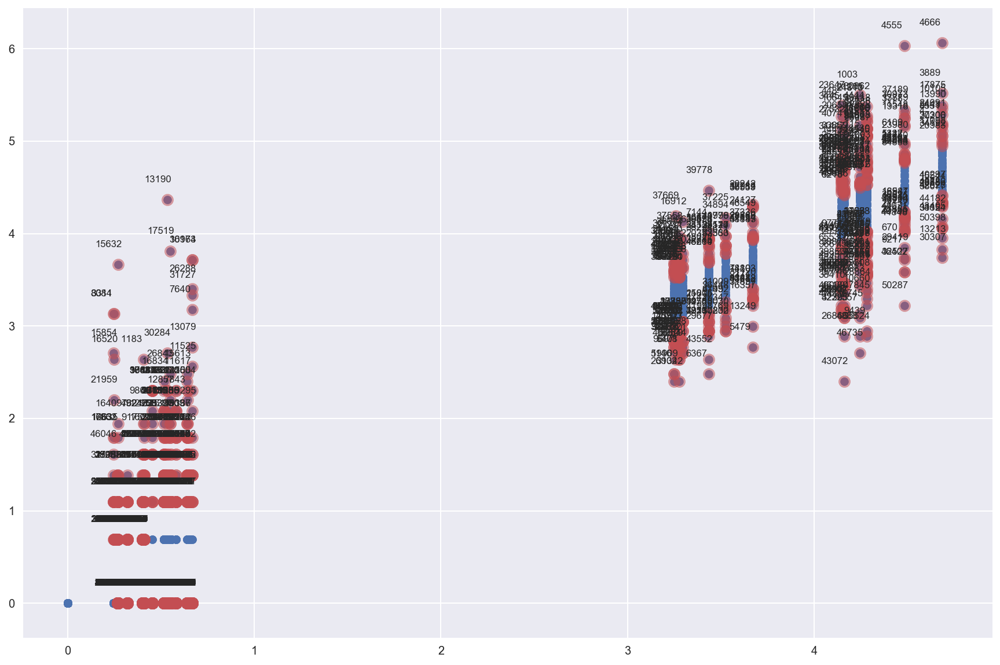

In [113]:
item_nbr_list_20 = get_item_nbr(df_20) #20번 store에서 팔린 item_nbr만 list로 저장

influence20 = result_model20.get_influence()

cooks_d2_20, pvals20 = influence20.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr20 = 4 / (len(df_20) - 778)
idx20 = np.where(cooks_d2_20 > fox_cr20)[0]

print(len(idx20)) #outlier 갯수

X20 = result_model20.predict(df_20)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X20, df_20['log_units'])
plt.scatter(X20[idx20], df_20.loc[idx20]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx20)), idx20, list(zip(X20[idx20], df_20.loc[idx20]['log_units'])),
                    [(-20, 15)] * len(idx20), size = "small", ax = ax)

plt.show()

In [114]:
for num in idx20 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_20 :
        if item_nbr == df_20.loc[num].item_nbr :
            mean = df_20[df_20['item_nbr'] == item_nbr]['log_units'].mean()
            df_20.set_value(num, 'log_units', mean)
            df_20.set_value(num, 'units', np.exp(mean) - 1)

model20_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_20)
result_model20_new = model20_new.fit()
print(result_model20_new.summary())

test_20_new = processed_test[processed_test['store_nbr'] == 20]

test_20_new['log_units'] = result_model20_new.predict(test_20_new)
test_20_new['units'] = np.exp(test_20_new['log_units']) - 1
result_test2.append(test_20_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 3.657e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:54:10   Log-Likelihood:             1.2148e+05
No. Observations:               50505   AIC:                        -2.414e+05
Df Residuals:                   49728   BIC:                        -2.345e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [115]:
del X20, cooks_d2_20, cv20_1, cv20_2, cv20_3, cv20_4, cv20_5, cv20_test, cv20_train, df_20, fox_cr20, idx20, influence20, item_nbr_list_20, model20
del model20_new, model_cv20, pvals20, result_model20, result_model20_new, result_model_cv20, test_20, test_20_new

In [116]:
df_21 = processed_train[processed_train['store_nbr'] == 21].reset_index(drop = True)

model21 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_21)
result_model21 = model21.fit()
print(result_model21.summary())

test_21 = processed_test[processed_test['store_nbr'] == 21]

test_21['log_units'] = result_model21.predict(test_21)
test_21['units'] = np.exp(test_21['log_units']) - 1
result_test.append(test_21)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.983
Model:                            OLS   Adj. R-squared:                  0.983
Method:                 Least Squares   F-statistic:                     3661.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:54:24   Log-Likelihood:                 61665.
No. Observations:               50505   AIC:                        -1.218e+05
Df Residuals:                   49728   BIC:                        -1.149e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [117]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv21_1 = df_21[:10101]
cv21_2 = df_21[10101:20202]
cv21_3 = df_21[20202:30414]
cv21_4 = df_21[30414:40515]
cv21_5 = df_21[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv21_train = pd.concat([cv21_1, cv21_2, cv21_3, cv21_4], ignore_index = True)
cv21_test = cv21_5

model_cv21 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv21_train)
result_model_cv21 = model_cv21.fit()
print(result_model_cv21.summary())

cv21_test['log_units_cv'] = result_model_cv21.predict(cv21_test)
cv21_test['units_cv'] = np.exp(cv21_test['log_units_cv']) - 1

cv21_test['RMSLE'] = np.log((cv21_test['units_cv'] + 1) / (cv21_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv21_test['RMSLE']) / len(cv21_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.984
Model:                            OLS   Adj. R-squared:                  0.984
Method:                 Least Squares   F-statistic:                     3130.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:54:36   Log-Likelihood:                 50862.
No. Observations:               40515   AIC:                        -1.002e+05
Df Residuals:                   39738   BIC:                        -9.348e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.0815341611053


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1002


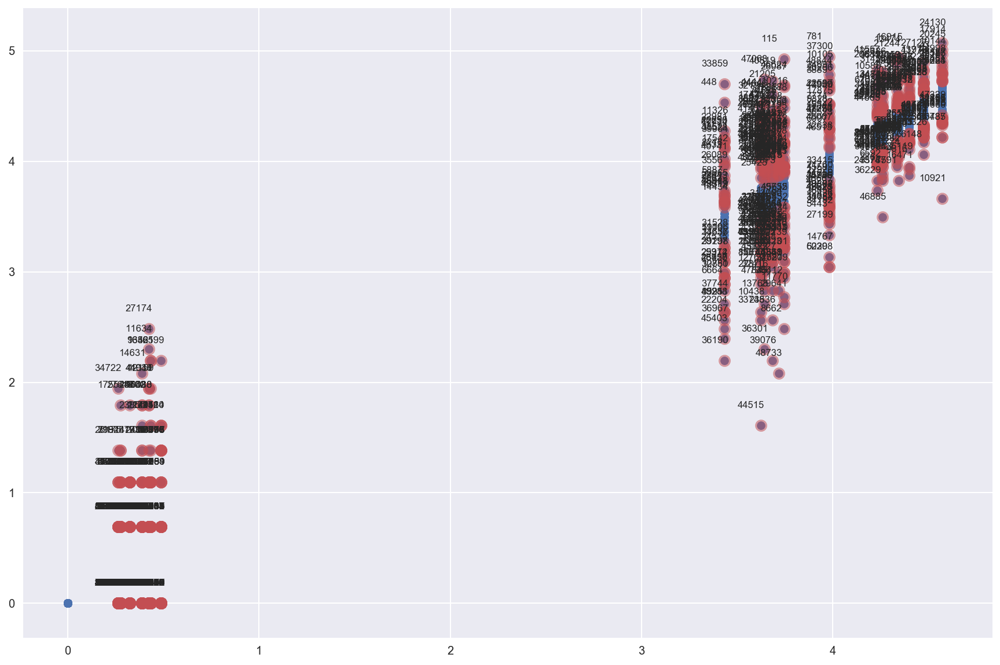

In [118]:
item_nbr_list_21 = get_item_nbr(df_21) #21번 store에서 팔린 item_nbr만 list로 저장

influence21 = result_model21.get_influence()

cooks_d2_21, pvals21 = influence21.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr21 = 4 / (len(df_21) - 778)
idx21 = np.where(cooks_d2_21 > fox_cr21)[0]

print(len(idx21)) #outlier 갯수

X21 = result_model21.predict(df_21)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X21, df_21['log_units'])
plt.scatter(X21[idx21], df_21.loc[idx21]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx21)), idx21, list(zip(X21[idx21], df_21.loc[idx21]['log_units'])),
                    [(-20, 15)] * len(idx21), size = "small", ax = ax)

plt.show()

In [119]:
for num in idx21 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_21 :
        if item_nbr == df_21.loc[num].item_nbr :
            mean = df_21[df_21['item_nbr'] == item_nbr]['log_units'].mean()
            df_21.set_value(num, 'log_units', mean)
            df_21.set_value(num, 'units', np.exp(mean) - 1)

model21_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_21)
result_model21_new = model21_new.fit()
print(result_model21_new.summary())

test_21_new = processed_test[processed_test['store_nbr'] == 21]

test_21_new['log_units'] = result_model21_new.predict(test_21_new)
test_21_new['units'] = np.exp(test_21_new['log_units']) - 1
result_test2.append(test_21_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.732e+05
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:54:55   Log-Likelihood:             1.5904e+05
No. Observations:               50505   AIC:                        -3.165e+05
Df Residuals:                   49728   BIC:                        -3.097e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [120]:
del X21, cooks_d2_21, cv21_1, cv21_2, cv21_3, cv21_4, cv21_5, cv21_test, cv21_train, df_21, fox_cr21, idx21, influence21, item_nbr_list_21, model21
del model21_new, model_cv21, pvals21, result_model21, result_model21_new, result_model_cv21, test_21, test_21_new

In [121]:
df_22 = processed_train[processed_train['store_nbr'] == 22].reset_index(drop = True)

model22 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_22)
result_model22 = model22.fit()
print(result_model22.summary())

test_22 = processed_test[processed_test['store_nbr'] == 22]

test_22['log_units'] = result_model22.predict(test_22)
test_22['units'] = np.exp(test_22['log_units']) - 1
result_test.append(test_22)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.921
Model:                            OLS   Adj. R-squared:                  0.919
Method:                 Least Squares   F-statistic:                     743.2
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:55:11   Log-Likelihood:                 22525.
No. Observations:               50505   AIC:                        -4.350e+04
Df Residuals:                   49728   BIC:                        -3.664e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [122]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv22_1 = df_22[:10101]
cv22_2 = df_22[10101:20202]
cv22_3 = df_22[20202:30414]
cv22_4 = df_22[30414:40515]
cv22_5 = df_22[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv22_train = pd.concat([cv22_1, cv22_2, cv22_3, cv22_4], ignore_index = True)
cv22_test = cv22_5

model_cv22 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv22_train)
result_model_cv22 = model_cv22.fit()
print(result_model_cv22.summary())

cv22_test['log_units_cv'] = result_model_cv22.predict(cv22_test)
cv22_test['units_cv'] = np.exp(cv22_test['log_units_cv']) - 1

cv22_test['RMSLE'] = np.log((cv22_test['units_cv'] + 1) / (cv22_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv22_test['RMSLE']) / len(cv22_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.921
Model:                            OLS   Adj. R-squared:                  0.919
Method:                 Least Squares   F-statistic:                     594.8
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:55:23   Log-Likelihood:                 17496.
No. Observations:               40515   AIC:                        -3.344e+04
Df Residuals:                   39738   BIC:                        -2.675e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.151185229778


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1436


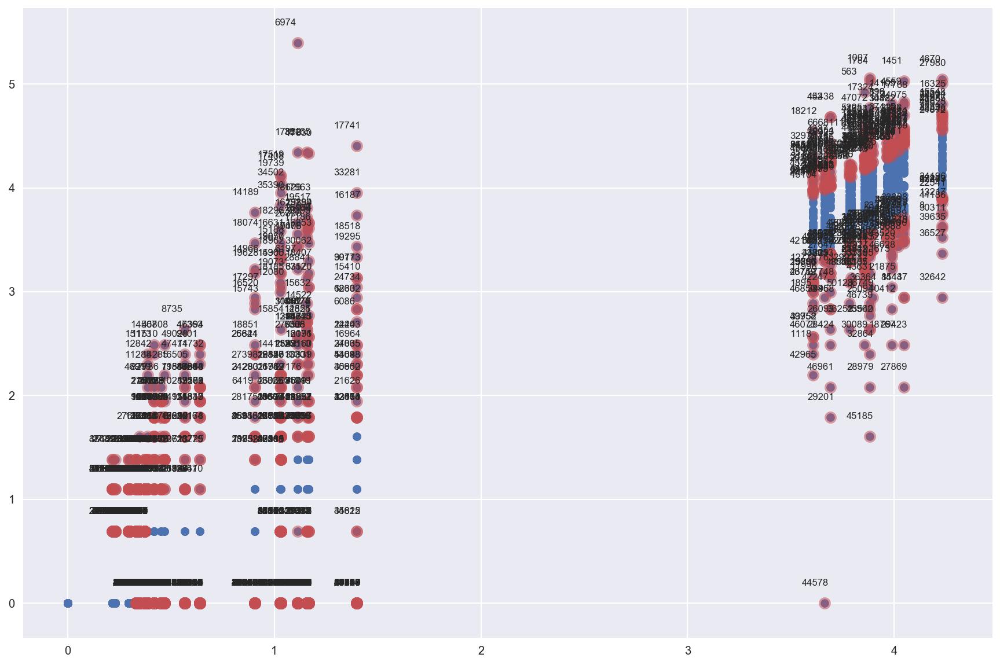

In [123]:
item_nbr_list_22 = get_item_nbr(df_22) #22번 store에서 팔린 item_nbr만 list로 저장

influence22 = result_model22.get_influence()

cooks_d2_22, pvals22 = influence22.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr22 = 4 / (len(df_22) - 778)
idx22 = np.where(cooks_d2_22 > fox_cr22)[0]

print(len(idx22)) #outlier 갯수

X22 = result_model22.predict(df_22)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X22, df_22['log_units'])
plt.scatter(X22[idx22], df_22.loc[idx22]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx22)), idx22, list(zip(X22[idx22], df_22.loc[idx22]['log_units'])),
                    [(-20, 15)] * len(idx22), size = "small", ax = ax)

plt.show()

In [124]:
for num in idx22 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_22 :
        if item_nbr == df_22.loc[num].item_nbr :
            mean = df_22[df_22['item_nbr'] == item_nbr]['log_units'].mean()
            df_22.set_value(num, 'log_units', mean)
            df_22.set_value(num, 'units', np.exp(mean) - 1)

model22_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_22)
result_model22_new = model22_new.fit()
print(result_model22_new.summary())

test_22_new = processed_test[processed_test['store_nbr'] == 22]

test_22_new['log_units'] = result_model22_new.predict(test_22_new)
test_22_new['units'] = np.exp(test_22_new['log_units']) - 1
result_test2.append(test_22_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                 2.320e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:55:45   Log-Likelihood:             1.0953e+05
No. Observations:               50505   AIC:                        -2.175e+05
Df Residuals:                   49728   BIC:                        -2.106e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [125]:
del X22, cooks_d2_22, cv22_1, cv22_2, cv22_3, cv22_4, cv22_5, cv22_test, cv22_train, df_22, fox_cr22, idx22, influence22, item_nbr_list_22, model22
del model22_new, model_cv22, pvals22, result_model22, result_model22_new, result_model_cv22, test_22, test_22_new

In [126]:
df_23 = processed_train[processed_train['store_nbr'] == 23].reset_index(drop = True)

model23 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_23)
result_model23 = model23.fit()
print(result_model23.summary())

test_23 = processed_test[processed_test['store_nbr'] == 23]

test_23['log_units'] = result_model23.predict(test_23)
test_23['units'] = np.exp(test_23['log_units']) - 1
result_test.append(test_23)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.959
Model:                            OLS   Adj. R-squared:                  0.958
Method:                 Least Squares   F-statistic:                     1504.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:56:00   Log-Likelihood:                 46090.
No. Observations:               50505   AIC:                        -9.063e+04
Df Residuals:                   49728   BIC:                        -8.377e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [127]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv23_1 = df_23[:10101]
cv23_2 = df_23[10101:20202]
cv23_3 = df_23[20202:30414]
cv23_4 = df_23[30414:40515]
cv23_5 = df_23[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv23_train = pd.concat([cv23_1, cv23_2, cv23_3, cv23_4], ignore_index = True)
cv23_test = cv23_5

model_cv23 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv23_train)
result_model_cv23 = model_cv23.fit()
print(result_model_cv23.summary())

cv23_test['log_units_cv'] = result_model_cv23.predict(cv23_test)
cv23_test['units_cv'] = np.exp(cv23_test['log_units_cv']) - 1

cv23_test['RMSLE'] = np.log((cv23_test['units_cv'] + 1) / (cv23_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv23_test['RMSLE']) / len(cv23_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.962
Model:                            OLS   Adj. R-squared:                  0.962
Method:                 Least Squares   F-statistic:                     1307.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:56:11   Log-Likelihood:                 38858.
No. Observations:               40515   AIC:                        -7.616e+04
Df Residuals:                   39738   BIC:                        -6.947e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.115028219867


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1265


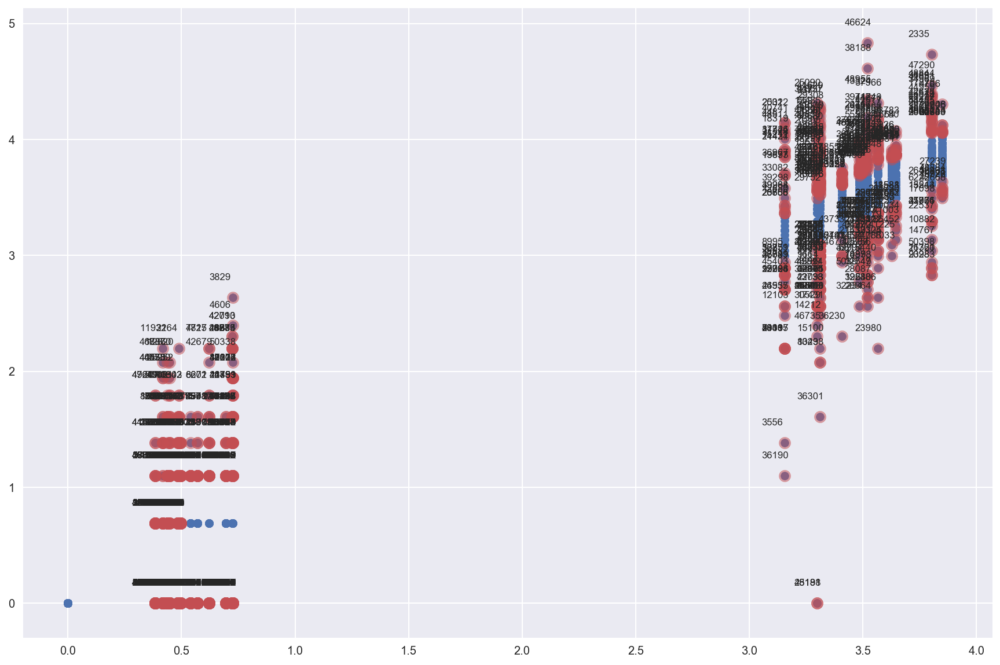

In [128]:
item_nbr_list_23 = get_item_nbr(df_23) #23번 store에서 팔린 item_nbr만 list로 저장

influence23 = result_model23.get_influence()

cooks_d2_23, pvals23 = influence23.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr23 = 4 / (len(df_23) - 778)
idx23 = np.where(cooks_d2_23 > fox_cr23)[0]

print(len(idx23)) #outlier 갯수

X23 = result_model23.predict(df_23)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X23, df_23['log_units'])
plt.scatter(X23[idx23], df_23.loc[idx23]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx23)), idx23, list(zip(X23[idx23], df_23.loc[idx23]['log_units'])),
                    [(-20, 15)] * len(idx23), size = "small", ax = ax)

plt.show()

In [129]:
for num in idx23 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_23 :
        if item_nbr == df_23.loc[num].item_nbr :
            mean = df_23[df_23['item_nbr'] == item_nbr]['log_units'].mean()
            df_23.set_value(num, 'log_units', mean)
            df_23.set_value(num, 'units', np.exp(mean) - 1)

model23_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_23)
result_model23_new = model23_new.fit()
print(result_model23_new.summary())

test_23_new = processed_test[processed_test['store_nbr'] == 23]

test_23_new['log_units'] = result_model23_new.predict(test_23_new)
test_23_new['units'] = np.exp(test_23_new['log_units']) - 1
result_test2.append(test_23_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 5.438e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:56:32   Log-Likelihood:             1.3650e+05
No. Observations:               50505   AIC:                        -2.715e+05
Df Residuals:                   49728   BIC:                        -2.646e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [130]:
del X23, cooks_d2_23, cv23_1, cv23_2, cv23_3, cv23_4, cv23_5, cv23_test, cv23_train, df_23, fox_cr23, idx23, influence23, item_nbr_list_23, model23
del model23_new, model_cv23, pvals23, result_model23, result_model23_new, result_model_cv23, test_23, test_23_new

In [131]:
df_24 = processed_train[processed_train['store_nbr'] == 24].reset_index(drop = True)

model24 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_24)
result_model24 = model24.fit()
print(result_model24.summary())

test_24 = processed_test[processed_test['store_nbr'] == 24]

test_24['log_units'] = result_model24.predict(test_24)
test_24['units'] = np.exp(test_24['log_units']) - 1
result_test.append(test_24)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.940
Model:                            OLS   Adj. R-squared:                  0.939
Method:                 Least Squares   F-statistic:                     1003.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:56:47   Log-Likelihood:                 33050.
No. Observations:               50505   AIC:                        -6.455e+04
Df Residuals:                   49728   BIC:                        -5.769e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [132]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv24_1 = df_24[:10101]
cv24_2 = df_24[10101:20202]
cv24_3 = df_24[20202:30414]
cv24_4 = df_24[30414:40515]
cv24_5 = df_24[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv24_train = pd.concat([cv24_1, cv24_2, cv24_3, cv24_4], ignore_index = True)
cv24_test = cv24_5

model_cv24 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv24_train)
result_model_cv24 = model_cv24.fit()
print(result_model_cv24.summary())

cv24_test['log_units_cv'] = result_model_cv24.predict(cv24_test)
cv24_test['units_cv'] = np.exp(cv24_test['log_units_cv']) - 1

cv24_test['RMSLE'] = np.log((cv24_test['units_cv'] + 1) / (cv24_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv24_test['RMSLE']) / len(cv24_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.948
Model:                            OLS   Adj. R-squared:                  0.947
Method:                 Least Squares   F-statistic:                     926.6
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:56:58   Log-Likelihood:                 29051.
No. Observations:               40515   AIC:                        -5.655e+04
Df Residuals:                   39738   BIC:                        -4.986e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.155335610062


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1359


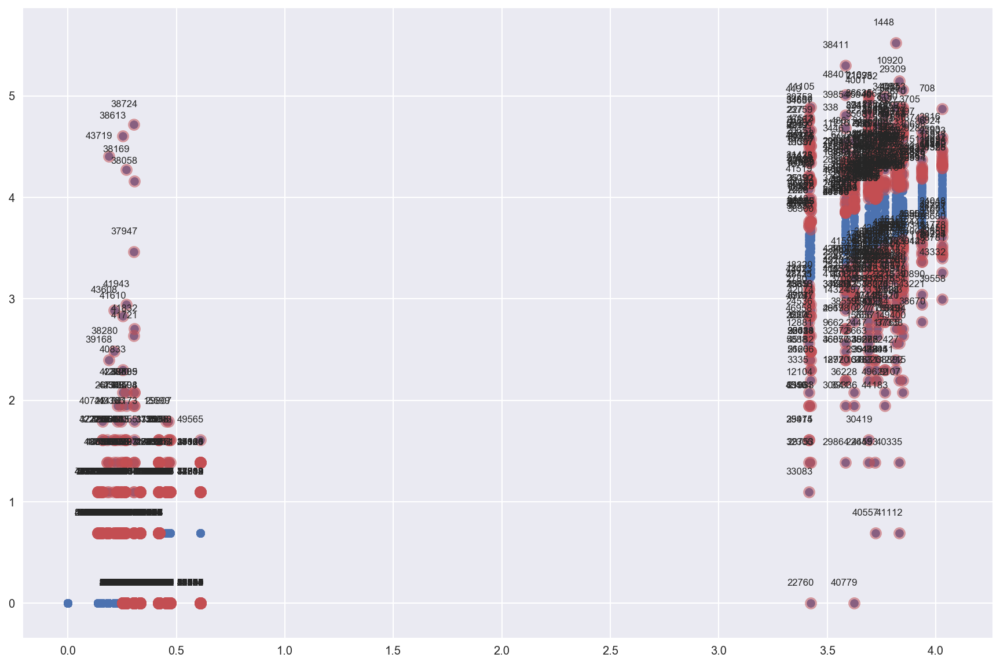

In [133]:
item_nbr_list_24 = get_item_nbr(df_24) #24번 store에서 팔린 item_nbr만 list로 저장

influence24 = result_model24.get_influence()

cooks_d2_24, pvals24 = influence24.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr24 = 4 / (len(df_24) - 778)
idx24 = np.where(cooks_d2_24 > fox_cr24)[0]

print(len(idx24)) #outlier 갯수

X24 = result_model24.predict(df_24)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X24, df_24['log_units'])
plt.scatter(X24[idx24], df_24.loc[idx24]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx24)), idx24, list(zip(X24[idx24], df_24.loc[idx24]['log_units'])),
                    [(-20, 15)] * len(idx24), size = "small", ax = ax)

plt.show()

In [134]:
for num in idx24 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_24 :
        if item_nbr == df_24.loc[num].item_nbr :
            mean = df_24[df_24['item_nbr'] == item_nbr]['log_units'].mean()
            df_24.set_value(num, 'log_units', mean)
            df_24.set_value(num, 'units', np.exp(mean) - 1)

model24_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_24)
result_model24_new = model24_new.fit()
print(result_model24_new.summary())

test_24_new = processed_test[processed_test['store_nbr'] == 24]

test_24_new['log_units'] = result_model24_new.predict(test_24_new)
test_24_new['units'] = np.exp(test_24_new['log_units']) - 1
result_test2.append(test_24_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 4.078e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:57:20   Log-Likelihood:             1.2684e+05
No. Observations:               50505   AIC:                        -2.521e+05
Df Residuals:                   49728   BIC:                        -2.453e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [135]:
del X24, cooks_d2_24, cv24_1, cv24_2, cv24_3, cv24_4, cv24_5, cv24_test, cv24_train, df_24, fox_cr24, idx24, influence24, item_nbr_list_24, model24
del model24_new, model_cv24, pvals24, result_model24, result_model24_new, result_model_cv24, test_24, test_24_new

In [136]:
df_25 = processed_train[processed_train['store_nbr'] == 25].reset_index(drop = True)

model25 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_25)
result_model25 = model25.fit()
print(result_model25.summary())

test_25 = processed_test[processed_test['store_nbr'] == 25]

test_25['log_units'] = result_model25.predict(test_25)
test_25['units'] = np.exp(test_25['log_units']) - 1
result_test.append(test_25)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.951
Model:                            OLS   Adj. R-squared:                  0.950
Method:                 Least Squares   F-statistic:                     1235.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:57:35   Log-Likelihood:                 26023.
No. Observations:               50505   AIC:                        -5.049e+04
Df Residuals:                   49728   BIC:                        -4.363e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [137]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv25_1 = df_25[:10101]
cv25_2 = df_25[10101:20202]
cv25_3 = df_25[20202:30414]
cv25_4 = df_25[30414:40515]
cv25_5 = df_25[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv25_train = pd.concat([cv25_1, cv25_2, cv25_3, cv25_4], ignore_index = True)
cv25_test = cv25_5

model_cv25 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv25_train)
result_model_cv25 = model_cv25.fit()
print(result_model_cv25.summary())

cv25_test['log_units_cv'] = result_model_cv25.predict(cv25_test)
cv25_test['units_cv'] = np.exp(cv25_test['log_units_cv']) - 1

cv25_test['RMSLE'] = np.log((cv25_test['units_cv'] + 1) / (cv25_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv25_test['RMSLE']) / len(cv25_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.972
Model:                            OLS   Adj. R-squared:                  0.971
Method:                 Least Squares   F-statistic:                     1746.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:57:47   Log-Likelihood:                 31487.
No. Observations:               40515   AIC:                        -6.142e+04
Df Residuals:                   39738   BIC:                        -5.473e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.257282276382


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1504


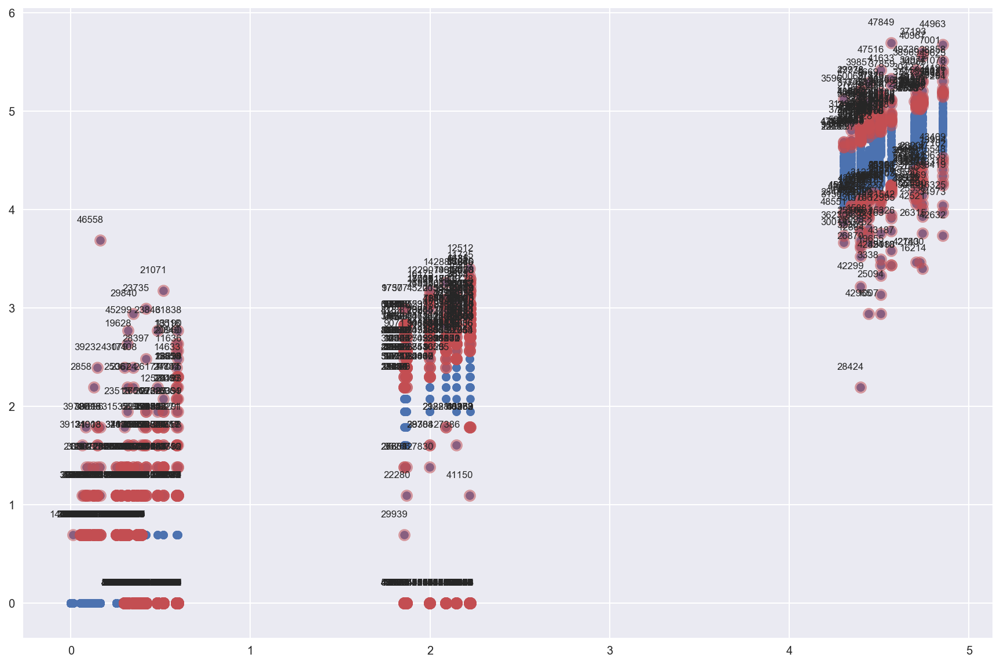

In [138]:
item_nbr_list_25 = get_item_nbr(df_25) #25번 store에서 팔린 item_nbr만 list로 저장

influence25 = result_model25.get_influence()

cooks_d2_25, pvals25 = influence25.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr25 = 4 / (len(df_25) - 778)
idx25 = np.where(cooks_d2_25 > fox_cr25)[0]

print(len(idx25)) #outlier 갯수

X25 = result_model25.predict(df_25)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X25, df_25['log_units'])
plt.scatter(X25[idx25], df_25.loc[idx25]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx25)), idx25, list(zip(X25[idx25], df_25.loc[idx25]['log_units'])),
                    [(-20, 15)] * len(idx25), size = "small", ax = ax)

plt.show()

In [139]:
for num in idx25 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_25 :
        if item_nbr == df_25.loc[num].item_nbr :
            mean = df_25[df_25['item_nbr'] == item_nbr]['log_units'].mean()
            df_25.set_value(num, 'log_units', mean)
            df_25.set_value(num, 'units', np.exp(mean) - 1)

model25_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_25)
result_model25_new = model25_new.fit()
print(result_model25_new.summary())

test_25_new = processed_test[processed_test['store_nbr'] == 25]

test_25_new['log_units'] = result_model25_new.predict(test_25_new)
test_25_new['units'] = np.exp(test_25_new['log_units']) - 1
result_test2.append(test_25_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 2.794e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:58:09   Log-Likelihood:             1.0511e+05
No. Observations:               50505   AIC:                        -2.087e+05
Df Residuals:                   49728   BIC:                        -2.018e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [140]:
del X25, cooks_d2_25, cv25_1, cv25_2, cv25_3, cv25_4, cv25_5, cv25_test, cv25_train, df_25, fox_cr25, idx25, influence25, item_nbr_list_25, model25
del model25_new, model_cv25, pvals25, result_model25, result_model25_new, result_model_cv25, test_25, test_25_new

In [141]:
df_26 = processed_train[processed_train['store_nbr'] == 26].reset_index(drop = True)

model26 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_26)
result_model26 = model26.fit()
print(result_model26.summary())

test_26 = processed_test[processed_test['store_nbr'] == 26]

test_26['log_units'] = result_model26.predict(test_26)
test_26['units'] = np.exp(test_26['log_units']) - 1
result_test.append(test_26)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.974
Model:                            OLS   Adj. R-squared:                  0.973
Method:                 Least Squares   F-statistic:                     2383.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:58:24   Log-Likelihood:                 51694.
No. Observations:               50505   AIC:                        -1.018e+05
Df Residuals:                   49728   BIC:                        -9.497e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [142]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv26_1 = df_26[:10101]
cv26_2 = df_26[10101:20202]
cv26_3 = df_26[20202:30414]
cv26_4 = df_26[30414:40515]
cv26_5 = df_26[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv26_train = pd.concat([cv26_1, cv26_2, cv26_3, cv26_4], ignore_index = True)
cv26_test = cv26_5

model_cv26 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv26_train)
result_model_cv26 = model_cv26.fit()
print(result_model_cv26.summary())

cv26_test['log_units_cv'] = result_model_cv26.predict(cv26_test)
cv26_test['units_cv'] = np.exp(cv26_test['log_units_cv']) - 1

cv26_test['RMSLE'] = np.log((cv26_test['units_cv'] + 1) / (cv26_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv26_test['RMSLE']) / len(cv26_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.977
Model:                            OLS   Adj. R-squared:                  0.977
Method:                 Least Squares   F-statistic:                     2218.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:58:35   Log-Likelihood:                 44411.
No. Observations:               40515   AIC:                        -8.727e+04
Df Residuals:                   39738   BIC:                        -8.058e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.110287081924


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


927


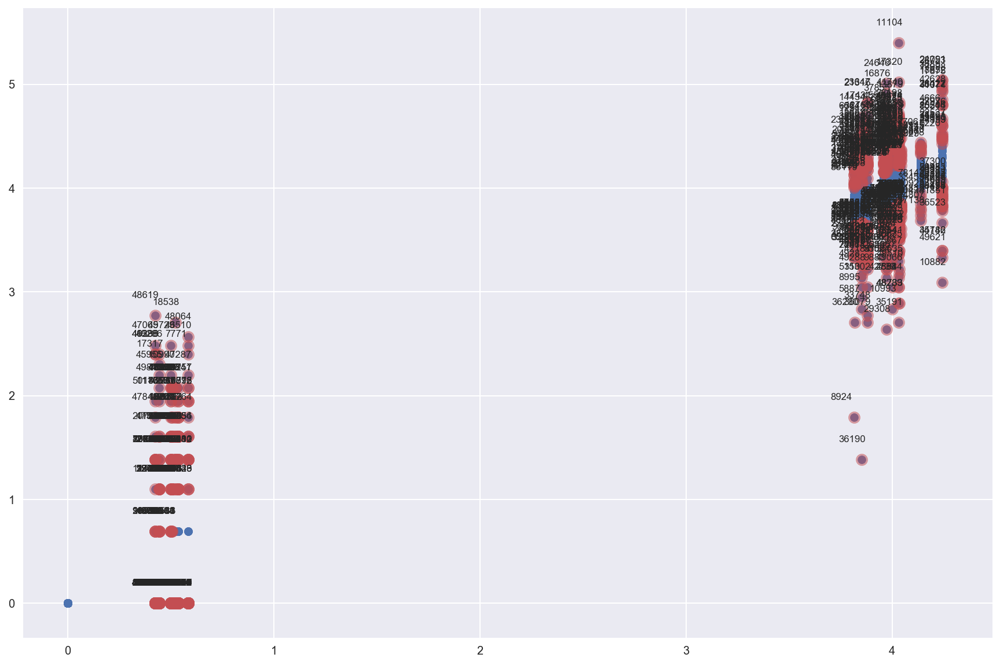

In [143]:
item_nbr_list_26 = get_item_nbr(df_26) #26번 store에서 팔린 item_nbr만 list로 저장

influence26 = result_model26.get_influence()

cooks_d2_26, pvals26 = influence26.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr26 = 4 / (len(df_26) - 778)
idx26 = np.where(cooks_d2_26 > fox_cr26)[0]

print(len(idx26)) #outlier 갯수

X26 = result_model26.predict(df_26)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X26, df_26['log_units'])
plt.scatter(X26[idx26], df_26.loc[idx26]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx26)), idx26, list(zip(X26[idx26], df_26.loc[idx26]['log_units'])),
                    [(-20, 15)] * len(idx26), size = "small", ax = ax)

plt.show()

In [144]:
for num in idx26 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_26 :
        if item_nbr == df_26.loc[num].item_nbr :
            mean = df_26[df_26['item_nbr'] == item_nbr]['log_units'].mean()
            df_26.set_value(num, 'log_units', mean)
            df_26.set_value(num, 'units', np.exp(mean) - 1)

model26_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_26)
result_model26_new = model26_new.fit()
print(result_model26_new.summary())

test_26_new = processed_test[processed_test['store_nbr'] == 26]

test_26_new['log_units'] = result_model26_new.predict(test_26_new)
test_26_new['units'] = np.exp(test_26_new['log_units']) - 1
result_test2.append(test_26_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 1.071e+05
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:58:55   Log-Likelihood:             1.4775e+05
No. Observations:               50505   AIC:                        -2.940e+05
Df Residuals:                   49728   BIC:                        -2.871e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [145]:
del X26, cooks_d2_26, cv26_1, cv26_2, cv26_3, cv26_4, cv26_5, cv26_test, cv26_train, df_26, fox_cr26, idx26, influence26, item_nbr_list_26, model26
del model26_new, model_cv26, pvals26, result_model26, result_model26_new, result_model_cv26, test_26, test_26_new

In [146]:
df_27 = processed_train[processed_train['store_nbr'] == 27].reset_index(drop = True)

model27 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_27)
result_model27 = model27.fit()
print(result_model27.summary())

test_27 = processed_test[processed_test['store_nbr'] == 27]

test_27['log_units'] = result_model27.predict(test_27)
test_27['units'] = np.exp(test_27['log_units']) - 1
result_test.append(test_27)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.924
Model:                            OLS   Adj. R-squared:                  0.923
Method:                 Least Squares   F-statistic:                     778.2
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:59:10   Log-Likelihood:                 26937.
No. Observations:               50505   AIC:                        -5.232e+04
Df Residuals:                   49728   BIC:                        -4.546e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [147]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv27_1 = df_27[:10101]
cv27_2 = df_27[10101:20202]
cv27_3 = df_27[20202:30414]
cv27_4 = df_27[30414:40515]
cv27_5 = df_27[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv27_train = pd.concat([cv27_1, cv27_2, cv27_3, cv27_4], ignore_index = True)
cv27_test = cv27_5

model_cv27 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv27_train)
result_model_cv27 = model_cv27.fit()
print(result_model_cv27.summary())

cv27_test['log_units_cv'] = result_model_cv27.predict(cv27_test)
cv27_test['units_cv'] = np.exp(cv27_test['log_units_cv']) - 1

cv27_test['RMSLE'] = np.log((cv27_test['units_cv'] + 1) / (cv27_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv27_test['RMSLE']) / len(cv27_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.924
Model:                            OLS   Adj. R-squared:                  0.922
Method:                 Least Squares   F-statistic:                     619.6
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:59:21   Log-Likelihood:                 21256.
No. Observations:               40515   AIC:                        -4.096e+04
Df Residuals:                   39738   BIC:                        -3.427e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.144663018844


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1499


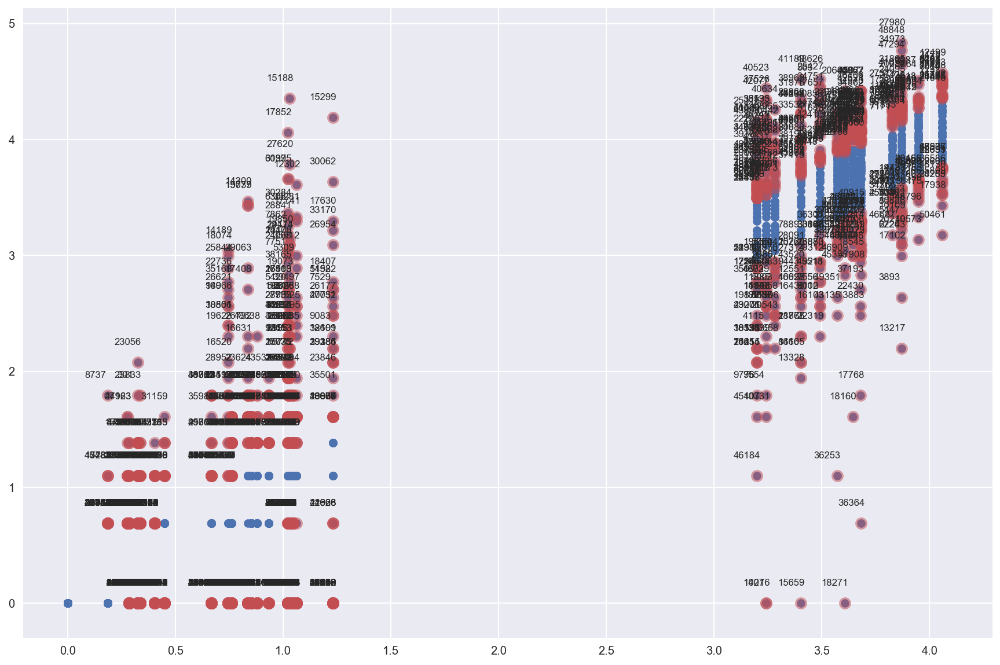

In [148]:
item_nbr_list_27 = get_item_nbr(df_27) #27번 store에서 팔린 item_nbr만 list로 저장

influence27 = result_model27.get_influence()

cooks_d2_27, pvals27 = influence27.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr27 = 4 / (len(df_27) - 778)
idx27 = np.where(cooks_d2_27 > fox_cr27)[0]

print(len(idx27)) #outlier 갯수

X27 = result_model27.predict(df_27)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X27, df_27['log_units'])
plt.scatter(X27[idx27], df_27.loc[idx27]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx27)), idx27, list(zip(X27[idx27], df_27.loc[idx27]['log_units'])),
                    [(-20, 15)] * len(idx27), size = "small", ax = ax)

plt.show()

In [149]:
for num in idx27 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_27 :
        if item_nbr == df_27.loc[num].item_nbr :
            mean = df_27[df_27['item_nbr'] == item_nbr]['log_units'].mean()
            df_27.set_value(num, 'log_units', mean)
            df_27.set_value(num, 'units', np.exp(mean) - 1)

model27_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_27)
result_model27_new = model27_new.fit()
print(result_model27_new.summary())

test_27_new = processed_test[processed_test['store_nbr'] == 27]

test_27_new['log_units'] = result_model27_new.predict(test_27_new)
test_27_new['units'] = np.exp(test_27_new['log_units']) - 1
result_test2.append(test_27_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                 2.220e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:59:44   Log-Likelihood:             1.1147e+05
No. Observations:               50505   AIC:                        -2.214e+05
Df Residuals:                   49728   BIC:                        -2.145e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [150]:
del X27, cooks_d2_27, cv27_1, cv27_2, cv27_3, cv27_4, cv27_5, cv27_test, cv27_train, df_27, fox_cr27, idx27, influence27, item_nbr_list_27, model27
del model27_new, model_cv27, pvals27, result_model27, result_model27_new, result_model_cv27, test_27, test_27_new

In [151]:
df_28 = processed_train[processed_train['store_nbr'] == 28].reset_index(drop = True)

model28 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_28)
result_model28 = model28.fit()
print(result_model28.summary())

test_28 = processed_test[processed_test['store_nbr'] == 28]

test_28['log_units'] = result_model28.predict(test_28)
test_28['units'] = np.exp(test_28['log_units']) - 1
result_test.append(test_28)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.962
Model:                            OLS   Adj. R-squared:                  0.962
Method:                 Least Squares   F-statistic:                     1627.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        18:59:59   Log-Likelihood:                 44346.
No. Observations:               50505   AIC:                        -8.714e+04
Df Residuals:                   49728   BIC:                        -8.028e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [152]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv28_1 = df_28[:10101]
cv28_2 = df_28[10101:20202]
cv28_3 = df_28[20202:30414]
cv28_4 = df_28[30414:40515]
cv28_5 = df_28[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv28_train = pd.concat([cv28_1, cv28_2, cv28_3, cv28_4], ignore_index = True)
cv28_test = cv28_5

model_cv28 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv28_train)
result_model_cv28 = model_cv28.fit()
print(result_model_cv28.summary())

cv28_test['log_units_cv'] = result_model_cv28.predict(cv28_test)
cv28_test['units_cv'] = np.exp(cv28_test['log_units_cv']) - 1

cv28_test['RMSLE'] = np.log((cv28_test['units_cv'] + 1) / (cv28_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv28_test['RMSLE']) / len(cv28_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.964
Model:                            OLS   Adj. R-squared:                  0.963
Method:                 Least Squares   F-statistic:                     1356.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:00:10   Log-Likelihood:                 36279.
No. Observations:               40515   AIC:                        -7.100e+04
Df Residuals:                   39738   BIC:                        -6.431e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.109534954221


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1327


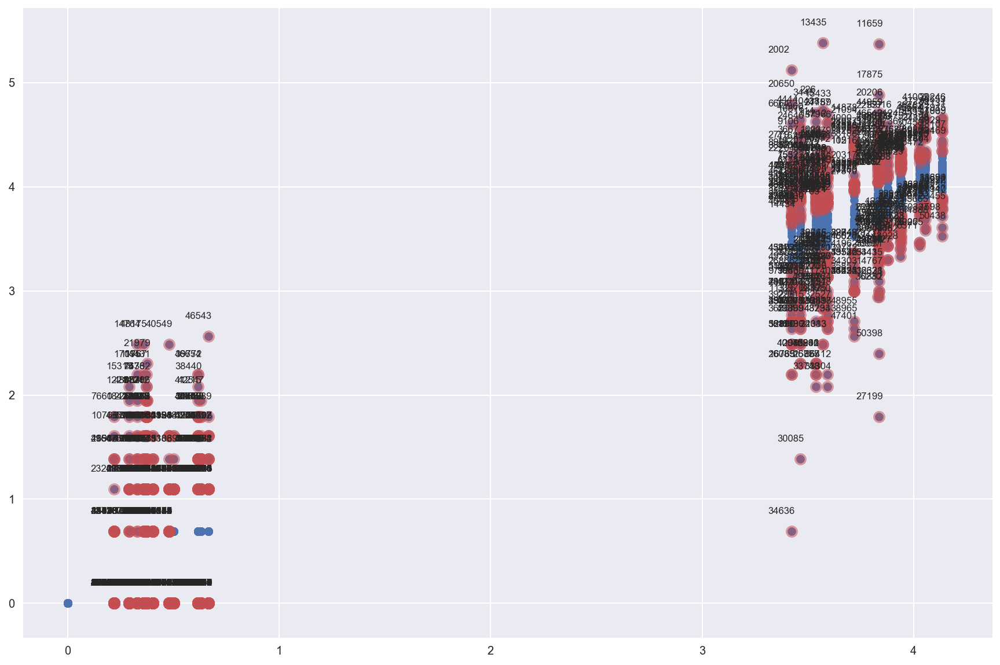

In [153]:
item_nbr_list_28 = get_item_nbr(df_28) #28번 store에서 팔린 item_nbr만 list로 저장

influence28 = result_model28.get_influence()

cooks_d2_28, pvals28 = influence28.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr28 = 4 / (len(df_28) - 778)
idx28 = np.where(cooks_d2_28 > fox_cr28)[0]

print(len(idx28)) #outlier 갯수

X28 = result_model28.predict(df_28)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X28, df_28['log_units'])
plt.scatter(X28[idx28], df_28.loc[idx28]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx28)), idx28, list(zip(X28[idx28], df_28.loc[idx28]['log_units'])),
                    [(-20, 15)] * len(idx28), size = "small", ax = ax)

plt.show()

In [154]:
for num in idx28 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_28 :
        if item_nbr == df_28.loc[num].item_nbr :
            mean = df_28[df_28['item_nbr'] == item_nbr]['log_units'].mean()
            df_28.set_value(num, 'log_units', mean)
            df_28.set_value(num, 'units', np.exp(mean) - 1)

model28_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_28)
result_model28_new = model28_new.fit()
print(result_model28_new.summary())

test_28_new = processed_test[processed_test['store_nbr'] == 28]

test_28_new['log_units'] = result_model28_new.predict(test_28_new)
test_28_new['units'] = np.exp(test_28_new['log_units']) - 1
result_test2.append(test_28_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 8.548e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:00:32   Log-Likelihood:             1.4455e+05
No. Observations:               50505   AIC:                        -2.875e+05
Df Residuals:                   49728   BIC:                        -2.807e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [155]:
del X28, cooks_d2_28, cv28_1, cv28_2, cv28_3, cv28_4, cv28_5, cv28_test, cv28_train, df_28, fox_cr28, idx28, influence28, item_nbr_list_28, model28
del model28_new, model_cv28, pvals28, result_model28, result_model28_new, result_model_cv28, test_28, test_28_new

In [156]:
df_29 = processed_train[processed_train['store_nbr'] == 29].reset_index(drop = True)

model29 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_29)
result_model29 = model29.fit()
print(result_model29.summary())

test_29 = processed_test[processed_test['store_nbr'] == 29]

test_29['log_units'] = result_model29.predict(test_29)
test_29['units'] = np.exp(test_29['log_units']) - 1
result_test.append(test_29)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.975
Model:                            OLS   Adj. R-squared:                  0.974
Method:                 Least Squares   F-statistic:                     2458.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:00:47   Log-Likelihood:                 46768.
No. Observations:               50505   AIC:                        -9.198e+04
Df Residuals:                   49728   BIC:                        -8.512e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [157]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv29_1 = df_29[:10101]
cv29_2 = df_29[10101:20202]
cv29_3 = df_29[20202:30414]
cv29_4 = df_29[30414:40515]
cv29_5 = df_29[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv29_train = pd.concat([cv29_1, cv29_2, cv29_3, cv29_4], ignore_index = True)
cv29_test = cv29_5

model_cv29 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv29_train)
result_model_cv29 = model_cv29.fit()
print(result_model_cv29.summary())

cv29_test['log_units_cv'] = result_model_cv29.predict(cv29_test)
cv29_test['units_cv'] = np.exp(cv29_test['log_units_cv']) - 1

cv29_test['RMSLE'] = np.log((cv29_test['units_cv'] + 1) / (cv29_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv29_test['RMSLE']) / len(cv29_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.974
Model:                            OLS   Adj. R-squared:                  0.974
Method:                 Least Squares   F-statistic:                     1949.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:00:59   Log-Likelihood:                 37230.
No. Observations:               40515   AIC:                        -7.291e+04
Df Residuals:                   39738   BIC:                        -6.622e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.0942685786954


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1199


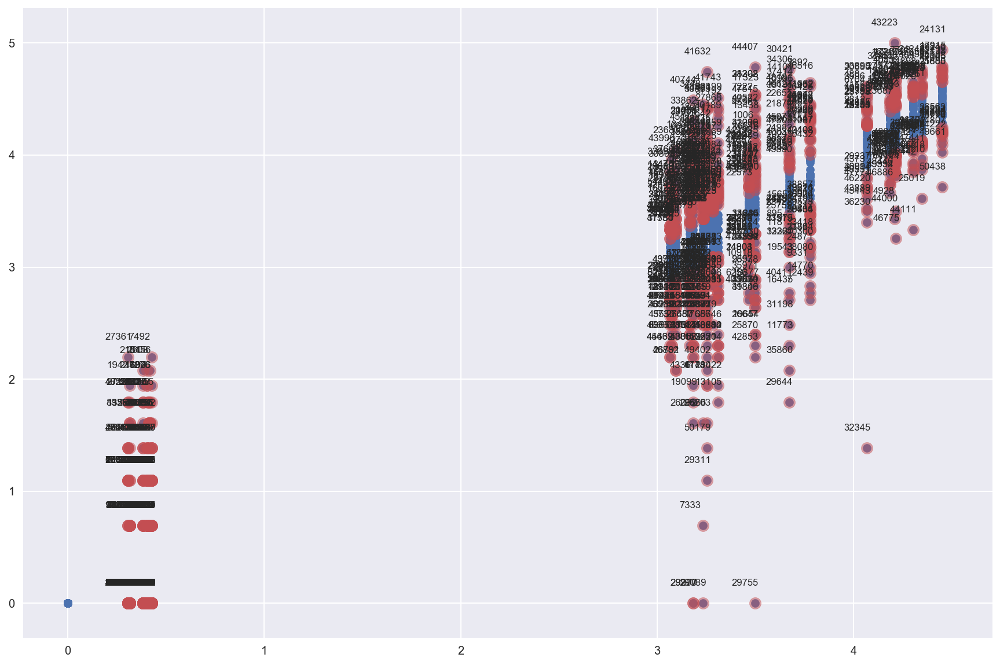

In [158]:
item_nbr_list_29 = get_item_nbr(df_29) #29번 store에서 팔린 item_nbr만 list로 저장

influence29 = result_model29.get_influence()

cooks_d2_29, pvals29 = influence29.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr29 = 4 / (len(df_29) - 778)
idx29 = np.where(cooks_d2_29 > fox_cr29)[0]

print(len(idx29)) #outlier 갯수

X29 = result_model29.predict(df_29)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X29, df_29['log_units'])
plt.scatter(X29[idx29], df_29.loc[idx29]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx29)), idx29, list(zip(X29[idx29], df_29.loc[idx29]['log_units'])),
                    [(-20, 15)] * len(idx29), size = "small", ax = ax)

plt.show()

In [159]:
for num in idx29 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_29 :
        if item_nbr == df_29.loc[num].item_nbr :
            mean = df_29[df_29['item_nbr'] == item_nbr]['log_units'].mean()
            df_29.set_value(num, 'log_units', mean)
            df_29.set_value(num, 'units', np.exp(mean) - 1)

model29_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_29)
result_model29_new = model29_new.fit()
print(result_model29_new.summary())

test_29_new = processed_test[processed_test['store_nbr'] == 29]

test_29_new['log_units'] = result_model29_new.predict(test_29_new)
test_29_new['units'] = np.exp(test_29_new['log_units']) - 1
result_test2.append(test_29_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 7.568e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:01:19   Log-Likelihood:             1.3327e+05
No. Observations:               50505   AIC:                        -2.650e+05
Df Residuals:                   49728   BIC:                        -2.581e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [160]:
del X29, cooks_d2_29, cv29_1, cv29_2, cv29_3, cv29_4, cv29_5, cv29_test, cv29_train, df_29, fox_cr29, idx29, influence29, item_nbr_list_29, model29
del model29_new, model_cv29, pvals29, result_model29, result_model29_new, result_model_cv29, test_29, test_29_new

In [161]:
df_30 = processed_train[processed_train['store_nbr'] == 30].reset_index(drop = True)

model30 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_30)
result_model30 = model30.fit()
print(result_model30.summary())

test_30 = processed_test[processed_test['store_nbr'] == 30]

test_30['log_units'] = result_model30.predict(test_30)
test_30['units'] = np.exp(test_30['log_units']) - 1
result_test.append(test_30)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.972
Model:                            OLS   Adj. R-squared:                  0.972
Method:                 Least Squares   F-statistic:                     2242.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:01:34   Log-Likelihood:                 42315.
No. Observations:               50505   AIC:                        -8.308e+04
Df Residuals:                   49728   BIC:                        -7.621e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [162]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv30_1 = df_30[:10101]
cv30_2 = df_30[10101:20202]
cv30_3 = df_30[20202:30414]
cv30_4 = df_30[30414:40515]
cv30_5 = df_30[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv30_train = pd.concat([cv30_1, cv30_2, cv30_3, cv30_4], ignore_index = True)
cv30_test = cv30_5

model_cv30 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv30_train)
result_model_cv30 = model_cv30.fit()
print(result_model_cv30.summary())

cv30_test['log_units_cv'] = result_model_cv30.predict(cv30_test)
cv30_test['units_cv'] = np.exp(cv30_test['log_units_cv']) - 1

cv30_test['RMSLE'] = np.log((cv30_test['units_cv'] + 1) / (cv30_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv30_test['RMSLE']) / len(cv30_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.974
Model:                            OLS   Adj. R-squared:                  0.973
Method:                 Least Squares   F-statistic:                     1916.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:01:46   Log-Likelihood:                 35241.
No. Observations:               40515   AIC:                        -6.893e+04
Df Residuals:                   39738   BIC:                        -6.224e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.119798933788


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1567


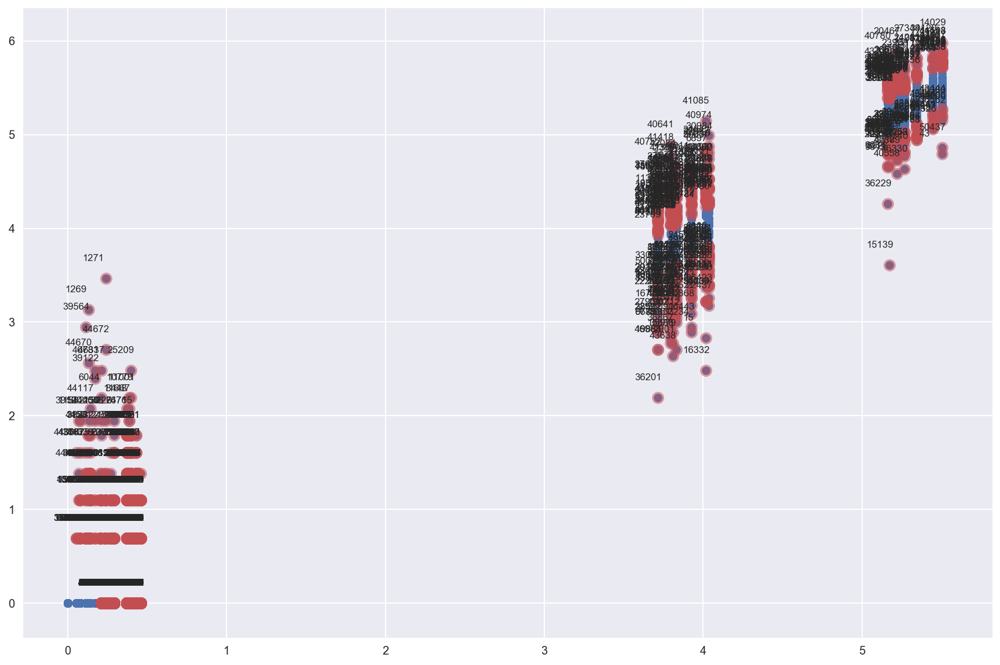

In [163]:
item_nbr_list_30 = get_item_nbr(df_30) #30번 store에서 팔린 item_nbr만 list로 저장

influence30 = result_model30.get_influence()

cooks_d2_30, pvals30 = influence30.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr30 = 4 / (len(df_30) - 778)
idx30 = np.where(cooks_d2_30 > fox_cr30)[0]

print(len(idx30)) #outlier 갯수

X30 = result_model30.predict(df_30)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X30, df_30['log_units'])
plt.scatter(X30[idx30], df_30.loc[idx30]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx30)), idx30, list(zip(X30[idx30], df_30.loc[idx30]['log_units'])),
                    [(-20, 15)] * len(idx30), size = "small", ax = ax)

plt.show()

In [164]:
for num in idx30 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_30 :
        if item_nbr == df_30.loc[num].item_nbr :
            mean = df_30[df_30['item_nbr'] == item_nbr]['log_units'].mean()
            df_30.set_value(num, 'log_units', mean)
            df_30.set_value(num, 'units', np.exp(mean) - 1)

model30_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_30)
result_model30_new = model30_new.fit()
print(result_model30_new.summary())

test_30_new = processed_test[processed_test['store_nbr'] == 30]

test_30_new['log_units'] = result_model30_new.predict(test_30_new)
test_30_new['units'] = np.exp(test_30_new['log_units']) - 1
result_test2.append(test_30_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 9.530e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:02:08   Log-Likelihood:             1.3718e+05
No. Observations:               50505   AIC:                        -2.728e+05
Df Residuals:                   49728   BIC:                        -2.659e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [165]:
del X30, cooks_d2_30, cv30_1, cv30_2, cv30_3, cv30_4, cv30_5, cv30_test, cv30_train, df_30, fox_cr30, idx30, influence30, item_nbr_list_30, model30
del model30_new, model_cv30, pvals30, result_model30, result_model30_new, result_model_cv30, test_30, test_30_new

In [166]:
df_31 = processed_train[processed_train['store_nbr'] == 31].reset_index(drop = True)

model31 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_31)
result_model31 = model31.fit()
print(result_model31.summary())

test_31 = processed_test[processed_test['store_nbr'] == 31]

test_31['log_units'] = result_model31.predict(test_31)
test_31['units'] = np.exp(test_31['log_units']) - 1
result_test.append(test_31)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.932
Model:                            OLS   Adj. R-squared:                  0.931
Method:                 Least Squares   F-statistic:                     879.8
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:02:23   Log-Likelihood:                 23231.
No. Observations:               50505   AIC:                        -4.491e+04
Df Residuals:                   49728   BIC:                        -3.805e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [167]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv31_1 = df_31[:10101]
cv31_2 = df_31[10101:20202]
cv31_3 = df_31[20202:30414]
cv31_4 = df_31[30414:40515]
cv31_5 = df_31[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv31_train = pd.concat([cv31_1, cv31_2, cv31_3, cv31_4], ignore_index = True)
cv31_test = cv31_5

model_cv31 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv31_train)
result_model_cv31 = model_cv31.fit()
print(result_model_cv31.summary())

cv31_test['log_units_cv'] = result_model_cv31.predict(cv31_test)
cv31_test['units_cv'] = np.exp(cv31_test['log_units_cv']) - 1

cv31_test['RMSLE'] = np.log((cv31_test['units_cv'] + 1) / (cv31_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv31_test['RMSLE']) / len(cv31_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.932
Model:                            OLS   Adj. R-squared:                  0.930
Method:                 Least Squares   F-statistic:                     696.4
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:02:35   Log-Likelihood:                 18690.
No. Observations:               40515   AIC:                        -3.583e+04
Df Residuals:                   39738   BIC:                        -2.914e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.166197526016


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1306


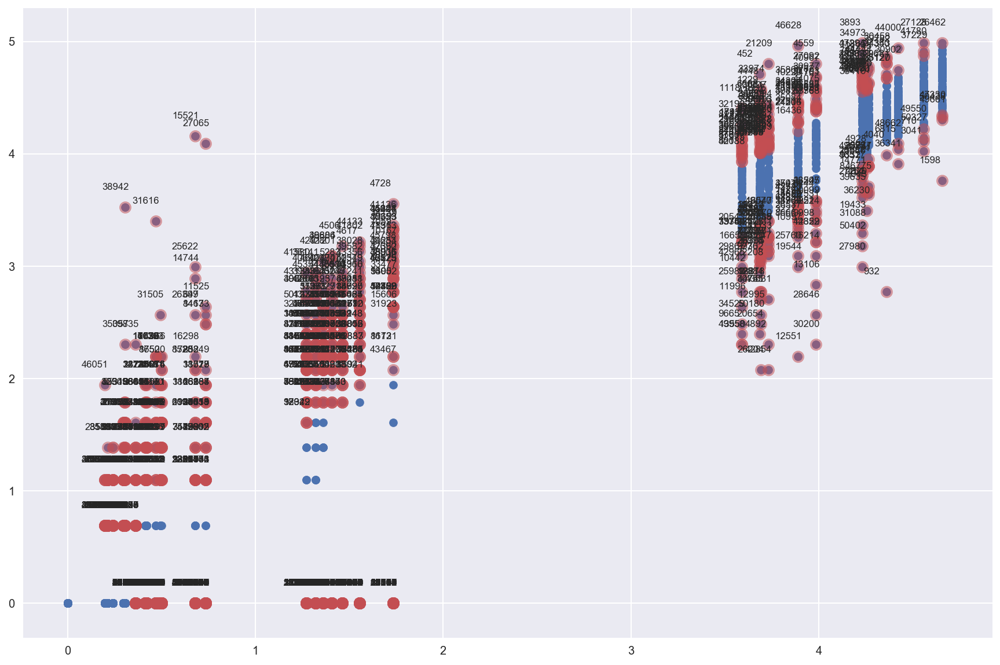

In [168]:
item_nbr_list_31 = get_item_nbr(df_31) #31번 store에서 팔린 item_nbr만 list로 저장

influence31 = result_model31.get_influence()

cooks_d2_31, pvals31 = influence31.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr31 = 4 / (len(df_31) - 778)
idx31 = np.where(cooks_d2_31 > fox_cr31)[0]

print(len(idx31)) #outlier 갯수

X31 = result_model31.predict(df_31)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X31, df_31['log_units'])
plt.scatter(X31[idx31], df_31.loc[idx31]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx31)), idx31, list(zip(X31[idx31], df_31.loc[idx31]['log_units'])),
                    [(-20, 15)] * len(idx31), size = "small", ax = ax)

plt.show()

In [169]:
for num in idx31 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_31 :
        if item_nbr == df_31.loc[num].item_nbr :
            mean = df_31[df_31['item_nbr'] == item_nbr]['log_units'].mean()
            df_31.set_value(num, 'log_units', mean)
            df_31.set_value(num, 'units', np.exp(mean) - 1)

model31_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_31)
result_model31_new = model31_new.fit()
print(result_model31_new.summary())

test_31_new = processed_test[processed_test['store_nbr'] == 31]

test_31_new['log_units'] = result_model31_new.predict(test_31_new)
test_31_new['units'] = np.exp(test_31_new['log_units']) - 1
result_test2.append(test_31_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                 2.373e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:02:56   Log-Likelihood:             1.0595e+05
No. Observations:               50505   AIC:                        -2.103e+05
Df Residuals:                   49728   BIC:                        -2.035e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [170]:
del X31, cooks_d2_31, cv31_1, cv31_2, cv31_3, cv31_4, cv31_5, cv31_test, cv31_train, df_31, fox_cr31, idx31, influence31, item_nbr_list_31, model31
del model31_new, model_cv31, pvals31, result_model31, result_model31_new, result_model_cv31, test_31, test_31_new

In [171]:
df_32 = processed_train[processed_train['store_nbr'] == 32].reset_index(drop = True)

model32 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_32)
result_model32 = model32.fit()
print(result_model32.summary())

test_32 = processed_test[processed_test['store_nbr'] == 32]

test_32['log_units'] = result_model32.predict(test_32)
test_32['units'] = np.exp(test_32['log_units']) - 1
result_test.append(test_32)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.920
Model:                            OLS   Adj. R-squared:                  0.919
Method:                 Least Squares   F-statistic:                     739.0
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:03:11   Log-Likelihood:                 23939.
No. Observations:               50505   AIC:                        -4.632e+04
Df Residuals:                   49728   BIC:                        -3.946e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [172]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv32_1 = df_32[:10101]
cv32_2 = df_32[10101:20202]
cv32_3 = df_32[20202:30414]
cv32_4 = df_32[30414:40515]
cv32_5 = df_32[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv32_train = pd.concat([cv32_1, cv32_2, cv32_3, cv32_4], ignore_index = True)
cv32_test = cv32_5

model_cv32 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv32_train)
result_model_cv32 = model_cv32.fit()
print(result_model_cv32.summary())

cv32_test['log_units_cv'] = result_model_cv32.predict(cv32_test)
cv32_test['units_cv'] = np.exp(cv32_test['log_units_cv']) - 1

cv32_test['RMSLE'] = np.log((cv32_test['units_cv'] + 1) / (cv32_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv32_test['RMSLE']) / len(cv32_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.918
Model:                            OLS   Adj. R-squared:                  0.916
Method:                 Least Squares   F-statistic:                     571.3
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:03:22   Log-Likelihood:                 18548.
No. Observations:               40515   AIC:                        -3.554e+04
Df Residuals:                   39738   BIC:                        -2.885e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.143460782589


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1701


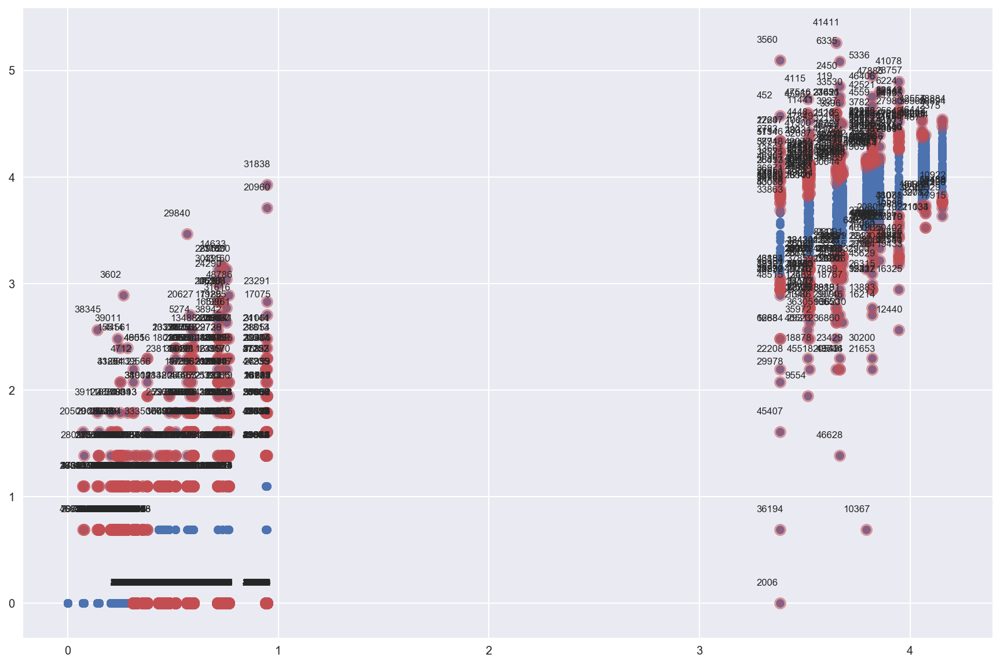

In [173]:
item_nbr_list_32 = get_item_nbr(df_32) #32번 store에서 팔린 item_nbr만 list로 저장

influence32 = result_model32.get_influence()

cooks_d2_32, pvals32 = influence32.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr32 = 4 / (len(df_32) - 778)
idx32 = np.where(cooks_d2_32 > fox_cr32)[0]

print(len(idx32)) #outlier 갯수

X32 = result_model32.predict(df_32)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X32, df_32['log_units'])
plt.scatter(X32[idx32], df_32.loc[idx32]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx32)), idx32, list(zip(X32[idx32], df_32.loc[idx32]['log_units'])),
                    [(-20, 15)] * len(idx32), size = "small", ax = ax)

plt.show()

In [174]:
for num in idx32 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_32 :
        if item_nbr == df_32.loc[num].item_nbr :
            mean = df_32[df_32['item_nbr'] == item_nbr]['log_units'].mean()
            df_32.set_value(num, 'log_units', mean)
            df_32.set_value(num, 'units', np.exp(mean) - 1)

model32_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_32)
result_model32_new = model32_new.fit()
print(result_model32_new.summary())

test_32_new = processed_test[processed_test['store_nbr'] == 32]

test_32_new['log_units'] = result_model32_new.predict(test_32_new)
test_32_new['units'] = np.exp(test_32_new['log_units']) - 1
result_test2.append(test_32_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.997
Model:                            OLS   Adj. R-squared:                  0.997
Method:                 Least Squares   F-statistic:                 2.427e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:03:46   Log-Likelihood:             1.1199e+05
No. Observations:               50505   AIC:                        -2.224e+05
Df Residuals:                   49728   BIC:                        -2.156e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [175]:
del X32, cooks_d2_32, cv32_1, cv32_2, cv32_3, cv32_4, cv32_5, cv32_test, cv32_train, df_32, fox_cr32, idx32, influence32, item_nbr_list_32, model32
del model32_new, model_cv32, pvals32, result_model32, result_model32_new, result_model_cv32, test_32, test_32_new

In [176]:
df_33 = processed_train[processed_train['store_nbr'] == 33].reset_index(drop = True)

model33 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_33)
result_model33 = model33.fit()
print(result_model33.summary())

test_33 = processed_test[processed_test['store_nbr'] == 33]

test_33['log_units'] = result_model33.predict(test_33)
test_33['units'] = np.exp(test_33['log_units']) - 1
result_test.append(test_33)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.978
Model:                            OLS   Adj. R-squared:                  0.978
Method:                 Least Squares   F-statistic:                     2884.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:04:01   Log-Likelihood:                 44934.
No. Observations:               50505   AIC:                        -8.831e+04
Df Residuals:                   49728   BIC:                        -8.145e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [177]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv33_1 = df_33[:10101]
cv33_2 = df_33[10101:20202]
cv33_3 = df_33[20202:30414]
cv33_4 = df_33[30414:40515]
cv33_5 = df_33[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv33_train = pd.concat([cv33_1, cv33_2, cv33_3, cv33_4], ignore_index = True)
cv33_test = cv33_5

model_cv33 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv33_train)
result_model_cv33 = model_cv33.fit()
print(result_model_cv33.summary())

cv33_test['log_units_cv'] = result_model_cv33.predict(cv33_test)
cv33_test['units_cv'] = np.exp(cv33_test['log_units_cv']) - 1

cv33_test['RMSLE'] = np.log((cv33_test['units_cv'] + 1) / (cv33_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv33_test['RMSLE']) / len(cv33_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.979
Model:                            OLS   Adj. R-squared:                  0.978
Method:                 Least Squares   F-statistic:                     2353.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:04:12   Log-Likelihood:                 36202.
No. Observations:               40515   AIC:                        -7.085e+04
Df Residuals:                   39738   BIC:                        -6.416e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.105190286696


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1254


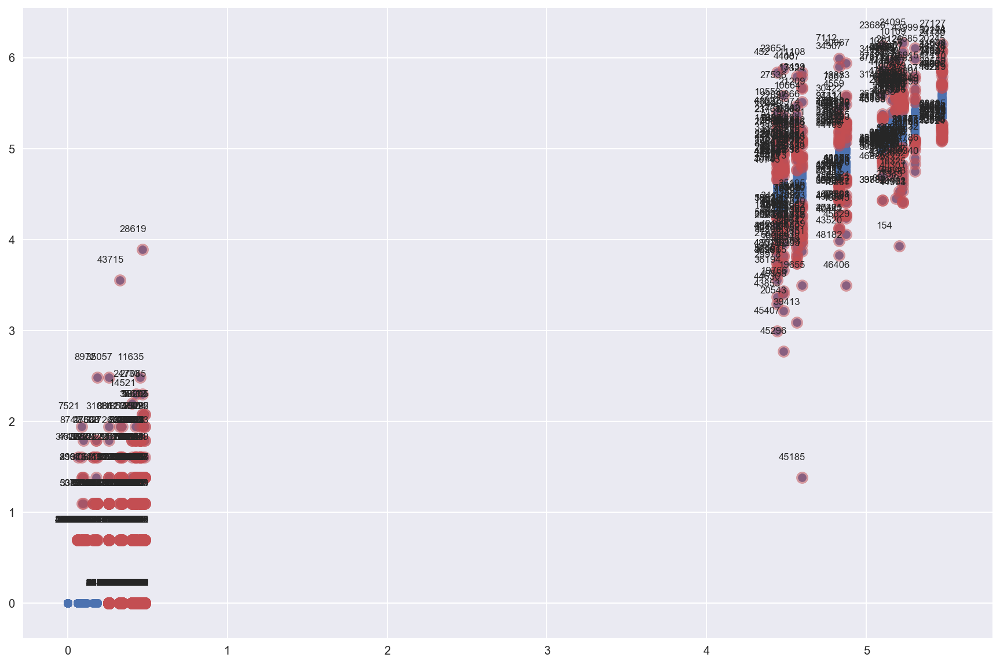

In [178]:
item_nbr_list_33 = get_item_nbr(df_33) #33번 store에서 팔린 item_nbr만 list로 저장

influence33 = result_model33.get_influence()

cooks_d2_33, pvals33 = influence33.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr33 = 4 / (len(df_33) - 778)
idx33 = np.where(cooks_d2_33 > fox_cr33)[0]

print(len(idx33)) #outlier 갯수

X33 = result_model33.predict(df_33)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X33, df_33['log_units'])
plt.scatter(X33[idx33], df_33.loc[idx33]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx33)), idx33, list(zip(X33[idx33], df_33.loc[idx33]['log_units'])),
                    [(-20, 15)] * len(idx33), size = "small", ax = ax)

plt.show()

In [179]:
for num in idx33 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_33 :
        if item_nbr == df_33.loc[num].item_nbr :
            mean = df_33[df_33['item_nbr'] == item_nbr]['log_units'].mean()
            df_33.set_value(num, 'log_units', mean)
            df_33.set_value(num, 'units', np.exp(mean) - 1)

model33_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_33)
result_model33_new = model33_new.fit()
print(result_model33_new.summary())

test_33_new = processed_test[processed_test['store_nbr'] == 33]

test_33_new['log_units'] = result_model33_new.predict(test_33_new)
test_33_new['units'] = np.exp(test_33_new['log_units']) - 1
result_test2.append(test_33_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 7.297e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:04:33   Log-Likelihood:             1.2668e+05
No. Observations:               50505   AIC:                        -2.518e+05
Df Residuals:                   49728   BIC:                        -2.449e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [180]:
del X33, cooks_d2_33, cv33_1, cv33_2, cv33_3, cv33_4, cv33_5, cv33_test, cv33_train, df_33, fox_cr33, idx33, influence33, item_nbr_list_33, model33
del model33_new, model_cv33, pvals33, result_model33, result_model33_new, result_model_cv33, test_33, test_33_new

In [181]:
df_34 = processed_train[processed_train['store_nbr'] == 34].reset_index(drop = True)

model34 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_34)
result_model34 = model34.fit()
print(result_model34.summary())

test_34 = processed_test[processed_test['store_nbr'] == 34]

test_34['log_units'] = result_model34.predict(test_34)
test_34['units'] = np.exp(test_34['log_units']) - 1
result_test.append(test_34)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.964
Model:                            OLS   Adj. R-squared:                  0.963
Method:                 Least Squares   F-statistic:                     1709.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:04:48   Log-Likelihood:                 39428.
No. Observations:               50505   AIC:                        -7.730e+04
Df Residuals:                   49728   BIC:                        -7.044e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [182]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv34_1 = df_34[:10101]
cv34_2 = df_34[10101:20202]
cv34_3 = df_34[20202:30414]
cv34_4 = df_34[30414:40515]
cv34_5 = df_34[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv34_train = pd.concat([cv34_1, cv34_2, cv34_3, cv34_4], ignore_index = True)
cv34_test = cv34_5

model_cv34 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv34_train)
result_model_cv34 = model_cv34.fit()
print(result_model_cv34.summary())

cv34_test['log_units_cv'] = result_model_cv34.predict(cv34_test)
cv34_test['units_cv'] = np.exp(cv34_test['log_units_cv']) - 1

cv34_test['RMSLE'] = np.log((cv34_test['units_cv'] + 1) / (cv34_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv34_test['RMSLE']) / len(cv34_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.963
Model:                            OLS   Adj. R-squared:                  0.962
Method:                 Least Squares   F-statistic:                     1318.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:04:59   Log-Likelihood:                 30919.
No. Observations:               40515   AIC:                        -6.028e+04
Df Residuals:                   39738   BIC:                        -5.360e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.104655380652


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1516


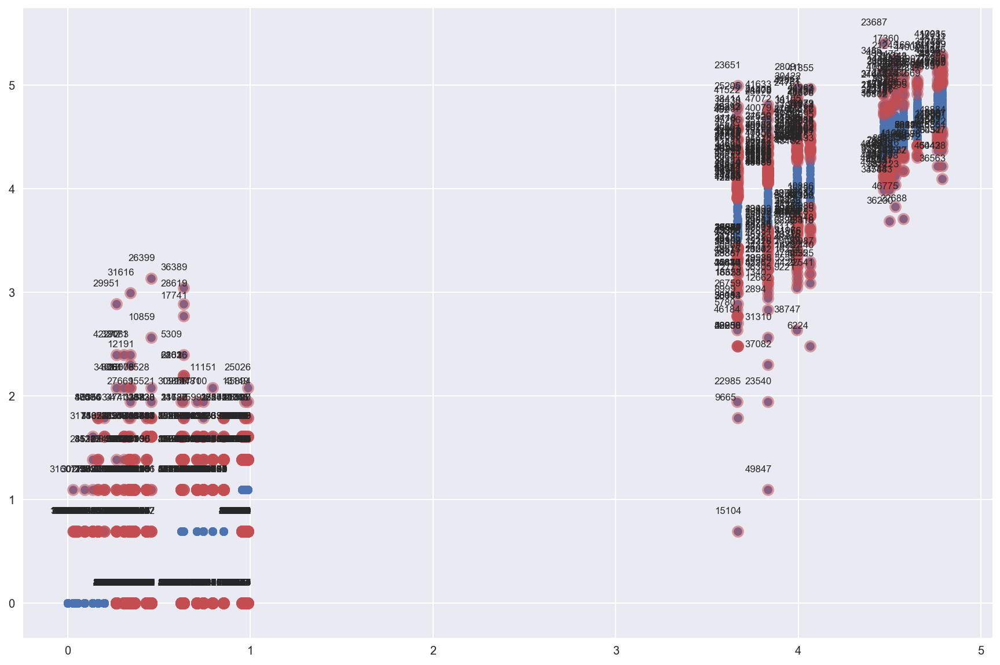

In [183]:
item_nbr_list_34 = get_item_nbr(df_34) #34번 store에서 팔린 item_nbr만 list로 저장

influence34 = result_model34.get_influence()

cooks_d2_34, pvals34 = influence34.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr34 = 4 / (len(df_34) - 778)
idx34 = np.where(cooks_d2_34 > fox_cr34)[0]

print(len(idx34)) #outlier 갯수

X34 = result_model34.predict(df_34)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X34, df_34['log_units'])
plt.scatter(X34[idx34], df_34.loc[idx34]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx34)), idx34, list(zip(X34[idx34], df_34.loc[idx34]['log_units'])),
                    [(-20, 15)] * len(idx34), size = "small", ax = ax)

plt.show()

In [184]:
for num in idx34 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_34 :
        if item_nbr == df_34.loc[num].item_nbr :
            mean = df_34[df_34['item_nbr'] == item_nbr]['log_units'].mean()
            df_34.set_value(num, 'log_units', mean)
            df_34.set_value(num, 'units', np.exp(mean) - 1)

model34_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_34)
result_model34_new = model34_new.fit()
print(result_model34_new.summary())

test_34_new = processed_test[processed_test['store_nbr'] == 34]

test_34_new['log_units'] = result_model34_new.predict(test_34_new)
test_34_new['units'] = np.exp(test_34_new['log_units']) - 1
result_test2.append(test_34_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 5.519e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:05:22   Log-Likelihood:             1.2720e+05
No. Observations:               50505   AIC:                        -2.529e+05
Df Residuals:                   49728   BIC:                        -2.460e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [185]:
del X34, cooks_d2_34, cv34_1, cv34_2, cv34_3, cv34_4, cv34_5, cv34_test, cv34_train, df_34, fox_cr34, idx34, influence34, item_nbr_list_34, model34
del model34_new, model_cv34, pvals34, result_model34, result_model34_new, result_model_cv34, test_34, test_34_new

In [186]:
df_35 = processed_train[processed_train['store_nbr'] == 35].reset_index(drop = True)

model35 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_35)
result_model35 = model35.fit()
print(result_model35.summary())

test_35 = processed_test[processed_test['store_nbr'] == 35]

test_35['log_units'] = result_model35.predict(test_35)
test_35['units'] = np.exp(test_35['log_units']) - 1
result_test.append(test_35)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.851
Model:                            OLS   Adj. R-squared:                  0.848
Method:                 Least Squares   F-statistic:                     242.7
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:05:31   Log-Likelihood:                 12701.
No. Observations:               33633   AIC:                        -2.385e+04
Df Residuals:                   32856   BIC:                        -1.730e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

In [187]:
# Cross Validation

# 35번 store는 5번 station인데 5번 station은 2012년 6월부터 등장함
# 총 10개월.. 2개월씩 5등분
cv35_1 = df_35[:6771]
cv35_2 = df_35[6771:13542]
cv35_3 = df_35[13542:20313]
cv35_4 = df_35[20313:27084]
cv35_5 = df_35[27084:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv35_train = pd.concat([cv35_1, cv35_2, cv35_3, cv35_4], ignore_index = True)
cv35_test = cv35_5

model_cv35 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv35_train)
result_model_cv35 = model_cv35.fit()
print(result_model_cv35.summary())

cv35_test['log_units_cv'] = result_model_cv35.predict(cv35_test)
cv35_test['units_cv'] = np.exp(cv35_test['log_units_cv']) - 1

cv35_test['RMSLE'] = np.log((cv35_test['units_cv'] + 1) / (cv35_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv35_test['RMSLE']) / len(cv35_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.883
Model:                            OLS   Adj. R-squared:                  0.880
Method:                 Least Squares   F-statistic:                     255.9
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:05:39   Log-Likelihood:                 14271.
No. Observations:               27084   AIC:                        -2.699e+04
Df Residuals:                   26307   BIC:                        -2.061e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.252470432042


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1022


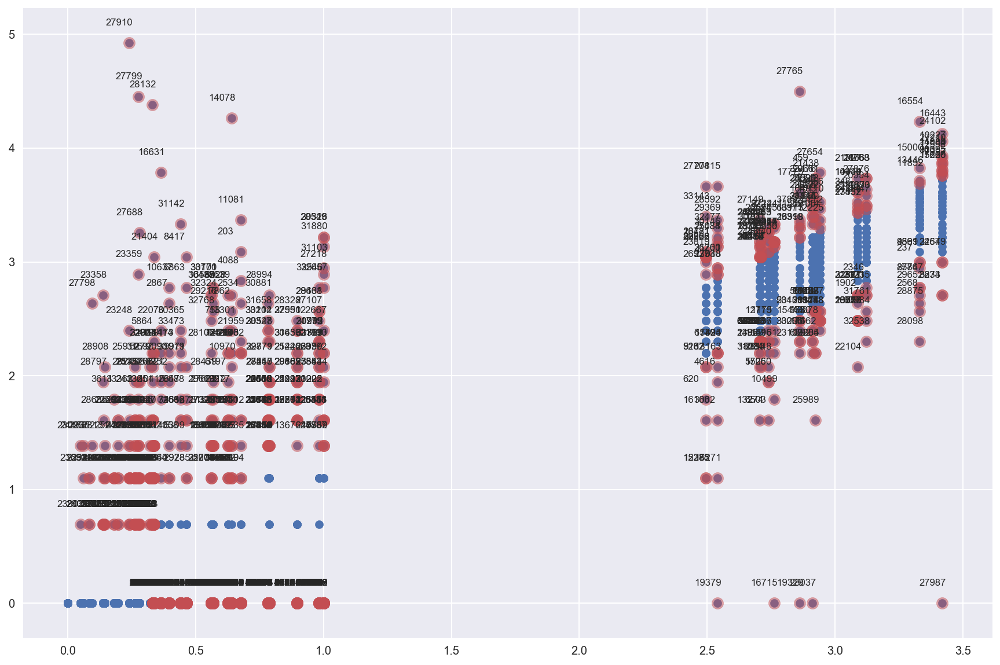

In [188]:
item_nbr_list_35 = get_item_nbr(df_35) #35번 store에서 팔린 item_nbr만 list로 저장

influence35 = result_model35.get_influence()

cooks_d2_35, pvals35 = influence35.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr35 = 4 / (len(df_35) - 778)
idx35 = np.where(cooks_d2_35 > fox_cr35)[0]

print(len(idx35)) #outlier 갯수

X35 = result_model35.predict(df_35)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X35, df_35['log_units'])
plt.scatter(X35[idx35], df_35.loc[idx35]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx35)), idx35, list(zip(X35[idx35], df_35.loc[idx35]['log_units'])),
                    [(-20, 15)] * len(idx35), size = "small", ax = ax)

plt.show()

In [189]:
for num in idx35 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_35 :
        if item_nbr == df_35.loc[num].item_nbr :
            mean = df_35[df_35['item_nbr'] == item_nbr]['log_units'].mean()
            df_35.set_value(num, 'log_units', mean)
            df_35.set_value(num, 'units', np.exp(mean) - 1)

model35_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_35)
result_model35_new = model35_new.fit()
print(result_model35_new.summary())

test_35_new = processed_test[processed_test['store_nbr'] == 35]

test_35_new['log_units'] = result_model35_new.predict(test_35_new)
test_35_new['units'] = np.exp(test_35_new['log_units']) - 1
result_test2.append(test_35_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.994
Model:                            OLS   Adj. R-squared:                  0.994
Method:                 Least Squares   F-statistic:                     7012.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:05:54   Log-Likelihood:                 68763.
No. Observations:               33633   AIC:                        -1.360e+05
Df Residuals:                   32856   BIC:                        -1.294e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

In [190]:
del X35, cooks_d2_35, cv35_1, cv35_2, cv35_3, cv35_4, cv35_5, cv35_test, cv35_train, df_35, fox_cr35, idx35, influence35, item_nbr_list_35, model35
del model35_new, model_cv35, pvals35, result_model35, result_model35_new, result_model_cv35, test_35, test_35_new

In [191]:
df_36 = processed_train[processed_train['store_nbr'] == 36].reset_index(drop = True)

model36 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_36)
result_model36 = model36.fit()
print(result_model36.summary())

test_36 = processed_test[processed_test['store_nbr'] == 36]

test_36['log_units'] = result_model36.predict(test_36)
test_36['units'] = np.exp(test_36['log_units']) - 1
result_test.append(test_36)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.965
Model:                            OLS   Adj. R-squared:                  0.964
Method:                 Least Squares   F-statistic:                     1766.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:06:09   Log-Likelihood:                 43817.
No. Observations:               50505   AIC:                        -8.608e+04
Df Residuals:                   49728   BIC:                        -7.922e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [192]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv36_1 = df_36[:10101]
cv36_2 = df_36[10101:20202]
cv36_3 = df_36[20202:30414]
cv36_4 = df_36[30414:40515]
cv36_5 = df_36[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv36_train = pd.concat([cv36_1, cv36_2, cv36_3, cv36_4], ignore_index = True)
cv36_test = cv36_5

model_cv36 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv36_train)
result_model_cv36 = model_cv36.fit()
print(result_model_cv36.summary())

cv36_test['log_units_cv'] = result_model_cv36.predict(cv36_test)
cv36_test['units_cv'] = np.exp(cv36_test['log_units_cv']) - 1

cv36_test['RMSLE'] = np.log((cv36_test['units_cv'] + 1) / (cv36_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv36_test['RMSLE']) / len(cv36_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.967
Model:                            OLS   Adj. R-squared:                  0.966
Method:                 Least Squares   F-statistic:                     1495.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:06:20   Log-Likelihood:                 35786.
No. Observations:               40515   AIC:                        -7.002e+04
Df Residuals:                   39738   BIC:                        -6.333e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.109889718769


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1332


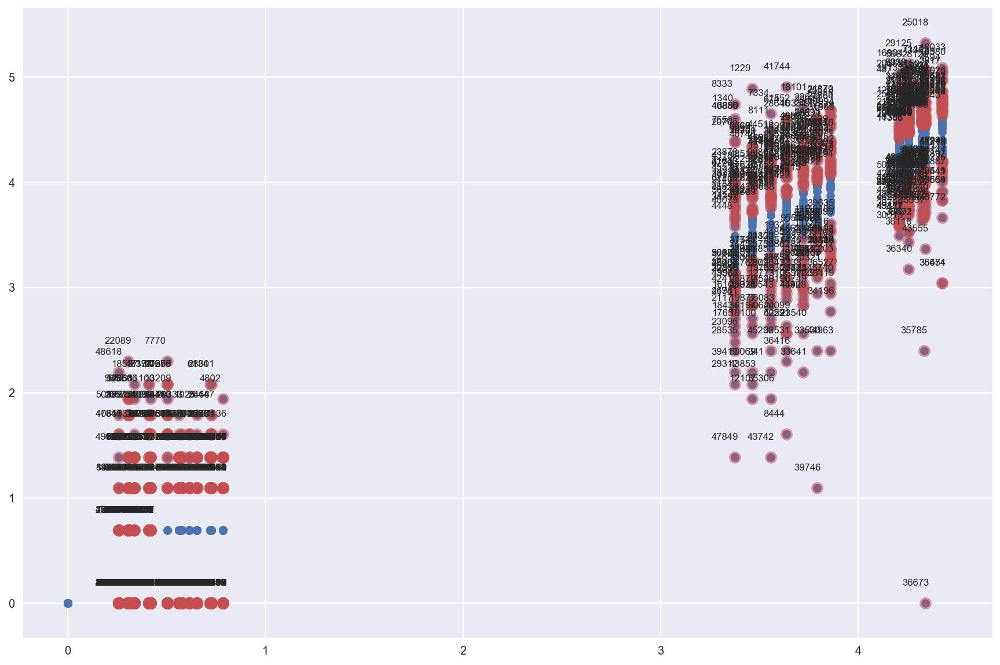

In [193]:
item_nbr_list_36 = get_item_nbr(df_36) #36번 store에서 팔린 item_nbr만 list로 저장

influence36 = result_model36.get_influence()

cooks_d2_36, pvals36 = influence36.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr36 = 4 / (len(df_36) - 778)
idx36 = np.where(cooks_d2_36 > fox_cr36)[0]

print(len(idx36)) #outlier 갯수

X36 = result_model36.predict(df_36)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X36, df_36['log_units'])
plt.scatter(X36[idx36], df_36.loc[idx36]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx36)), idx36, list(zip(X36[idx36], df_36.loc[idx36]['log_units'])),
                    [(-20, 15)] * len(idx36), size = "small", ax = ax)

plt.show()

In [194]:
for num in idx36 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_36 :
        if item_nbr == df_36.loc[num].item_nbr :
            mean = df_36[df_36['item_nbr'] == item_nbr]['log_units'].mean()
            df_36.set_value(num, 'log_units', mean)
            df_36.set_value(num, 'units', np.exp(mean) - 1)

model36_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_36)
result_model36_new = model36_new.fit()
print(result_model36_new.summary())

test_36_new = processed_test[processed_test['store_nbr'] == 36]

test_36_new['log_units'] = result_model36_new.predict(test_36_new)
test_36_new['units'] = np.exp(test_36_new['log_units']) - 1
result_test2.append(test_36_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 7.751e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:06:41   Log-Likelihood:             1.3979e+05
No. Observations:               50505   AIC:                        -2.780e+05
Df Residuals:                   49728   BIC:                        -2.712e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [195]:
del X36, cooks_d2_36, cv36_1, cv36_2, cv36_3, cv36_4, cv36_5, cv36_test, cv36_train, df_36, fox_cr36, idx36, influence36, item_nbr_list_36, model36
del model36_new, model_cv36, pvals36, result_model36, result_model36_new, result_model_cv36, test_36, test_36_new

In [196]:
df_37 = processed_train[processed_train['store_nbr'] == 37].reset_index(drop = True)

model37 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_37)
result_model37 = model37.fit()
print(result_model37.summary())

test_37 = processed_test[processed_test['store_nbr'] == 37]

test_37['log_units'] = result_model37.predict(test_37)
test_37['units'] = np.exp(test_37['log_units']) - 1
result_test.append(test_37)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.971
Model:                            OLS   Adj. R-squared:                  0.970
Method:                 Least Squares   F-statistic:                     2124.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:06:56   Log-Likelihood:                 49565.
No. Observations:               50505   AIC:                        -9.758e+04
Df Residuals:                   49728   BIC:                        -9.072e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [197]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv37_1 = df_37[:10101]
cv37_2 = df_37[10101:20202]
cv37_3 = df_37[20202:30414]
cv37_4 = df_37[30414:40515]
cv37_5 = df_37[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv37_train = pd.concat([cv37_1, cv37_2, cv37_3, cv37_4], ignore_index = True)
cv37_test = cv37_5

model_cv37 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv37_train)
result_model_cv37 = model_cv37.fit()
print(result_model_cv37.summary())

cv37_test['log_units_cv'] = result_model_cv37.predict(cv37_test)
cv37_test['units_cv'] = np.exp(cv37_test['log_units_cv']) - 1

cv37_test['RMSLE'] = np.log((cv37_test['units_cv'] + 1) / (cv37_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv37_test['RMSLE']) / len(cv37_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.972
Model:                            OLS   Adj. R-squared:                  0.972
Method:                 Least Squares   F-statistic:                     1802.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:07:07   Log-Likelihood:                 40654.
No. Observations:               40515   AIC:                        -7.975e+04
Df Residuals:                   39738   BIC:                        -7.306e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.100675884516


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1177


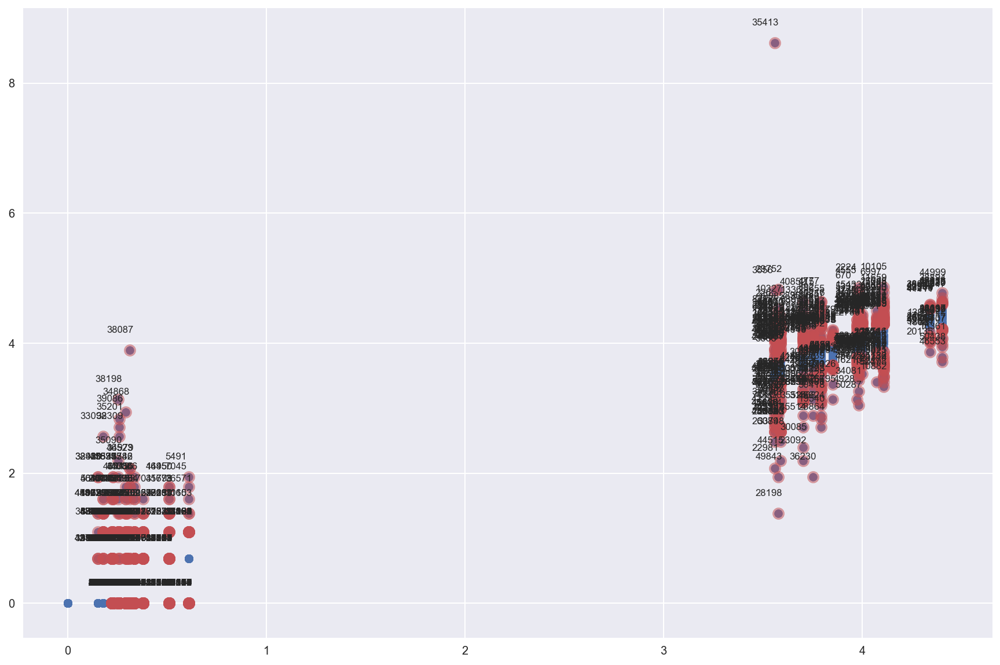

In [198]:
item_nbr_list_37 = get_item_nbr(df_37) #37번 store에서 팔린 item_nbr만 list로 저장

influence37 = result_model37.get_influence()

cooks_d2_37, pvals37 = influence37.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr37 = 4 / (len(df_37) - 778)
idx37 = np.where(cooks_d2_37 > fox_cr37)[0]

print(len(idx37)) #outlier 갯수

X37 = result_model37.predict(df_37)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X37, df_37['log_units'])
plt.scatter(X37[idx37], df_37.loc[idx37]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx37)), idx37, list(zip(X37[idx37], df_37.loc[idx37]['log_units'])),
                    [(-20, 15)] * len(idx37), size = "small", ax = ax)

plt.show()

In [199]:
for num in idx37 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_37 :
        if item_nbr == df_37.loc[num].item_nbr :
            mean = df_37[df_37['item_nbr'] == item_nbr]['log_units'].mean()
            df_37.set_value(num, 'log_units', mean)
            df_37.set_value(num, 'units', np.exp(mean) - 1)

model37_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_37)
result_model37_new = model37_new.fit()
print(result_model37_new.summary())

test_37_new = processed_test[processed_test['store_nbr'] == 37]

test_37_new['log_units'] = result_model37_new.predict(test_37_new)
test_37_new['units'] = np.exp(test_37_new['log_units']) - 1
result_test2.append(test_37_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 4.581e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:07:29   Log-Likelihood:             1.2734e+05
No. Observations:               50505   AIC:                        -2.531e+05
Df Residuals:                   49728   BIC:                        -2.463e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [200]:
del X37, cooks_d2_37, cv37_1, cv37_2, cv37_3, cv37_4, cv37_5, cv37_test, cv37_train, df_37, fox_cr37, idx37, influence37, item_nbr_list_37, model37
del model37_new, model_cv37, pvals37, result_model37, result_model37_new, result_model_cv37, test_37, test_37_new

In [201]:
df_38 = processed_train[processed_train['store_nbr'] == 38].reset_index(drop = True)

model38 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_38)
result_model38 = model38.fit()
print(result_model38.summary())

test_38 = processed_test[processed_test['store_nbr'] == 38]

test_38['log_units'] = result_model38.predict(test_38)
test_38['units'] = np.exp(test_38['log_units']) - 1
result_test.append(test_38)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.961
Model:                            OLS   Adj. R-squared:                  0.961
Method:                 Least Squares   F-statistic:                     1600.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:07:44   Log-Likelihood:                 36342.
No. Observations:               50505   AIC:                        -7.113e+04
Df Residuals:                   49728   BIC:                        -6.427e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [202]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv38_1 = df_38[:10101]
cv38_2 = df_38[10101:20202]
cv38_3 = df_38[20202:30414]
cv38_4 = df_38[30414:40515]
cv38_5 = df_38[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv38_train = pd.concat([cv38_1, cv38_2, cv38_3, cv38_4], ignore_index = True)
cv38_test = cv38_5

model_cv38 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv38_train)
result_model_cv38 = model_cv38.fit()
print(result_model_cv38.summary())

cv38_test['log_units_cv'] = result_model_cv38.predict(cv38_test)
cv38_test['units_cv'] = np.exp(cv38_test['log_units_cv']) - 1

cv38_test['RMSLE'] = np.log((cv38_test['units_cv'] + 1) / (cv38_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv38_test['RMSLE']) / len(cv38_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.963
Model:                            OLS   Adj. R-squared:                  0.962
Method:                 Least Squares   F-statistic:                     1341.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:07:56   Log-Likelihood:                 29998.
No. Observations:               40515   AIC:                        -5.844e+04
Df Residuals:                   39738   BIC:                        -5.175e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.13023507558


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1297


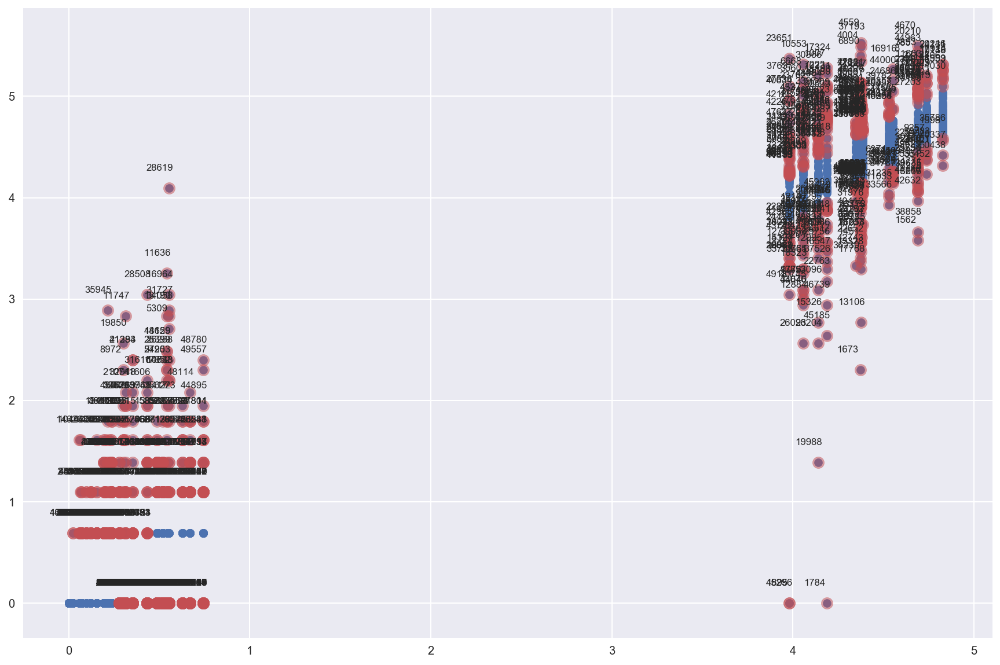

In [203]:
item_nbr_list_38 = get_item_nbr(df_38) #38번 store에서 팔린 item_nbr만 list로 저장

influence38 = result_model38.get_influence()

cooks_d2_38, pvals38 = influence38.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr38 = 4 / (len(df_38) - 778)
idx38 = np.where(cooks_d2_38 > fox_cr38)[0]

print(len(idx38)) #outlier 갯수

X38 = result_model38.predict(df_38)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X38, df_38['log_units'])
plt.scatter(X38[idx38], df_38.loc[idx38]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx38)), idx38, list(zip(X38[idx38], df_38.loc[idx38]['log_units'])),
                    [(-20, 15)] * len(idx38), size = "small", ax = ax)

plt.show()

In [204]:
for num in idx38 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_38 :
        if item_nbr == df_38.loc[num].item_nbr :
            mean = df_38[df_38['item_nbr'] == item_nbr]['log_units'].mean()
            df_38.set_value(num, 'log_units', mean)
            df_38.set_value(num, 'units', np.exp(mean) - 1)

model38_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_38)
result_model38_new = model38_new.fit()
print(result_model38_new.summary())

test_38_new = processed_test[processed_test['store_nbr'] == 38]

test_38_new['log_units'] = result_model38_new.predict(test_38_new)
test_38_new['units'] = np.exp(test_38_new['log_units']) - 1
result_test2.append(test_38_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 5.595e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:08:17   Log-Likelihood:             1.2609e+05
No. Observations:               50505   AIC:                        -2.506e+05
Df Residuals:                   49728   BIC:                        -2.438e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [205]:
del X38, cooks_d2_38, cv38_1, cv38_2, cv38_3, cv38_4, cv38_5, cv38_test, cv38_train, df_38, fox_cr38, idx38, influence38, item_nbr_list_38, model38
del model38_new, model_cv38, pvals38, result_model38, result_model38_new, result_model_cv38, test_38, test_38_new

In [206]:
df_39 = processed_train[processed_train['store_nbr'] == 39].reset_index(drop = True)

model39 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_39)
result_model39 = model39.fit()
print(result_model39.summary())

test_39 = processed_test[processed_test['store_nbr'] == 39]

test_39['log_units'] = result_model39.predict(test_39)
test_39['units'] = np.exp(test_39['log_units']) - 1
result_test.append(test_39)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.872
Model:                            OLS   Adj. R-squared:                  0.870
Method:                 Least Squares   F-statistic:                     435.3
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:08:32   Log-Likelihood:                 43795.
No. Observations:               50505   AIC:                        -8.604e+04
Df Residuals:                   49728   BIC:                        -7.918e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [207]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv39_1 = df_39[:10101]
cv39_2 = df_39[10101:20202]
cv39_3 = df_39[20202:30414]
cv39_4 = df_39[30414:40515]
cv39_5 = df_39[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv39_train = pd.concat([cv39_1, cv39_2, cv39_3, cv39_4], ignore_index = True)
cv39_test = cv39_5

model_cv39 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv39_train)
result_model_cv39 = model_cv39.fit()
print(result_model_cv39.summary())

cv39_test['log_units_cv'] = result_model_cv39.predict(cv39_test)
cv39_test['units_cv'] = np.exp(cv39_test['log_units_cv']) - 1

cv39_test['RMSLE'] = np.log((cv39_test['units_cv'] + 1) / (cv39_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv39_test['RMSLE']) / len(cv39_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.882
Model:                            OLS   Adj. R-squared:                  0.879
Method:                 Least Squares   F-statistic:                     381.9
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:08:43   Log-Likelihood:                 36077.
No. Observations:               40515   AIC:                        -7.060e+04
Df Residuals:                   39738   BIC:                        -6.391e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.113087698755


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


700


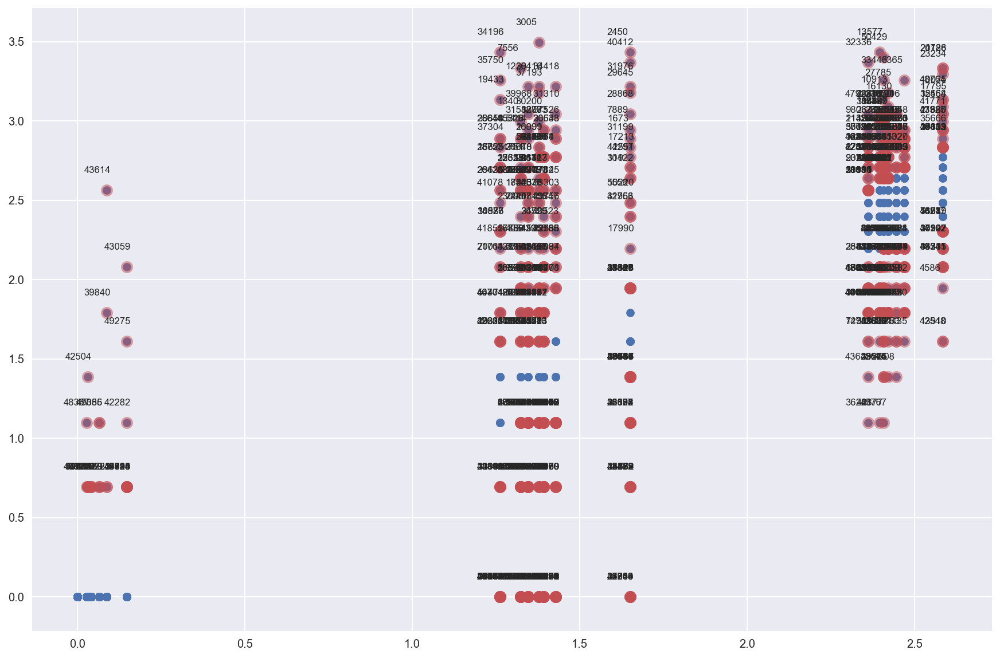

In [208]:
item_nbr_list_39 = get_item_nbr(df_39) #39번 store에서 팔린 item_nbr만 list로 저장

influence39 = result_model39.get_influence()

cooks_d2_39, pvals39 = influence39.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr39 = 4 / (len(df_39) - 778)
idx39 = np.where(cooks_d2_39 > fox_cr39)[0]

print(len(idx39)) #outlier 갯수

X39 = result_model39.predict(df_39)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X39, df_39['log_units'])
plt.scatter(X39[idx39], df_39.loc[idx39]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx39)), idx39, list(zip(X39[idx39], df_39.loc[idx39]['log_units'])),
                    [(-20, 15)] * len(idx39), size = "small", ax = ax)

plt.show()

In [209]:
for num in idx39 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_39 :
        if item_nbr == df_39.loc[num].item_nbr :
            mean = df_39[df_39['item_nbr'] == item_nbr]['log_units'].mean()
            df_39.set_value(num, 'log_units', mean)
            df_39.set_value(num, 'units', np.exp(mean) - 1)

model39_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_39)
result_model39_new = model39_new.fit()
print(result_model39_new.summary())

test_39_new = processed_test[processed_test['store_nbr'] == 39]

test_39_new['log_units'] = result_model39_new.predict(test_39_new)
test_39_new['units'] = np.exp(test_39_new['log_units']) - 1
result_test2.append(test_39_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 4.931e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:09:02   Log-Likelihood:             1.6335e+05
No. Observations:               50505   AIC:                        -3.251e+05
Df Residuals:                   49728   BIC:                        -3.183e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [210]:
del X39, cooks_d2_39, cv39_1, cv39_2, cv39_3, cv39_4, cv39_5, cv39_test, cv39_train, df_39, fox_cr39, idx39, influence39, item_nbr_list_39, model39
del model39_new, model_cv39, pvals39, result_model39, result_model39_new, result_model_cv39, test_39, test_39_new

In [211]:
df_40 = processed_train[processed_train['store_nbr'] == 40].reset_index(drop = True)

model40 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_40)
result_model40 = model40.fit()
print(result_model40.summary())

test_40 = processed_test[processed_test['store_nbr'] == 40]

test_40['log_units'] = result_model40.predict(test_40)
test_40['units'] = np.exp(test_40['log_units']) - 1
result_test.append(test_40)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.947
Model:                            OLS   Adj. R-squared:                  0.946
Method:                 Least Squares   F-statistic:                     1136.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:09:17   Log-Likelihood:                 31939.
No. Observations:               50505   AIC:                        -6.232e+04
Df Residuals:                   49728   BIC:                        -5.546e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [212]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv40_1 = df_40[:10101]
cv40_2 = df_40[10101:20202]
cv40_3 = df_40[20202:30414]
cv40_4 = df_40[30414:40515]
cv40_5 = df_40[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv40_train = pd.concat([cv40_1, cv40_2, cv40_3, cv40_4], ignore_index = True)
cv40_test = cv40_5

model_cv40 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv40_train)
result_model_cv40 = model_cv40.fit()
print(result_model_cv40.summary())

cv40_test['log_units_cv'] = result_model_cv40.predict(cv40_test)
cv40_test['units_cv'] = np.exp(cv40_test['log_units_cv']) - 1

cv40_test['RMSLE'] = np.log((cv40_test['units_cv'] + 1) / (cv40_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv40_test['RMSLE']) / len(cv40_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.946
Model:                            OLS   Adj. R-squared:                  0.945
Method:                 Least Squares   F-statistic:                     897.2
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:09:29   Log-Likelihood:                 25234.
No. Observations:               40515   AIC:                        -4.891e+04
Df Residuals:                   39738   BIC:                        -4.222e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.126996438491


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1479


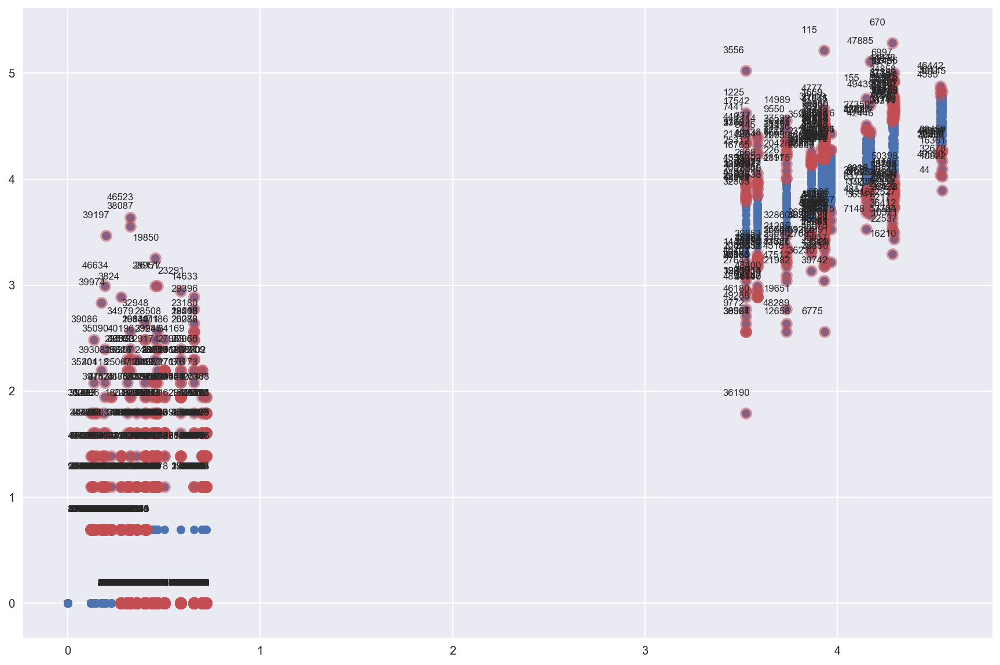

In [213]:
item_nbr_list_40 = get_item_nbr(df_40) #40번 store에서 팔린 item_nbr만 list로 저장

influence40 = result_model40.get_influence()

cooks_d2_40, pvals40 = influence40.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr40 = 4 / (len(df_40) - 778)
idx40 = np.where(cooks_d2_40 > fox_cr40)[0]

print(len(idx40)) #outlier 갯수

X40 = result_model40.predict(df_40)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X40, df_40['log_units'])
plt.scatter(X40[idx40], df_40.loc[idx40]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx40)), idx40, list(zip(X40[idx40], df_40.loc[idx40]['log_units'])),
                    [(-20, 15)] * len(idx40), size = "small", ax = ax)

plt.show()

In [214]:
for num in idx40 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_40 :
        if item_nbr == df_40.loc[num].item_nbr :
            mean = df_40[df_40['item_nbr'] == item_nbr]['log_units'].mean()
            df_40.set_value(num, 'log_units', mean)
            df_40.set_value(num, 'units', np.exp(mean) - 1)

model40_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_40)
result_model40_new = model40_new.fit()
print(result_model40_new.summary())

test_40_new = processed_test[processed_test['store_nbr'] == 40]

test_40_new['log_units'] = result_model40_new.predict(test_40_new)
test_40_new['units'] = np.exp(test_40_new['log_units']) - 1
result_test2.append(test_40_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 3.081e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:09:51   Log-Likelihood:             1.1531e+05
No. Observations:               50505   AIC:                        -2.291e+05
Df Residuals:                   49728   BIC:                        -2.222e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [215]:
del X40, cooks_d2_40, cv40_1, cv40_2, cv40_3, cv40_4, cv40_5, cv40_test, cv40_train, df_40, fox_cr40, idx40, influence40, item_nbr_list_40, model40
del model40_new, model_cv40, pvals40, result_model40, result_model40_new, result_model_cv40, test_40, test_40_new

In [216]:
df_41 = processed_train[processed_train['store_nbr'] == 41].reset_index(drop = True)

model41 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_41)
result_model41 = model41.fit()
print(result_model41.summary())

test_41 = processed_test[processed_test['store_nbr'] == 41]

test_41['log_units'] = result_model41.predict(test_41)
test_41['units'] = np.exp(test_41['log_units']) - 1
result_test.append(test_41)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.940
Model:                            OLS   Adj. R-squared:                  0.939
Method:                 Least Squares   F-statistic:                     1006.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:10:06   Log-Likelihood:                 33224.
No. Observations:               50505   AIC:                        -6.489e+04
Df Residuals:                   49728   BIC:                        -5.803e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [217]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv41_1 = df_41[:10101]
cv41_2 = df_41[10101:20202]
cv41_3 = df_41[20202:30414]
cv41_4 = df_41[30414:40515]
cv41_5 = df_41[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv41_train = pd.concat([cv41_1, cv41_2, cv41_3, cv41_4], ignore_index = True)
cv41_test = cv41_5

model_cv41 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv41_train)
result_model_cv41 = model_cv41.fit()
print(result_model_cv41.summary())

cv41_test['log_units_cv'] = result_model_cv41.predict(cv41_test)
cv41_test['units_cv'] = np.exp(cv41_test['log_units_cv']) - 1

cv41_test['RMSLE'] = np.log((cv41_test['units_cv'] + 1) / (cv41_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv41_test['RMSLE']) / len(cv41_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.940
Model:                            OLS   Adj. R-squared:                  0.939
Method:                 Least Squares   F-statistic:                     806.9
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:10:17   Log-Likelihood:                 26495.
No. Observations:               40515   AIC:                        -5.144e+04
Df Residuals:                   39738   BIC:                        -4.475e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.127999714154


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1381


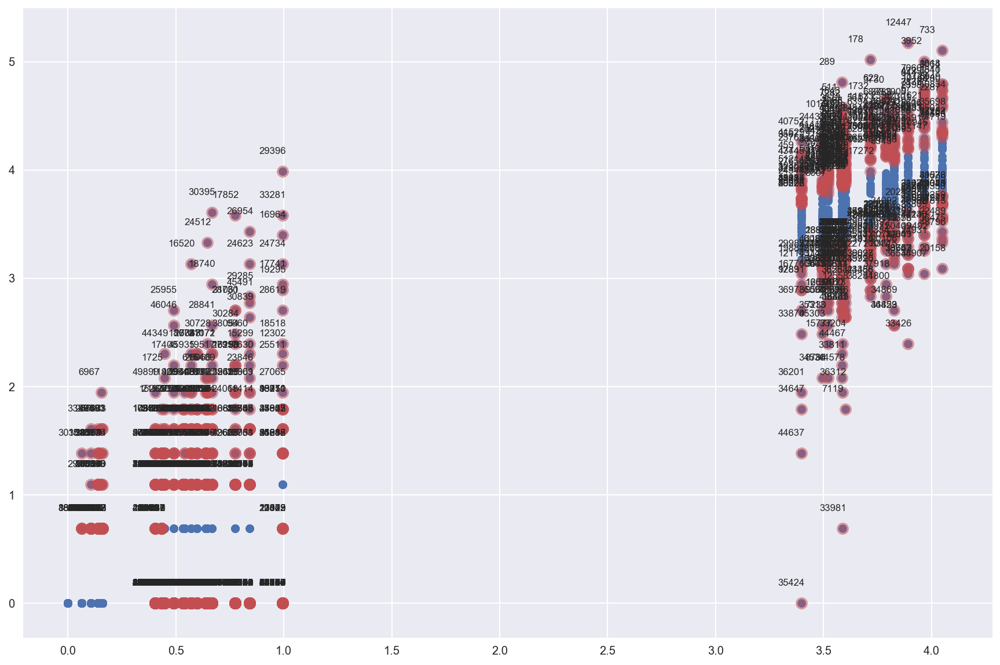

In [218]:
item_nbr_list_41 = get_item_nbr(df_41) #41번 store에서 팔린 item_nbr만 list로 저장

influence41 = result_model41.get_influence()

cooks_d2_41, pvals41 = influence41.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr41 = 4 / (len(df_41) - 778)
idx41 = np.where(cooks_d2_41 > fox_cr41)[0]

print(len(idx41)) #outlier 갯수

X41 = result_model41.predict(df_41)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X41, df_41['log_units'])
plt.scatter(X41[idx41], df_41.loc[idx41]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx41)), idx41, list(zip(X41[idx41], df_41.loc[idx41]['log_units'])),
                    [(-20, 15)] * len(idx41), size = "small", ax = ax)

plt.show()

In [219]:
for num in idx41 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_41 :
        if item_nbr == df_41.loc[num].item_nbr :
            mean = df_41[df_41['item_nbr'] == item_nbr]['log_units'].mean()
            df_41.set_value(num, 'log_units', mean)
            df_41.set_value(num, 'units', np.exp(mean) - 1)

model41_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_41)
result_model41_new = model41_new.fit()
print(result_model41_new.summary())

test_41_new = processed_test[processed_test['store_nbr'] == 41]

test_41_new['log_units'] = result_model41_new.predict(test_41_new)
test_41_new['units'] = np.exp(test_41_new['log_units']) - 1
result_test2.append(test_41_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 3.761e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:10:38   Log-Likelihood:             1.2501e+05
No. Observations:               50505   AIC:                        -2.485e+05
Df Residuals:                   49728   BIC:                        -2.416e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [220]:
del X41, cooks_d2_41, cv41_1, cv41_2, cv41_3, cv41_4, cv41_5, cv41_test, cv41_train, df_41, fox_cr41, idx41, influence41, item_nbr_list_41, model41
del model41_new, model_cv41, pvals41, result_model41, result_model41_new, result_model_cv41, test_41, test_41_new

In [221]:
df_42 = processed_train[processed_train['store_nbr'] == 42].reset_index(drop = True)

model42 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_42)
result_model42 = model42.fit()
print(result_model42.summary())

test_42 = processed_test[processed_test['store_nbr'] == 42]

test_42['log_units'] = result_model42.predict(test_42)
test_42['units'] = np.exp(test_42['log_units']) - 1
result_test.append(test_42)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.979
Model:                            OLS   Adj. R-squared:                  0.979
Method:                 Least Squares   F-statistic:                     2990.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:10:54   Log-Likelihood:                 57252.
No. Observations:               50505   AIC:                        -1.129e+05
Df Residuals:                   49728   BIC:                        -1.061e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [222]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv42_1 = df_42[:10101]
cv42_2 = df_42[10101:20202]
cv42_3 = df_42[20202:30414]
cv42_4 = df_42[30414:40515]
cv42_5 = df_42[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv42_train = pd.concat([cv42_1, cv42_2, cv42_3, cv42_4], ignore_index = True)
cv42_test = cv42_5

model_cv42 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv42_train)
result_model_cv42 = model_cv42.fit()
print(result_model_cv42.summary())

cv42_test['log_units_cv'] = result_model_cv42.predict(cv42_test)
cv42_test['units_cv'] = np.exp(cv42_test['log_units_cv']) - 1

cv42_test['RMSLE'] = np.log((cv42_test['units_cv'] + 1) / (cv42_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv42_test['RMSLE']) / len(cv42_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.979
Model:                            OLS   Adj. R-squared:                  0.979
Method:                 Least Squares   F-statistic:                     2405.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:11:05   Log-Likelihood:                 45753.
No. Observations:               40515   AIC:                        -8.995e+04
Df Residuals:                   39738   BIC:                        -8.326e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.0784644300069


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


985


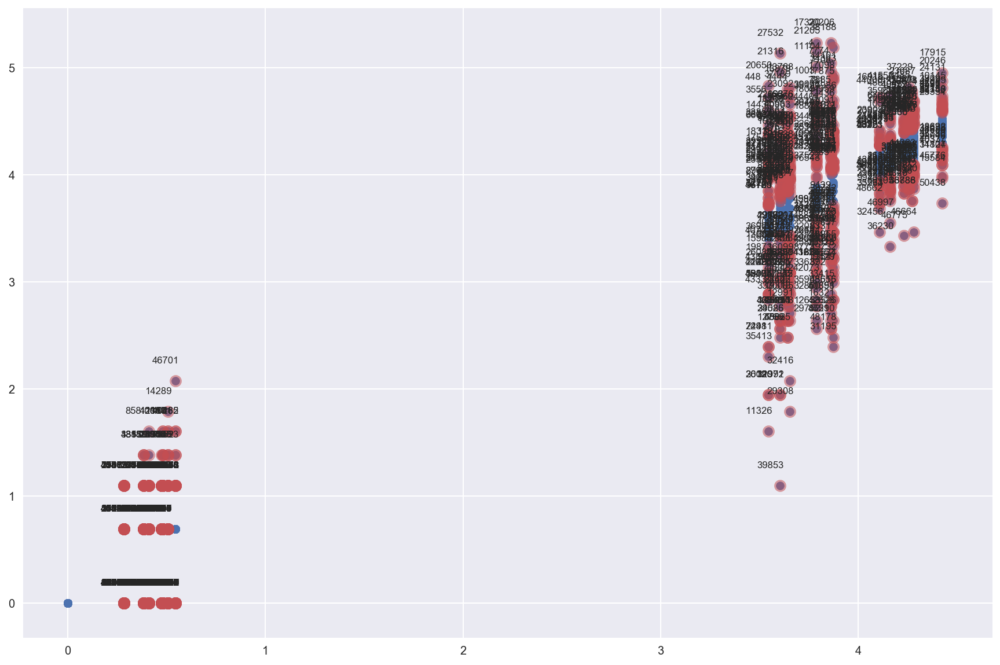

In [223]:
item_nbr_list_42 = get_item_nbr(df_42) #42번 store에서 팔린 item_nbr만 list로 저장

influence42 = result_model42.get_influence()

cooks_d2_42, pvals42 = influence42.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr42 = 4 / (len(df_42) - 778)
idx42 = np.where(cooks_d2_42 > fox_cr42)[0]

print(len(idx42)) #outlier 갯수

X42 = result_model42.predict(df_42)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X42, df_42['log_units'])
plt.scatter(X42[idx42], df_42.loc[idx42]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx42)), idx42, list(zip(X42[idx42], df_42.loc[idx42]['log_units'])),
                    [(-20, 15)] * len(idx42), size = "small", ax = ax)

plt.show()

In [224]:
for num in idx42 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_42 :
        if item_nbr == df_42.loc[num].item_nbr :
            mean = df_42[df_42['item_nbr'] == item_nbr]['log_units'].mean()
            df_42.set_value(num, 'log_units', mean)
            df_42.set_value(num, 'units', np.exp(mean) - 1)

model42_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_42)
result_model42_new = model42_new.fit()
print(result_model42_new.summary())

test_42_new = processed_test[processed_test['store_nbr'] == 42]

test_42_new['log_units'] = result_model42_new.predict(test_42_new)
test_42_new['units'] = np.exp(test_42_new['log_units']) - 1
result_test2.append(test_42_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       1.000
Model:                            OLS   Adj. R-squared:                  1.000
Method:                 Least Squares   F-statistic:                 1.606e+05
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:11:26   Log-Likelihood:             1.5817e+05
No. Observations:               50505   AIC:                        -3.148e+05
Df Residuals:                   49728   BIC:                        -3.079e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [225]:
del X42, cooks_d2_42, cv42_1, cv42_2, cv42_3, cv42_4, cv42_5, cv42_test, cv42_train, df_42, fox_cr42, idx42, influence42, item_nbr_list_42, model42
del model42_new, model_cv42, pvals42, result_model42, result_model42_new, result_model_cv42, test_42, test_42_new

In [226]:
df_43 = processed_train[processed_train['store_nbr'] == 43].reset_index(drop = True)

model43 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_43)
result_model43 = model43.fit()
print(result_model43.summary())

test_43 = processed_test[processed_test['store_nbr'] == 43]

test_43['log_units'] = result_model43.predict(test_43)
test_43['units'] = np.exp(test_43['log_units']) - 1
result_test.append(test_43)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.939
Model:                            OLS   Adj. R-squared:                  0.938
Method:                 Least Squares   F-statistic:                     979.6
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:11:41   Log-Likelihood:                 38107.
No. Observations:               50505   AIC:                        -7.466e+04
Df Residuals:                   49728   BIC:                        -6.780e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [227]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv43_1 = df_43[:10101]
cv43_2 = df_43[10101:20202]
cv43_3 = df_43[20202:30414]
cv43_4 = df_43[30414:40515]
cv43_5 = df_43[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv43_train = pd.concat([cv43_1, cv43_2, cv43_3, cv43_4], ignore_index = True)
cv43_test = cv43_5

model_cv43 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv43_train)
result_model_cv43 = model_cv43.fit()
print(result_model_cv43.summary())

cv43_test['log_units_cv'] = result_model_cv43.predict(cv43_test)
cv43_test['units_cv'] = np.exp(cv43_test['log_units_cv']) - 1

cv43_test['RMSLE'] = np.log((cv43_test['units_cv'] + 1) / (cv43_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv43_test['RMSLE']) / len(cv43_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.939
Model:                            OLS   Adj. R-squared:                  0.938
Method:                 Least Squares   F-statistic:                     788.3
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:11:53   Log-Likelihood:                 30238.
No. Observations:               40515   AIC:                        -5.892e+04
Df Residuals:                   39738   BIC:                        -5.223e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.112144927653


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1658


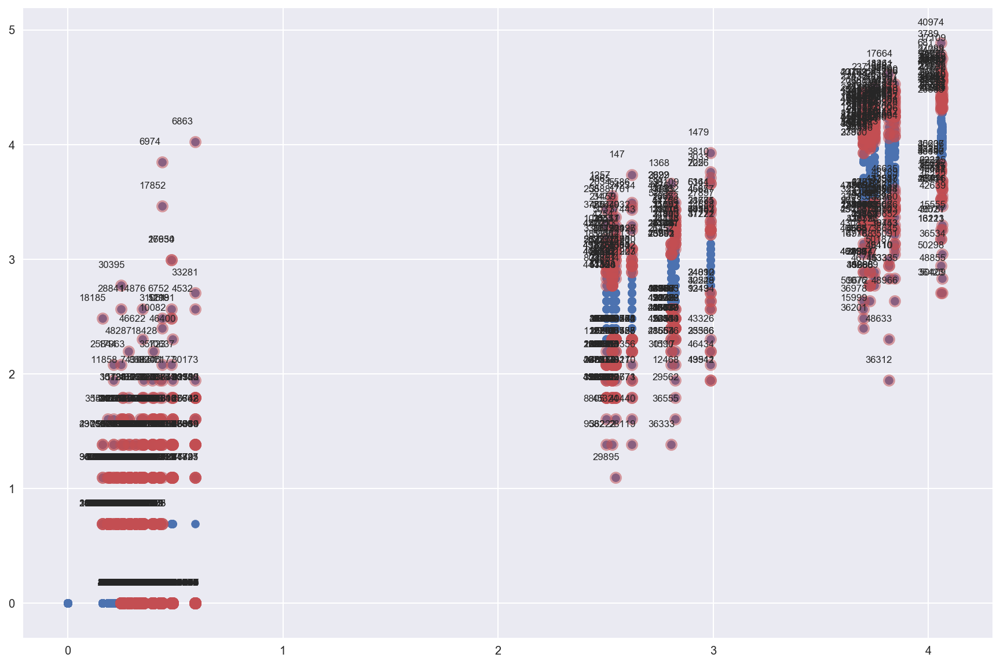

In [228]:
item_nbr_list_43 = get_item_nbr(df_43) #43번 store에서 팔린 item_nbr만 list로 저장

influence43 = result_model43.get_influence()

cooks_d2_43, pvals43 = influence43.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr43 = 4 / (len(df_43) - 778)
idx43 = np.where(cooks_d2_43 > fox_cr43)[0]

print(len(idx43)) #outlier 갯수

X43 = result_model43.predict(df_43)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X43, df_43['log_units'])
plt.scatter(X43[idx43], df_43.loc[idx43]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx43)), idx43, list(zip(X43[idx43], df_43.loc[idx43]['log_units'])),
                    [(-20, 15)] * len(idx43), size = "small", ax = ax)

plt.show()

In [229]:
for num in idx43 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_43 :
        if item_nbr == df_43.loc[num].item_nbr :
            mean = df_43[df_43['item_nbr'] == item_nbr]['log_units'].mean()
            df_43.set_value(num, 'log_units', mean)
            df_43.set_value(num, 'units', np.exp(mean) - 1)

model43_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_43)
result_model43_new = model43_new.fit()
print(result_model43_new.summary())

test_43_new = processed_test[processed_test['store_nbr'] == 43]

test_43_new['log_units'] = result_model43_new.predict(test_43_new)
test_43_new['units'] = np.exp(test_43_new['log_units']) - 1
result_test2.append(test_43_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 3.559e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:12:15   Log-Likelihood:             1.2928e+05
No. Observations:               50505   AIC:                        -2.570e+05
Df Residuals:                   49728   BIC:                        -2.501e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [230]:
del X43, cooks_d2_43, cv43_1, cv43_2, cv43_3, cv43_4, cv43_5, cv43_test, cv43_train, df_43, fox_cr43, idx43, influence43, item_nbr_list_43, model43
del model43_new, model_cv43, pvals43, result_model43, result_model43_new, result_model_cv43, test_43, test_43_new

In [231]:
df_44 = processed_train[processed_train['store_nbr'] == 44].reset_index(drop = True)

model44 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_44)
result_model44 = model44.fit()
print(result_model44.summary())

test_44 = processed_test[processed_test['store_nbr'] == 44]

test_44['log_units'] = result_model44.predict(test_44)
test_44['units'] = np.exp(test_44['log_units']) - 1
result_test.append(test_44)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.943
Model:                            OLS   Adj. R-squared:                  0.942
Method:                 Least Squares   F-statistic:                     1055.
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:12:30   Log-Likelihood:                 33270.
No. Observations:               50505   AIC:                        -6.499e+04
Df Residuals:                   49728   BIC:                        -5.812e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [232]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv44_1 = df_44[:10101]
cv44_2 = df_44[10101:20202]
cv44_3 = df_44[20202:30414]
cv44_4 = df_44[30414:40515]
cv44_5 = df_44[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv44_train = pd.concat([cv44_1, cv44_2, cv44_3, cv44_4], ignore_index = True)
cv44_test = cv44_5

model_cv44 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv44_train)
result_model_cv44 = model_cv44.fit()
print(result_model_cv44.summary())

cv44_test['log_units_cv'] = result_model_cv44.predict(cv44_test)
cv44_test['units_cv'] = np.exp(cv44_test['log_units_cv']) - 1

cv44_test['RMSLE'] = np.log((cv44_test['units_cv'] + 1) / (cv44_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv44_test['RMSLE']) / len(cv44_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.943
Model:                            OLS   Adj. R-squared:                  0.942
Method:                 Least Squares   F-statistic:                     847.6
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:12:41   Log-Likelihood:                 26523.
No. Observations:               40515   AIC:                        -5.149e+04
Df Residuals:                   39738   BIC:                        -4.480e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.125740516295


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


1642


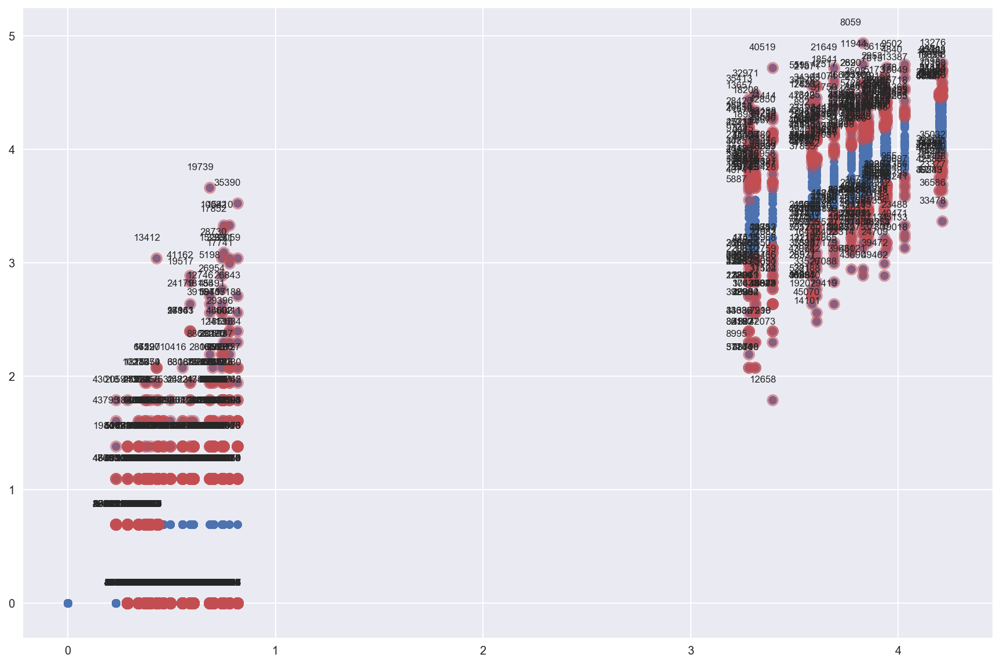

In [233]:
item_nbr_list_44 = get_item_nbr(df_44) #44번 store에서 팔린 item_nbr만 list로 저장

influence44 = result_model44.get_influence()

cooks_d2_44, pvals44 = influence44.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr44 = 4 / (len(df_44) - 778)
idx44 = np.where(cooks_d2_44 > fox_cr44)[0]

print(len(idx44)) #outlier 갯수

X44 = result_model44.predict(df_44)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X44, df_44['log_units'])
plt.scatter(X44[idx44], df_44.loc[idx44]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx44)), idx44, list(zip(X44[idx44], df_44.loc[idx44]['log_units'])),
                    [(-20, 15)] * len(idx44), size = "small", ax = ax)

plt.show()

In [234]:
for num in idx44 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_44 :
        if item_nbr == df_44.loc[num].item_nbr :
            mean = df_44[df_44['item_nbr'] == item_nbr]['log_units'].mean()
            df_44.set_value(num, 'log_units', mean)
            df_44.set_value(num, 'units', np.exp(mean) - 1)

model44_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_44)
result_model44_new = model44_new.fit()
print(result_model44_new.summary())

test_44_new = processed_test[processed_test['store_nbr'] == 44]

test_44_new['log_units'] = result_model44_new.predict(test_44_new)
test_44_new['units'] = np.exp(test_44_new['log_units']) - 1
result_test2.append(test_44_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.999
Model:                            OLS   Adj. R-squared:                  0.999
Method:                 Least Squares   F-statistic:                 4.849e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:13:03   Log-Likelihood:             1.2996e+05
No. Observations:               50505   AIC:                        -2.584e+05
Df Residuals:                   49728   BIC:                        -2.515e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [235]:
del X44, cooks_d2_44, cv44_1, cv44_2, cv44_3, cv44_4, cv44_5, cv44_test, cv44_train, df_44, fox_cr44, idx44, influence44, item_nbr_list_44, model44
del model44_new, model_cv44, pvals44, result_model44, result_model44_new, result_model_cv44, test_44, test_44_new

In [236]:
df_45 = processed_train[processed_train['store_nbr'] == 45].reset_index(drop = True)

model45 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_45)
result_model45 = model45.fit()
print(result_model45.summary())

test_45 = processed_test[processed_test['store_nbr'] == 45]

test_45['log_units'] = result_model45.predict(test_45)
test_45['units'] = np.exp(test_45['log_units']) - 1
result_test.append(test_45)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.846
Model:                            OLS   Adj. R-squared:                  0.844
Method:                 Least Squares   F-statistic:                     352.4
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:13:18   Log-Likelihood:                 35137.
No. Observations:               50505   AIC:                        -6.872e+04
Df Residuals:                   49728   BIC:                        -6.186e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


In [237]:
# Cross Validation
# train set이 총 5분기 이므로 1분기씩 나눠준다..
cv45_1 = df_45[:10101]
cv45_2 = df_45[10101:20202]
cv45_3 = df_45[20202:30414]
cv45_4 = df_45[30414:40515]
cv45_5 = df_45[40515:]

# 기존 train set을 cv_train과 cv_test로 나눌 수 있음
cv45_train = pd.concat([cv45_1, cv45_2, cv45_3, cv45_4], ignore_index = True)
cv45_test = cv45_5

model_cv45 = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = cv45_train)
result_model_cv45 = model_cv45.fit()
print(result_model_cv45.summary())

cv45_test['log_units_cv'] = result_model_cv45.predict(cv45_test)
cv45_test['units_cv'] = np.exp(cv45_test['log_units_cv']) - 1

cv45_test['RMSLE'] = np.log((cv45_test['units_cv'] + 1) / (cv45_test['units'] + 1)) ** 2
RMSLE = np.sqrt(np.sum(cv45_test['RMSLE']) / len(cv45_test))
print(RMSLE)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.845
Model:                            OLS   Adj. R-squared:                  0.842
Method:                 Least Squares   F-statistic:                     278.9
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:13:30   Log-Likelihood:                 28566.
No. Observations:               40515   AIC:                        -5.558e+04
Df Residuals:                   39738   BIC:                        -4.889e+04
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

0.126612925336


C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


856


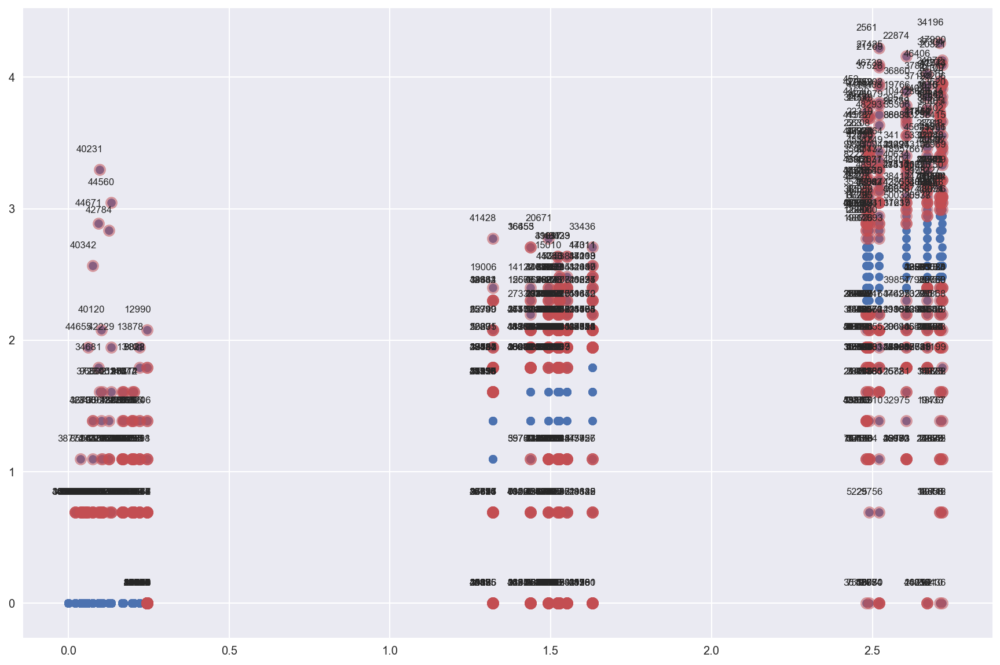

In [238]:
item_nbr_list_45 = get_item_nbr(df_45) #45번 store에서 팔린 item_nbr만 list로 저장

influence45 = result_model45.get_influence()

cooks_d2_45, pvals45 = influence45.cooks_distance # fox outlier recommendation으로 outlier 판별
fox_cr45 = 4 / (len(df_45) - 778)
idx45 = np.where(cooks_d2_45 > fox_cr45)[0]

print(len(idx45)) #outlier 갯수

X45 = result_model45.predict(df_45)

fig, ax = plt.subplots(figsize=(15, 10))
plt.scatter(X45, df_45['log_units'])
plt.scatter(X45[idx45], df_45.loc[idx45]['log_units'], s = 100, c = "r", alpha = 0.5)
utils.annotate_axes(range(len(idx45)), idx45, list(zip(X45[idx45], df_45.loc[idx45]['log_units'])),
                    [(-20, 15)] * len(idx45), size = "small", ax = ax)

plt.show()

In [239]:
for num in idx45 : # outlier들을 각 item_nbr별 평균치로 대체
    for item_nbr in item_nbr_list_45 :
        if item_nbr == df_45.loc[num].item_nbr :
            mean = df_45[df_45['item_nbr'] == item_nbr]['log_units'].mean()
            df_45.set_value(num, 'log_units', mean)
            df_45.set_value(num, 'units', np.exp(mean) - 1)

model45_new = sm.OLS.from_formula('log_units ~ C(item_nbr):C(weekday, contrast_weekday) + 0', data = df_45)
result_model45_new = model45_new.fit()
print(result_model45_new.summary())

test_45_new = processed_test[processed_test['store_nbr'] == 45]

test_45_new['log_units'] = result_model45_new.predict(test_45_new)
test_45_new['units'] = np.exp(test_45_new['log_units']) - 1
result_test2.append(test_45_new)

                            OLS Regression Results                            
Dep. Variable:              log_units   R-squared:                       0.998
Model:                            OLS   Adj. R-squared:                  0.998
Method:                 Least Squares   F-statistic:                 3.211e+04
Date:                Thu, 15 Mar 2018   Prob (F-statistic):               0.00
Time:                        19:13:50   Log-Likelihood:             1.4856e+05
No. Observations:               50505   AIC:                        -2.956e+05
Df Residuals:                   49728   BIC:                        -2.887e+05
Df Model:                         776                                         
Covariance Type:            nonrobust                                         
                                                             coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


In [240]:
del X45, cooks_d2_45, cv45_1, cv45_2, cv45_3, cv45_4, cv45_5, cv45_test, cv45_train, df_45, fox_cr45, idx45, influence45, item_nbr_list_45, model45
del model45_new, model_cv45, pvals45, result_model45, result_model45_new, result_model_cv45, test_45, test_45_new

## Make Submission

In [241]:
sub = pd.concat(result_test)

In [242]:
len(sub), len(test)

(526917, 526917)

In [243]:
sub.drop(['weekday', 'holiday', 'event'], axis = 1, inplace = True)

In [244]:
sub.sort_values(by = ['date', 'store_nbr', 'item_nbr'], inplace = True)
sub.reset_index(drop = True, inplace = True)

In [245]:
units = sub['units']

In [246]:
sub['store_nbr'] = sub['store_nbr'].astype('str')
sub['item_nbr'] = sub['item_nbr'].astype('str')
sub['date'] = sub['date'].astype('str')

In [247]:
sub['id'] = sub['store_nbr'] + '_' + sub['item_nbr'] + '_' + sub['date']

In [248]:
sub.drop(['date', 'store_nbr', 'item_nbr', 'log_units', 'units'], axis = 1, inplace = True)

In [249]:
sub['units'] = units

In [250]:
sub.tail()

,id,units
526912,45_107_2014-10-26,0.0
526913,45_108_2014-10-26,0.0
526914,45_109_2014-10-26,0.0
526915,45_110_2014-10-26,0.0
526916,45_111_2014-10-26,0.0


In [251]:
sub.to_csv('sub.csv', index = False)

## Result

<img src = '../sub_test11.png'>

<img src = '../sub_test11_rank.png'>

## Outlier 대체 후

<img src = '../outlier.png'>

## Moving Average

In [252]:
key = pd.read_csv('../data/key.csv')
train = pd.read_csv('../data/train.csv')
test = pd.read_csv('../data/test.csv')

In [253]:
test['units'] = 'M'
test['log_units'] = 'M'
test['test'] = True

train['log_units'] = np.log(train['units'] + 1)
train['test'] = False

In [254]:
temp = pd.concat([train, test], axis = 0, ignore_index = True)
temp.sort_values(by = ['date', 'store_nbr', 'item_nbr'], inplace = True)
temp.reset_index(drop = True, inplace = True)

In [255]:
result_list = []
window = 21

for store_nbr in range(1, 46) :
    for item_nbr in range(1,112) :
        df = get_temp_s_i(temp, store_nbr, item_nbr)
        
        for num in range(len(df)) :
            if df.at[num, 'log_units'] == 'M' : # M일 경우 앞 3주 간의 평균치를 넣어줌
                tmp = 0.0
                for x in range(1, window + 1) :
                    tmp += float(df.at[num - x, 'log_units'])
                    result = tmp / window
                
                    df.set_value(num, 'log_units', result)
                    df.set_value(num, 'units', np.exp(result) - 1)
        
        result_list.append(df)
#오래걸림..

In [256]:
total = pd.concat(result_list)
sub_ma = total[total['test'] == True]

In [257]:
total_ = total[total['store_nbr'] == 1].reset_index(drop = True)
total_51 = total_[total_['item_nbr'] == 51].reset_index(drop = True)
total_51['MA'] = 0.0

for num in range(21, len(total_51)) :
    tmp = 0
    
    for x in range(1, 22) :
        tmp += total_51.at[num - x, 'log_units']
    
    ma = tmp / 21
    total_51.set_value(num, 'MA', round(ma, 2))

In [258]:
x = total_51['date']
y1 = total_51['log_units']
y2 = total_51['MA']

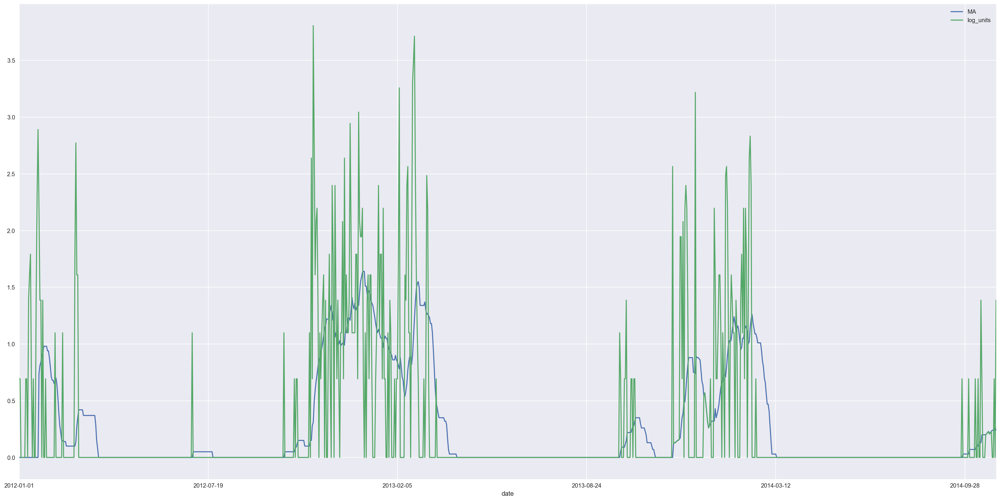

In [259]:
total_51.plot(['date'], ['MA', 'log_units'], figsize = (30, 15)) # 1번 store의 51번 item 실제 log_units와 MA로 계산된 log_units의 비교
plt.show()

In [260]:
sub_ma.sort_values(by = ['date', 'store_nbr', 'item_nbr'], inplace = True)
sub_ma.reset_index(drop = True, inplace = True)

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [261]:
sub_ma.tail()

,date,store_nbr,item_nbr,units,log_units,test
526912,2014-10-26,45,107,0,0,True
526913,2014-10-26,45,108,0,0,True
526914,2014-10-26,45,109,0,0,True
526915,2014-10-26,45,110,0,0,True
526916,2014-10-26,45,111,0,0,True


In [262]:
sub_ma['date'] = sub_ma['date'].astype('str')
sub_ma['store_nbr'] = sub_ma['store_nbr'].astype('str')
sub_ma['item_nbr'] = sub_ma['item_nbr'].astype('str')

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexi

In [263]:
ma_units = sub_ma['units']

In [264]:
sub_ma['id'] = sub_ma['store_nbr'] + '_' + sub_ma['item_nbr'] + '_' + sub_ma['date']
sub_ma.drop(['date', 'store_nbr', 'item_nbr', 'test', 'units', 'log_units'], axis = 1, inplace = True)

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [265]:
sub_ma['units'] = ma_units

C:\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [266]:
sub_ma.tail()

,id,units
526912,45_107_2014-10-26,0
526913,45_108_2014-10-26,0
526914,45_109_2014-10-26,0
526915,45_110_2014-10-26,0
526916,45_111_2014-10-26,0


In [267]:
sub_ma.to_csv('sub_ma.csv', index = False)

<img src = '../ma21.png'>

<img src = '../ma21_rank.png'>